Support(s): The number of transactions that include items in the {X} and {Y} parts of the rule as a percentage of the total number of transaction.It is a measure of how frequently the collection of items occur together as 
a percentage of all transactions.

Support = $\sigma(X+Y) \div total$ 
It is interpreted as fraction of transactions that contain both X and Y.

Confidence(c):
It is the ratio of the no of transactions that includes all items in {B} as well as the no of transactions that includes all items in {A} to the no of transactions that includes all items in {A}.

Conf(X=>Y) = $Supp(X\cup Y) \div Supp(X)$ 
It measures how often each item in Y appears in transactions that contains items in X also.

Lift(l):
The lift of the rule X=>Y is the confidence of the rule divided by the expected confidence, assuming that the itemsets X and Y are independent of each other.The expected confidence is the confidence divided by the frequency of {Y}.

Lift(X=>Y) = $Conf(X=>Y) \div Supp(Y)$
Lift value near 1 indicates X and Y almost often appear together as expected, greater than 1 means they appear together more than expected and less than 1 means they appear less than expected.Greater lift values indicate stronger association.

In [172]:
import pandas as pd
import numpy as np
import copy as cp
from apyori import apriori
import operator
import matplotlib.pyplot as plt

In [133]:
raw_data=pd.read_excel("/Users/Calvin/Desktop/2020Spring/IDS705_Machine_Learning/Final Project/Online Retail.xlsx",
                       sheet_name="Sheet2")
raw_data.head(5)
raw_data.info()

In [136]:
inv_no = np.asarray(raw_data["InvoiceNo"],dtype="str")
item = np.asarray(raw_data["Description"],dtype="str")

In [137]:
# Remove cancelled orders
new_inv_no = []
new_item = []
for i in range(len(inv_no)):
    if "C" not in inv_no[i]:
        new_inv_no.append(inv_no[i])
        new_item.append(item[i])

In [170]:
# Frequency of each item
item_freq = {}
for i in range(len(new_item)):
    if i == 0:
        item_freq.update({new_item[i]: cnt})
    else:
        if new_item[i] in item_freq.keys():
            item_freq[new_item[i]] += 1
        else:
            item_freq.update({new_item[i]:1})

sorted_freq_item = dict(sorted(item_freq.items(), key=operator.itemgetter(1),reverse=True))
sorted_freq_item
#len(sorted_freq_item) # 4052

{'WHITE HANGING HEART T-LIGHT HOLDER': 84290,
 'JUMBO BAG RED RETROSPOT': 2115,
 'REGENCY CAKESTAND 3 TIER': 2019,
 'PARTY BUNTING': 1707,
 'LUNCH BAG RED RETROSPOT': 1594,
 'ASSORTED COLOUR BIRD ORNAMENT': 1489,
 'SET OF 3 CAKE TINS PANTRY DESIGN ': 1399,
 'PACK OF 72 RETROSPOT CAKE CASES': 1370,
 'LUNCH BAG  BLACK SKULL.': 1328,
 'NATURAL SLATE HEART CHALKBOARD ': 1263,
 'JUMBO BAG PINK POLKADOT': 1238,
 'HEART OF WICKER SMALL': 1226,
 "PAPER CHAIN KIT 50'S CHRISTMAS ": 1200,
 'JUMBO STORAGE BAG SUKI': 1197,
 'JUMBO SHOPPER VINTAGE RED PAISLEY': 1190,
 'LUNCH BAG SPACEBOY DESIGN ': 1179,
 'LUNCH BAG CARS BLUE': 1174,
 'JAM MAKING SET PRINTED': 1169,
 'SPOTTY BUNTING': 1160,
 'JAM MAKING SET WITH JARS': 1142,
 'RECIPE BOX PANTRY YELLOW DESIGN': 1133,
 'POSTAGE': 1126,
 'LUNCH BAG SUKI DESIGN ': 1121,
 'LUNCH BAG PINK POLKADOT': 1117,
 'WOODEN PICTURE FRAME WHITE FINISH': 1111,
 'SET OF 4 PANTRY JELLY MOULDS': 1102,
 'ROSES REGENCY TEACUP AND SAUCER ': 1084,
 'ALARM CLOCK BAKELIKE RED 

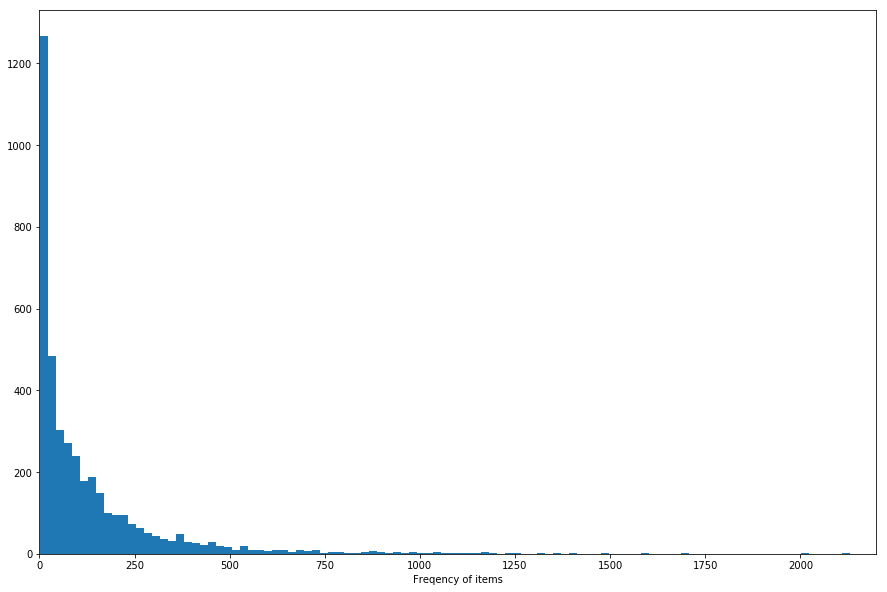

In [176]:
plt.rcParams['figure.figsize']=15,10

plt.hist(item_freq.values(),bins=4000)
plt.xlim(0,2200)
plt.xlabel("Freqency of items")
plt.show()

In [ ]:
# only items with frequency > X
'''
item_ls_50 = []
for i,j in zip(item_freq,item_freq.values()):
    if j >= 400:
        item_ls_50.append(i)
len(item_ls_50)

cur_inv = inv_no[0]
item_ls = []
inv_item_dic = {}
for i in range(len(inv_no)):
    if inv_no[i] == cur_inv:
        if item[i] in item_ls_50:
            item_ls.append(item[i])
    else:
        inv_item_dic.update({cur_inv:item_ls})
        cur_inv = inv_no[i]
        item_ls = []
        if item[i] in item_ls_50:
            item_ls.append(item[i])
'''

In [138]:
# item list for each order
cur_inv = new_inv_no[0]
item_ls = []
final_ls = []
for i in range(len(new_inv_no)):
    if new_inv_no[i] == cur_inv:
        item_ls.append(new_item[i])
    else:
        final_ls.append(item_ls)
        cur_inv = new_inv_no[i]
        item_ls = []
        item_ls.append(new_item[i])

final_ls

In [186]:
len(final_ls)

19935

In [187]:
# Model
#results = list(apriori(final_ls,min_support=0.0045, min_confidence=0.2, min_lift=3, min_length=2))
#results2 = list(apriori(final_ls,min_support=0.0045, min_confidence=0.2, min_lift=3, min_length=2))
#Above Step need to run 2 hrs

cnt = 1
rule_lst = []
support_dic = {}
confidence_dic = {}
lift_dic = {}
conf_lst = []
lift_lst = []
for groups in results:
    for pairs_num in range(len(groups[2])):
    # first index of the inner list
    # Contains base item and add item
        item_1 = ''
        item_2 = ''
        for items_num in range(2):
            item = [x for x in groups[2][pairs_num][items_num]]

            if items_num == 0:
                for i in item:
                    if i != item[-1]:
                        item_1 += i + ", "
                    else:
                        item_1 += i
            else:
                for i in item:
                    if i != item[-1]:
                        item_2 += i + ", "
                    else:
                        item_2 += i

        rule = item_1 + " -> " + item_2
        print("No.",cnt)
        print("Rule: ", rule)

        #second index of the inner list
        print("Support: " + str(groups[1]))

        #third index of the list located at 0th
        #of the third index of the inner list

        print("Confidence: " + str(groups[2][pairs_num][2]))
        print("Lift: " + str(groups[2][pairs_num][3]))
        print("=====================================")

        cnt += 1
        rule_lst.append(rule)
        support_dic.update({rule:groups[1]})
        confidence_dic.update({rule:str(groups[2][pairs_num][2])+','+str(groups[1])})
        lift_dic.update({rule:str(groups[2][pairs_num][3])+','+str(groups[1])})
        conf_lst.append(groups[2][pairs_num][2])
        lift_lst.append(groups[2][pairs_num][3])

No. 1
Rule:   DOLLY GIRL BEAKER -> DOLLY GIRL LUNCH BOX
Support: 0.0047153248056182595
Confidence: 0.5402298850574713
Lift: 12.669979716024342
No. 2
Rule:   DOLLY GIRL BEAKER -> SPACEBOY BEAKER
Support: 0.0062202157010283424
Confidence: 0.7126436781609196
Lift: 77.20952023988005
No. 3
Rule:  SPACEBOY BEAKER ->  DOLLY GIRL BEAKER
Support: 0.0062202157010283424
Confidence: 0.6739130434782609
Lift: 77.20952023988005
No. 4
Rule:   SET 2 TEA TOWELS I LOVE LONDON  -> LUNCH BOX I LOVE LONDON
Support: 0.005066466014547279
Confidence: 0.3754646840148699
Lift: 10.586829527349973
No. 5
Rule:   SPACEBOY BABY GIFT SET -> DOLLY GIRL BABY GIFT SET
Support: 0.004765487835465262
Confidence: 0.5163043478260869
Lift: 77.38742236024844
No. 6
Rule:  DOLLY GIRL BABY GIFT SET ->  SPACEBOY BABY GIFT SET
Support: 0.004765487835465262
Confidence: 0.7142857142857142
Lift: 77.38742236024844
No. 7
Rule:  12 PENCIL SMALL TUBE WOODLAND -> 12 PENCILS SMALL TUBE RED RETROSPOT
Support: 0.006671682969651367
Confidence: 

Lift: 10.66406783519235
No. 197
Rule:  VINTAGE PAISLEY STATIONERY SET -> 6 RIBBONS RUSTIC CHARM
Support: 0.006170052671181339
Confidence: 0.28211009174311924
Lift: 5.888863538114222
No. 198
Rule:  VINTAGE SNAKES & LADDERS -> 6 RIBBONS RUSTIC CHARM
Support: 0.005367444193629296
Confidence: 0.26884422110552764
Lift: 5.611947170407009
No. 199
Rule:  WALL TIDY RETROSPOT  -> 6 RIBBONS RUSTIC CHARM
Support: 0.004514672686230248
Confidence: 0.3071672354948805
Lift: 6.411915015277951
No. 200
Rule:  WICKER STAR  -> 6 RIBBONS RUSTIC CHARM
Support: 0.0047153248056182595
Confidence: 0.23209876543209879
Lift: 4.844909831297267
No. 201
Rule:  6 RIBBONS SHIMMERING PINKS  -> CHARLOTTE BAG SUKI DESIGN
Support: 0.0047153248056182595
Confidence: 0.4723618090452262
Lift: 10.67634088811404
No. 202
Rule:  6 RIBBONS SHIMMERING PINKS  -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004865813895159268
Confidence: 0.4874371859296483
Lift: 9.397543811902842
No. 203
Rule:  6 RIBBONS SHIMMERING PINKS  -> SKULL SHOULDER 

Rule:  AIRLINE BAG VINTAGE TOKYO 78 -> JUMBO BAG PINK POLKADOT
Support: 0.0047153248056182595
Confidence: 0.2379746835443038
Lift: 3.8949304732805388
No. 385
Rule:  AIRLINE BAG VINTAGE TOKYO 78 -> JUMBO BAG RED RETROSPOT
Support: 0.007975921745673438
Confidence: 0.40253164556962023
Lift: 3.8357879323280972
No. 386
Rule:  AIRLINE BAG VINTAGE TOKYO 78 -> JUMBO BAG WOODLAND ANIMALS
Support: 0.004815650865312265
Confidence: 0.2430379746835443
Lift: 5.614092729219531
No. 387
Rule:  AIRLINE BAG VINTAGE TOKYO 78 -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005718585402558315
Confidence: 0.28860759493670884
Lift: 4.896504174521949
No. 388
Rule:  AIRLINE BAG VINTAGE TOKYO 78 -> JUMBO STORAGE BAG SUKI
Support: 0.005618259342864309
Confidence: 0.2835443037974683
Lift: 4.774033527198084
No. 389
Rule:  AIRLINE BAG VINTAGE TOKYO 78 -> LUNCH BAG  BLACK SKULL.
Support: 0.004614998745924254
Confidence: 0.23291139240506328
Lift: 3.6473594717949225
No. 390
Rule:  AIRLINE BAG VINTAGE TOKYO 78 -> LUNCH 

Confidence: 0.3409610983981693
Lift: 10.039969714279918
No. 572
Rule:  HAND OVER THE CHOCOLATE   SIGN  -> AREA PATROLLED METAL SIGN
Support: 0.007474291447203411
Confidence: 0.22008862629246675
Lift: 10.03996971427992
No. 573
Rule:  AREA PATROLLED METAL SIGN -> HOT BATHS METAL SIGN
Support: 0.005016302984700276
Confidence: 0.22883295194508008
Lift: 7.49061559445841
No. 574
Rule:  AREA PATROLLED METAL SIGN -> LADIES & GENTLEMEN METAL SIGN
Support: 0.004564835716077251
Confidence: 0.20823798627002288
Lift: 8.684569573834532
No. 575
Rule:  AREA PATROLLED METAL SIGN -> NO SINGING METAL SIGN
Support: 0.005016302984700276
Confidence: 0.22883295194508008
Lift: 9.197146969808813
No. 576
Rule:  NO SINGING METAL SIGN -> AREA PATROLLED METAL SIGN
Support: 0.005016302984700276
Confidence: 0.20161290322580644
Lift: 9.197146969808813
No. 577
Rule:  AREA PATROLLED METAL SIGN -> PLEASE ONE PERSON METAL SIGN
Support: 0.0065211938801103585
Confidence: 0.2974828375286041
Lift: 7.018130610807956
No. 578
R

No. 759
Rule:  BEADED CRYSTAL HEART PINK ON STICK -> FLORAL FOLK STATIONERY SET
Support: 0.006671682969651367
Confidence: 0.6456310679611651
Lift: 30.283894917190178
No. 760
Rule:  FLORAL FOLK STATIONERY SET -> BEADED CRYSTAL HEART PINK ON STICK
Support: 0.006671682969651367
Confidence: 0.3129411764705882
Lift: 30.283894917190178
No. 761
Rule:  BEADED CRYSTAL HEART PINK ON STICK -> GOLD MINI TAPE MEASURE 
Support: 0.0047153248056182595
Confidence: 0.4563106796116505
Lift: 44.37343121004026
No. 762
Rule:  GOLD MINI TAPE MEASURE  -> BEADED CRYSTAL HEART PINK ON STICK
Support: 0.0047153248056182595
Confidence: 0.4585365853658537
Lift: 44.37343121004026
No. 763
Rule:  BEADED CRYSTAL HEART PINK ON STICK -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.006571356909957362
Confidence: 0.6359223300970874
Lift: 12.489765172892056
No. 764
Rule:  BEADED CRYSTAL HEART PINK ON STICK -> HEART DECORATION RUSTIC HANGING 
Support: 0.004966139954853273
Confidence: 0.48058252427184467
Lift: 28.17768418046830

Support: 0.004564835716077251
Confidence: 0.2826086956521739
Lift: 13.31868640148011
No. 947
Rule:  CHILDRENS CUTLERY POLKADOT PINK -> BLUE POLKADOT BOWL
Support: 0.004564835716077251
Confidence: 0.21513002364066192
Lift: 13.31868640148011
No. 948
Rule:  BLUE POLKADOT BOWL -> GREEN POLKADOT BOWL
Support: 0.006420867820416353
Confidence: 0.39751552795031053
Lift: 38.65596121799727
No. 949
Rule:  GREEN POLKADOT BOWL -> BLUE POLKADOT BOWL
Support: 0.006420867820416353
Confidence: 0.624390243902439
Lift: 38.65596121799727
No. 950
Rule:  BLUE POLKADOT BOWL -> LUNCH BAG  BLACK SKULL.
Support: 0.004815650865312265
Confidence: 0.2981366459627329
Lift: 4.668777719769898
No. 951
Rule:  BLUE POLKADOT BOWL -> LUNCH BAG CARS BLUE
Support: 0.004564835716077251
Confidence: 0.2826086956521739
Lift: 4.898960302457467
No. 952
Rule:  BLUE POLKADOT BOWL -> LUNCH BAG RED RETROSPOT
Support: 0.004614998745924254
Confidence: 0.2857142857142857
Lift: 3.6417610522469857
No. 953
Rule:  BLUE POLKADOT BOWL -> PACK

No. 1134
Rule:  BREAD BIN DINER STYLE IVORY -> IVORY KITCHEN SCALES
Support: 0.004665161775771256
Confidence: 0.24799999999999997
Lift: 6.914517482517481
No. 1135
Rule:  BUFFALO BILL TREASURE BOOK BOX -> GYMKHANA TREASURE BOOK BOX
Support: 0.004966139954853273
Confidence: 0.5657142857142857
Lift: 56.387571428571434
No. 1136
Rule:  GYMKHANA TREASURE BOOK BOX -> BUFFALO BILL TREASURE BOOK BOX
Support: 0.004966139954853273
Confidence: 0.49500000000000005
Lift: 56.387571428571434
No. 1137
Rule:  BUFFALO BILL TREASURE BOOK BOX -> TREASURE ISLAND BOOK BOX
Support: 0.005116629044394282
Confidence: 0.5828571428571429
Lift: 43.51781701444623
No. 1138
Rule:  TREASURE ISLAND BOOK BOX -> BUFFALO BILL TREASURE BOOK BOX
Support: 0.005116629044394282
Confidence: 0.3820224719101124
Lift: 43.51781701444623
No. 1139
Rule:  BUTTON BOX  -> CARD PARTY GAMES 
Support: 0.005066466014547279
Confidence: 0.404
Lift: 34.27123404255319
No. 1140
Rule:  CARD PARTY GAMES  -> BUTTON BOX 
Support: 0.005066466014547279

No. 1384
Rule:  CERAMIC STRAWBERRY CAKE MONEY BANK -> CHARLOTTE BAG SUKI DESIGN
Support: 0.005216955104088287
Confidence: 0.2653061224489796
Lift: 5.996459808413162
No. 1385
Rule:  CERAMIC STRAWBERRY CAKE MONEY BANK -> LUNCH BAG  BLACK SKULL.
Support: 0.00491597692500627
Confidence: 0.25
Lift: 3.9149646504320503
No. 1386
Rule:  CERAMIC STRAWBERRY CAKE MONEY BANK -> LUNCH BAG CARS BLUE
Support: 0.004614998745924254
Confidence: 0.23469387755102042
Lift: 4.068367346938776
No. 1387
Rule:  CERAMIC STRAWBERRY CAKE MONEY BANK -> LUNCH BAG PINK POLKADOT
Support: 0.0047153248056182595
Confidence: 0.23979591836734696
Lift: 4.385625351057855
No. 1388
Rule:  CERAMIC STRAWBERRY CAKE MONEY BANK -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.0062202157010283424
Confidence: 0.3163265306122449
Lift: 4.7772495361781075
No. 1389
Rule:  CERAMIC STRAWBERRY CAKE MONEY BANK -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.005066466014547279
Confidence: 0.25765306122448983
Lift: 4.598311347815761
No. 1390
Rule:  

Rule:  CHARLOTTE BAG PINK POLKADOT -> JUMBO BAG STRAWBERRY
Support: 0.008477552044143466
Confidence: 0.22745625841184386
Lift: 5.4961703168971
No. 1572
Rule:  JUMBO BAG STRAWBERRY -> CHARLOTTE BAG PINK POLKADOT
Support: 0.008477552044143466
Confidence: 0.20484848484848484
Lift: 5.4961703168971
No. 1573
Rule:  CHARLOTTE BAG PINK POLKADOT -> JUMBO BAG WOODLAND ANIMALS
Support: 0.007975921745673438
Confidence: 0.2139973082099596
Lift: 4.9432634289287884
No. 1574
Rule:  CHARLOTTE BAG PINK POLKADOT -> JUMBO STORAGE BAG SUKI
Support: 0.010684725357411587
Confidence: 0.28667563930013457
Lift: 4.826755801898803
No. 1575
Rule:  LOVEBIRD HANGING DECORATION WHITE  -> CHARLOTTE BAG PINK POLKADOT
Support: 0.005517933283170303
Confidence: 0.20220588235294115
Lift: 5.425268189375346
No. 1576
Rule:  CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL.
Support: 0.013594181088537747
Confidence: 0.3647375504710632
Lift: 5.711738467117553
No. 1577
Rule:  LUNCH BAG  BLACK SKULL. -> CHARLOTTE BAG PINK POL

Lift: 5.198374046094259
No. 1759
Rule:  CHARLOTTE BAG VINTAGE ALPHABET  -> LUNCH BAG  BLACK SKULL.
Support: 0.008377225984449461
Confidence: 0.37528089887640453
Lift: 5.876845812333955
No. 1760
Rule:  CHARLOTTE BAG VINTAGE ALPHABET  -> LUNCH BAG ALPHABET DESIGN
Support: 0.007875595685979434
Confidence: 0.352808988764045
Lift: 9.504388095961131
No. 1761
Rule:  LUNCH BAG ALPHABET DESIGN -> CHARLOTTE BAG VINTAGE ALPHABET 
Support: 0.007875595685979434
Confidence: 0.2121621621621622
Lift: 9.504388095961131
No. 1762
Rule:  CHARLOTTE BAG VINTAGE ALPHABET  -> LUNCH BAG APPLE DESIGN
Support: 0.0090795084023075
Confidence: 0.4067415730337079
Lift: 7.826634419331049
No. 1763
Rule:  CHARLOTTE BAG VINTAGE ALPHABET  -> LUNCH BAG CARS BLUE
Support: 0.0077251065964384245
Confidence: 0.34606741573033706
Lift: 5.999003419638496
No. 1764
Rule:  CHARLOTTE BAG VINTAGE ALPHABET  -> LUNCH BAG PINK POLKADOT
Support: 0.006420867820416353
Confidence: 0.2876404494382023
Lift: 5.260653540872076
No. 1765
Rule:  C

Rule:  COOK WITH WINE METAL SIGN  -> CHOCOLATE THIS WAY METAL SIGN
Support: 0.00802608477552044
Confidence: 0.22130013831258644
Lift: 9.426534737738058
No. 1947
Rule:  CHOCOLATE THIS WAY METAL SIGN -> GIN + TONIC DIET METAL SIGN
Support: 0.008929019312766491
Confidence: 0.3803418803418804
Lift: 9.989611837437925
No. 1948
Rule:  GIN + TONIC DIET METAL SIGN -> CHOCOLATE THIS WAY METAL SIGN
Support: 0.008929019312766491
Confidence: 0.23451910408432147
Lift: 9.989611837437925
No. 1949
Rule:  CHOCOLATE THIS WAY METAL SIGN -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.004815650865312265
Confidence: 0.20512820512820515
Lift: 4.028798787419477
No. 1950
Rule:  CHOCOLATE THIS WAY METAL SIGN -> HAND OVER THE CHOCOLATE   SIGN 
Support: 0.009480812641083521
Confidence: 0.40384615384615385
Lift: 11.891688444494944
No. 1951
Rule:  HAND OVER THE CHOCOLATE   SIGN  -> CHOCOLATE THIS WAY METAL SIGN
Support: 0.009480812641083521
Confidence: 0.2791728212703102
Lift: 11.891688444494944
No. 1952
Rule:  CHOCO

No. 2148
Rule:  COFFEE MUG CAT + BIRD DESIGN -> COFFEE MUG DOG + BALL DESIGN
Support: 0.0077251065964384245
Confidence: 0.6039215686274509
Lift: 61.11257091669155
No. 2149
Rule:  COFFEE MUG DOG + BALL DESIGN -> COFFEE MUG CAT + BIRD DESIGN
Support: 0.0077251065964384245
Confidence: 0.7817258883248731
Lift: 61.112570916691546
No. 2150
Rule:  COLOUR GLASS T-LIGHT HOLDER HANGING -> VICTORIAN GLASS HANGING T-LIGHT
Support: 0.008527715073990468
Confidence: 0.27375201288244766
Lift: 5.262532668092184
No. 2151
Rule:  COLOURING PENCILS BROWN TUBE -> FLORAL FOLK STATIONERY SET
Support: 0.005016302984700276
Confidence: 0.3021148036253776
Lift: 14.17096143593389
No. 2152
Rule:  FLORAL FOLK STATIONERY SET -> COLOURING PENCILS BROWN TUBE
Support: 0.005016302984700276
Confidence: 0.23529411764705882
Lift: 14.17096143593389
No. 2153
Rule:  COLOURING PENCILS BROWN TUBE -> JAM MAKING SET PRINTED
Support: 0.004815650865312265
Confidence: 0.29003021148036257
Lift: 4.975690418124809
No. 2154
Rule:  COLOUR

No. 2341
Rule:  EDWARDIAN PARASOL NATURAL -> JUMBO BAG PINK POLKADOT
Support: 0.0068221720591923754
Confidence: 0.2518518518518519
Lift: 4.122058018609743
No. 2342
Rule:  EDWARDIAN PARASOL NATURAL -> JUMBO BAG RED RETROSPOT
Support: 0.008979182342613494
Confidence: 0.3314814814814815
Lift: 3.1587396430847674
No. 2343
Rule:  EDWARDIAN PARASOL NATURAL -> JUMBO BAG WOODLAND ANIMALS
Support: 0.006019563581640331
Confidence: 0.2222222222222222
Lift: 5.133256083429895
No. 2344
Rule:  EDWARDIAN PARASOL NATURAL -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.007373965387509405
Confidence: 0.2722222222222222
Lift: 4.618510638297872
No. 2345
Rule:  EDWARDIAN PARASOL NATURAL -> JUMBO STORAGE BAG SUKI
Support: 0.006471030850263356
Confidence: 0.2388888888888889
Lift: 4.022170608108108
No. 2346
Rule:  RED RETROSPOT UMBRELLA -> EDWARDIAN PARASOL NATURAL
Support: 0.005216955104088287
Confidence: 0.27882037533512066
Lift: 10.293118856121538
No. 2347
Rule:  EDWARDIAN PARASOL NATURAL -> ROSES REGENCY TE

No. 2571
Rule:  FLORAL FOLK STATIONERY SET -> PINK REGENCY TEACUP AND SAUCER
Support: 0.005367444193629296
Confidence: 0.25176470588235295
Lift: 6.552127169405622
No. 2572
Rule:  FLORAL FOLK STATIONERY SET -> PINK VINTAGE PAISLEY PICNIC BAG
Support: 0.00491597692500627
Confidence: 0.23058823529411765
Lift: 11.211649928263988
No. 2573
Rule:  PINK VINTAGE PAISLEY PICNIC BAG -> FLORAL FOLK STATIONERY SET
Support: 0.00491597692500627
Confidence: 0.23902439024390243
Lift: 11.211649928263988
No. 2574
Rule:  FLORAL FOLK STATIONERY SET -> POPCORN HOLDER
Support: 0.005869074492099322
Confidence: 0.2752941176470588
Lift: 6.834356457402388
No. 2575
Rule:  FLORAL FOLK STATIONERY SET -> RABBIT NIGHT LIGHT
Support: 0.005768748432405317
Confidence: 0.27058823529411763
Lift: 5.426736891939874
No. 2576
Rule:  FLORAL FOLK STATIONERY SET -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.0077251065964384245
Confidence: 0.3623529411764706
Lift: 6.466880825741219
No. 2577
Rule:  FLORAL FOLK STATIONERY SET -> RE

No. 2821
Rule:  GOLD MINI TAPE MEASURE  -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.005417607223476298
Confidence: 0.526829268292683
Lift: 10.347134446713925
No. 2822
Rule:  GOLD MINI TAPE MEASURE  -> JAM MAKING SET PRINTED
Support: 0.006119889641334336
Confidence: 0.5951219512195122
Lift: 10.209772889467276
No. 2823
Rule:  GOLD MINI TAPE MEASURE  -> JAM MAKING SET WITH JARS
Support: 0.005066466014547279
Confidence: 0.4926829268292683
Lift: 8.668697393063956
No. 2824
Rule:  GOLD MINI TAPE MEASURE  -> JUMBO BAG RED RETROSPOT
Support: 0.005768748432405317
Confidence: 0.5609756097560975
Lift: 5.3456256120878605
No. 2825
Rule:  GOLD MINI TAPE MEASURE  -> MODERN FLORAL STATIONERY SET
Support: 0.005066466014547279
Confidence: 0.4926829268292683
Lift: 26.835065973610558
No. 2826
Rule:  MODERN FLORAL STATIONERY SET -> GOLD MINI TAPE MEASURE 
Support: 0.005066466014547279
Confidence: 0.2759562841530055
Lift: 26.835065973610558
No. 2827
Rule:  GOLD MINI TAPE MEASURE  -> NATURAL SLATE HEART CHA

No. 3071
Rule:  HANGING HEART ZINC T-LIGHT HOLDER -> SINGLE HEART ZINC T-LIGHT HOLDER
Support: 0.014045648357160772
Confidence: 0.4643449419568822
Lift: 18.25782330948806
No. 3072
Rule:  SINGLE HEART ZINC T-LIGHT HOLDER -> HANGING HEART ZINC T-LIGHT HOLDER
Support: 0.014045648357160772
Confidence: 0.5522682445759369
Lift: 18.257823309488064
No. 3073
Rule:  SUKI  SHOULDER BAG -> HANGING HEART ZINC T-LIGHT HOLDER
Support: 0.00581891146225232
Confidence: 0.2188679245283019
Lift: 7.235708251196845
No. 3074
Rule:  HANGING HEART ZINC T-LIGHT HOLDER -> VICTORIAN GLASS HANGING T-LIGHT
Support: 0.008527715073990468
Confidence: 0.2819237147595356
Lift: 5.41962319549792
No. 3075
Rule:  VINTAGE PAISLEY STATIONERY SET -> HANGING HEART ZINC T-LIGHT HOLDER
Support: 0.004966139954853273
Confidence: 0.22706422018348624
Lift: 7.506675338901821
No. 3076
Rule:  HANGING HEART ZINC T-LIGHT HOLDER -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.010885377476799598
Confidence: 0.3598673300165837
Lift: 3.17431

Rule:  RED RETROSPOT OVEN GLOVE  -> HOT BATHS METAL SIGN
Support: 0.006170052671181339
Confidence: 0.2727272727272727
Lift: 8.927451858486341
No. 3259
Rule:  RED RETROSPOT PEG BAG -> HOT BATHS METAL SIGN
Support: 0.005116629044394282
Confidence: 0.21030927835051547
Lift: 6.884261845513179
No. 3260
Rule:  VINTAGE PAISLEY STATIONERY SET -> HOT BATHS METAL SIGN
Support: 0.004765487835465262
Confidence: 0.2178899082568807
Lift: 7.13240611018213
No. 3261
Rule:  HOT BATHS METAL SIGN -> WOODLAND CHARLOTTE BAG
Support: 0.006922498118886381
Confidence: 0.22660098522167488
Lift: 5.409928910651604
No. 3262
Rule:  YOU'RE CONFUSING ME METAL SIGN  -> HOT BATHS METAL SIGN
Support: 0.00491597692500627
Confidence: 0.21777777777777776
Lift: 7.128735632183908
No. 3263
Rule:  HOT WATER BOTTLE I AM SO POORLY -> HOT WATER BOTTLE KEEP CALM
Support: 0.010885377476799598
Confidence: 0.3302891933028919
Lift: 8.419840241039834
No. 3264
Rule:  HOT WATER BOTTLE KEEP CALM -> HOT WATER BOTTLE I AM SO POORLY
Support:

Lift: 6.393768176754011
No. 3493
Rule:  NATURAL SLATE CHALKBOARD LARGE  -> JAM MAKING SET WITH JARS
Support: 0.005116629044394282
Confidence: 0.2142857142857143
Lift: 3.7703316101374353
No. 3494
Rule:  JAM MAKING SET WITH JARS -> NATURAL SLATE HEART CHALKBOARD 
Support: 0.012089290193127666
Confidence: 0.21270962047661077
Lift: 3.3950090345886594
No. 3495
Rule:  PACK OF 12 LONDON TISSUES  -> JAM MAKING SET WITH JARS
Support: 0.005417607223476298
Confidence: 0.21052631578947367
Lift: 3.7041854415385327
No. 3496
Rule:  PACK OF 12 SUKI TISSUES  -> JAM MAKING SET WITH JARS
Support: 0.004514672686230248
Confidence: 0.25069637883008355
Lift: 4.410972914366916
No. 3497
Rule:  PACK OF 12 TRADITIONAL CRAYONS -> JAM MAKING SET WITH JARS
Support: 0.005618259342864309
Confidence: 0.25282167042889386
Lift: 4.448367166813767
No. 3498
Rule:  PACK OF 20 NAPKINS PANTRY DESIGN -> JAM MAKING SET WITH JARS
Support: 0.008628041133684474
Confidence: 0.25671641791044775
Lift: 4.516894784682061
No. 3499
Rule:

Rule:  TOILET SIGN OCCUPIED OR VACANT -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.005969400551793329
Confidence: 0.2748267898383372
Lift: 5.872102953298233
No. 3634
Rule:  TOY TIDY PINK POLKADOT -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.006571356909957362
Confidence: 0.279317697228145
Lift: 5.96805819318657
No. 3635
Rule:  VINTAGE PAISLEY STATIONERY SET -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.005016302984700276
Confidence: 0.2293577981651376
Lift: 4.900587037965721
No. 3636
Rule:  JUMBO BAG 50'S CHRISTMAS  -> JUMBO BAG ALPHABET
Support: 0.009380486581389517
Confidence: 0.26117318435754194
Lift: 5.746674867734656
No. 3637
Rule:  JUMBO BAG ALPHABET -> JUMBO BAG 50'S CHRISTMAS 
Support: 0.009380486581389517
Confidence: 0.20640176600441504
Lift: 5.746674867734656
No. 3638
Rule:  JUMBO BAG 50'S CHRISTMAS  -> JUMBO BAG APPLES
Support: 0.00983195385001254
Confidence: 0.2737430167597765
Lift: 5.579823148370291
No. 3639
Rule:  JUMBO BAG APPLES -> JUMBO BAG 50'S CHRISTMAS 
Support: 0.00

Confidence: 0.3
Lift: 7.04416961130742
No. 3821
Rule:  JUMBO BAG CHARLIE AND LOLA TOYS -> SUKI  SHOULDER BAG
Support: 0.005166792074241284
Confidence: 0.3433333333333333
Lift: 12.9138679245283
No. 3822
Rule:  JUMBO BAG DOILEY PATTERNS -> JUMBO BAG PEARS
Support: 0.008628041133684474
Confidence: 0.33463035019455256
Lift: 11.211522741392278
No. 3823
Rule:  JUMBO BAG PEARS -> JUMBO BAG DOILEY PATTERNS
Support: 0.008628041133684474
Confidence: 0.28907563025210087
Lift: 11.211522741392278
No. 3824
Rule:  JUMBO BAG DOILEY PATTERNS -> JUMBO BAG PINK POLKADOT
Support: 0.006320541760722348
Confidence: 0.24513618677042803
Lift: 4.012142761304173
No. 3825
Rule:  JUMBO BAG DOILEY PATTERNS -> JUMBO BAG RED RETROSPOT
Support: 0.010885377476799598
Confidence: 0.42217898832684825
Lift: 4.023010579491261
No. 3826
Rule:  JUMBO BAG DOILEY PATTERNS -> JUMBO BAG STRAWBERRY
Support: 0.005568096313017306
Confidence: 0.21595330739299612
Lift: 5.218217191368942
No. 3827
Rule:  JUMBO BAG DOILEY PATTERNS -> JUMB

No. 4008
Rule:  PICNIC BASKET WICKER LARGE -> JUMBO BAG PINK POLKADOT
Support: 0.005869074492099322
Confidence: 0.26174496644295303
Lift: 4.283978576387741
No. 4009
Rule:  PICNIC BASKET WICKER SMALL -> JUMBO BAG PINK POLKADOT
Support: 0.00637070479056935
Confidence: 0.27489177489177485
Lift: 4.499152325507005
No. 4010
Rule:  PINK BABY BUNTING -> JUMBO BAG PINK POLKADOT
Support: 0.005216955104088287
Confidence: 0.30144927536231886
Lift: 4.933818804883273
No. 4011
Rule:  PINK VINTAGE PAISLEY PICNIC BAG -> JUMBO BAG PINK POLKADOT
Support: 0.0047153248056182595
Confidence: 0.22926829268292684
Lift: 3.752433016941007
No. 4012
Rule:  POTTERING IN THE SHED METAL SIGN -> JUMBO BAG PINK POLKADOT
Support: 0.006270378730875345
Confidence: 0.23234200743494424
Lift: 3.802740491145824
No. 4013
Rule:  POTTERING MUG -> JUMBO BAG PINK POLKADOT
Support: 0.004564835716077251
Confidence: 0.2732732732732733
Lift: 4.472662317489904
No. 4014
Rule:  RECORD FRAME 7" SINGLE SIZE  -> JUMBO BAG PINK POLKADOT
Supp

Support: 0.009530975670930524
Confidence: 0.28700906344410876
Lift: 8.316171046160331
No. 4196
Rule:  JUMBO BAG SPACEBOY DESIGN -> JUMBO BAG SCANDINAVIAN BLUE PAISLEY
Support: 0.009530975670930524
Confidence: 0.2761627906976744
Lift: 8.316171046160331
No. 4197
Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY -> JUMBO BAG STRAWBERRY
Support: 0.010132932029094557
Confidence: 0.30513595166163143
Lift: 7.373194177423785
No. 4198
Rule:  JUMBO BAG STRAWBERRY -> JUMBO BAG SCANDINAVIAN BLUE PAISLEY
Support: 0.010132932029094557
Confidence: 0.24484848484848484
Lift: 7.373194177423785
No. 4199
Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY -> JUMBO BAG TOYS 
Support: 0.008176573865061449
Confidence: 0.24622356495468276
Lift: 9.385213704343405
No. 4200
Rule:  JUMBO BAG TOYS  -> JUMBO BAG SCANDINAVIAN BLUE PAISLEY
Support: 0.008176573865061449
Confidence: 0.3116634799235181
Lift: 9.385213704343405
No. 4201
Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY -> JUMBO BAG VINTAGE DOILY 
Support: 0.007373965387509405
C

No. 4383
Rule:  NATURAL SLATE CHALKBOARD LARGE  -> JUMBO BAG WOODLAND ANIMALS
Support: 0.005568096313017306
Confidence: 0.23319327731092437
Lift: 5.386683642170657
No. 4384
Rule:  JUMBO BAG WOODLAND ANIMALS -> NATURAL SLATE HEART CHALKBOARD 
Support: 0.008678204163531477
Confidence: 0.2004634994206257
Lift: 3.199551529984126
No. 4385
Rule:  PICNIC BASKET WICKER LARGE -> JUMBO BAG WOODLAND ANIMALS
Support: 0.005417607223476298
Confidence: 0.24161073825503357
Lift: 5.581124063863377
No. 4386
Rule:  PICNIC BASKET WICKER SMALL -> JUMBO BAG WOODLAND ANIMALS
Support: 0.0068221720591923754
Confidence: 0.29437229437229434
Lift: 6.7998976689590815
No. 4387
Rule:  PINK BABY BUNTING -> JUMBO BAG WOODLAND ANIMALS
Support: 0.005066466014547279
Confidence: 0.2927536231884058
Lift: 6.762506927301123
No. 4388
Rule:  PINK VINTAGE PAISLEY PICNIC BAG -> JUMBO BAG WOODLAND ANIMALS
Support: 0.004665161775771256
Confidence: 0.2268292682926829
Lift: 5.239677246135149
No. 4389
Rule:  POLKADOT RAIN HAT  -> JUM

No. 4632
Rule:  LADIES & GENTLEMEN METAL SIGN -> YOU'RE CONFUSING ME METAL SIGN 
Support: 0.005066466014547279
Confidence: 0.2112970711297071
Lift: 9.360460251046025
No. 4633
Rule:  YOU'RE CONFUSING ME METAL SIGN  -> LADIES & GENTLEMEN METAL SIGN
Support: 0.005066466014547279
Confidence: 0.22444444444444445
Lift: 9.360460251046025
No. 4634
Rule:  LANTERN CREAM GAZEBO  -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.005869074492099322
Confidence: 0.3913043478260869
Lift: 3.4516160061562133
No. 4635
Rule:  LARGE CERAMIC TOP STORAGE JAR -> MEDIUM CERAMIC TOP STORAGE JAR
Support: 0.007474291447203411
Confidence: 0.5321428571428571
Lift: 42.94845286292655
No. 4636
Rule:  MEDIUM CERAMIC TOP STORAGE JAR -> LARGE CERAMIC TOP STORAGE JAR
Support: 0.007474291447203411
Confidence: 0.6032388663967612
Lift: 42.94845286292655
No. 4637
Rule:  LARGE CERAMIC TOP STORAGE JAR -> SMALL CERAMIC TOP STORAGE JAR 
Support: 0.005668422372711312
Confidence: 0.4035714285714286
Lift: 34.82769016697588
No. 4638
R

No. 4883
Rule:  RED RETROSPOT CHARLOTTE BAG -> LUNCH BAG CARS BLUE
Support: 0.015299724103335842
Confidence: 0.2949709864603482
Lift: 5.113257926162645
No. 4884
Rule:  RED RETROSPOT CUP -> LUNCH BAG CARS BLUE
Support: 0.004665161775771256
Confidence: 0.24031007751937986
Lift: 4.16572295247725
No. 4885
Rule:  RED RETROSPOT OVEN GLOVE  -> LUNCH BAG CARS BLUE
Support: 0.0059192375219463255
Confidence: 0.2616407982261641
Lift: 4.535486358816158
No. 4886
Rule:  RED RETROSPOT PEG BAG -> LUNCH BAG CARS BLUE
Support: 0.006471030850263356
Confidence: 0.26597938144329897
Lift: 4.610694755714926
No. 4887
Rule:  RED RETROSPOT PICNIC BAG -> LUNCH BAG CARS BLUE
Support: 0.005417607223476298
Confidence: 0.20338983050847456
Lift: 3.5257184966838615
No. 4888
Rule:  RED RETROSPOT SHOPPER BAG -> LUNCH BAG CARS BLUE
Support: 0.00637070479056935
Confidence: 0.2208695652173913
Lift: 3.828725897920605
No. 4889
Rule:  ROUND SNACK BOXES SET OF 4 FRUITS  -> LUNCH BAG CARS BLUE
Support: 0.007524454477050414
Conf

Lift: 4.328398978809242
No. 5133
Rule:  PLASTERS IN TIN SPACEBOY -> LUNCH BAG WOODLAND
Support: 0.007875595685979434
Confidence: 0.2332838038632987
Lift: 4.56828352653719
No. 5134
Rule:  PLASTERS IN TIN WOODLAND ANIMALS -> LUNCH BAG WOODLAND
Support: 0.008628041133684474
Confidence: 0.24431818181818182
Lift: 4.784364395427755
No. 5135
Rule:  LUNCH BAG WOODLAND -> RED RETROSPOT CHARLOTTE BAG
Support: 0.013192876849761725
Confidence: 0.2583497053045187
Lift: 4.9808523938545255
No. 5136
Rule:  RED RETROSPOT CHARLOTTE BAG -> LUNCH BAG WOODLAND
Support: 0.013192876849761725
Confidence: 0.25435203094777564
Lift: 4.9808523938545255
No. 5137
Rule:  RED RETROSPOT OVEN GLOVE  -> LUNCH BAG WOODLAND
Support: 0.005016302984700276
Confidence: 0.22172949002217293
Lift: 4.342021005493141
No. 5138
Rule:  RED RETROSPOT PEG BAG -> LUNCH BAG WOODLAND
Support: 0.005066466014547279
Confidence: 0.20824742268041238
Lift: 4.078008223117898
No. 5139
Rule:  RED RETROSPOT PICNIC BAG -> LUNCH BAG WOODLAND
Support:

Rule:  SMALL DOLLY MIX DESIGN ORANGE BOWL -> NATURAL SLATE HEART CHALKBOARD 
Support: 0.0065211938801103585
Confidence: 0.24667931688804554
Lift: 3.937191498929694
No. 5321
Rule:  SMALL GLASS HEART TRINKET POT -> NATURAL SLATE HEART CHALKBOARD 
Support: 0.008878856282919489
Confidence: 0.3271719038817006
Lift: 5.221915055149481
No. 5322
Rule:  SMALL HEART MEASURING SPOONS -> NATURAL SLATE HEART CHALKBOARD 
Support: 0.007775269626285428
Confidence: 0.3283898305084746
Lift: 5.241354100229336
No. 5323
Rule:  SMALL MARSHMALLOWS PINK BOWL -> NATURAL SLATE HEART CHALKBOARD 
Support: 0.006019563581640331
Confidence: 0.2684563758389262
Lift: 4.284770097957561
No. 5324
Rule:  STRAWBERRY SHOPPER BAG -> NATURAL SLATE HEART CHALKBOARD 
Support: 0.004966139954853273
Confidence: 0.24029126213592233
Lift: 3.835233235131795
No. 5325
Rule:  SUKI  SHOULDER BAG -> NATURAL SLATE HEART CHALKBOARD 
Support: 0.00928016052169551
Confidence: 0.3490566037735849
Lift: 5.571211686330196
No. 5326
Rule:  SWEETHEART

Confidence: 0.28257575757575754
Lift: 8.496452077334428
No. 5508
Rule:  PACK OF 72 SKULL CAKE CASES -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.018710810132932028
Confidence: 0.5625942684766213
Lift: 8.496452077334428
No. 5509
Rule:  PAPER BUNTING RETROSPOT -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.009430649611236519
Confidence: 0.23529411764705882
Lift: 3.5534759358288768
No. 5510
Rule:  PAPER CHAIN KIT EMPIRE -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.00491597692500627
Confidence: 0.22477064220183485
Lift: 3.394547539616347
No. 5511
Rule:  PAPER CHAIN KIT RETROSPOT -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.008628041133684474
Confidence: 0.2819672131147541
Lift: 4.258345752608047
No. 5512
Rule:  PHOTO CUBE -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.006571356909957362
Confidence: 0.40809968847352024
Lift: 6.163232795242141
No. 5513
Rule:  PICTURE DOMINOES -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005517933283170303
Confidence: 0.3089887640449438
Lift: 4.666432584269

No. 5695
Rule:  PAPER CHAIN KIT VINTAGE CHRISTMAS -> PAPER CHAIN KIT 50'S CHRISTMAS 
Support: 0.027689992475545523
Confidence: 0.6731707317073171
Lift: 11.568671152228765
No. 5696
Rule:  PHOTO CUBE -> PAPER CHAIN KIT 50'S CHRISTMAS 
Support: 0.0047153248056182595
Confidence: 0.29283489096573206
Lift: 5.032468578794714
No. 5697
Rule:  PICTURE DOMINOES -> PAPER CHAIN KIT 50'S CHRISTMAS 
Support: 0.005417607223476298
Confidence: 0.3033707865168539
Lift: 5.213531576908174
No. 5698
Rule:  PIZZA PLATE IN BOX -> PAPER CHAIN KIT 50'S CHRISTMAS 
Support: 0.004564835716077251
Confidence: 0.5083798882681564
Lift: 8.736683683298015
No. 5699
Rule:  PLASTERS IN TIN SKULLS -> PAPER CHAIN KIT 50'S CHRISTMAS 
Support: 0.005768748432405317
Confidence: 0.20499108734402852
Lift: 3.522842522588973
No. 5700
Rule:  POPCORN HOLDER -> PAPER CHAIN KIT 50'S CHRISTMAS 
Support: 0.010032605969400551
Confidence: 0.24906600249066002
Lift: 4.280285137630438
No. 5701
Rule:  POPPY'S PLAYHOUSE BEDROOM  -> PAPER CHAIN KI

Support: 0.005367444193629296
Confidence: 0.20498084291187743
Lift: 3.6582749359429516
No. 5883
Rule:  RED FLORAL FELTCRAFT SHOULDER BAG -> PINK BLUE FELT CRAFT TRINKET BOX
Support: 0.004966139954853273
Confidence: 0.32459016393442625
Lift: 12.395986433013004
No. 5884
Rule:  PINK BLUE FELT CRAFT TRINKET BOX -> VINTAGE SNAP CARDS
Support: 0.0053172811637822925
Confidence: 0.20306513409961688
Lift: 4.371601995978253
No. 5885
Rule:  RED FLORAL FELTCRAFT SHOULDER BAG -> PINK CREAM FELT CRAFT TRINKET BOX 
Support: 0.004815650865312265
Confidence: 0.3147540983606557
Lift: 10.186076218863104
No. 5886
Rule:  PINK CREAM FELT CRAFT TRINKET BOX  -> VINTAGE SNAP CARDS
Support: 0.0065211938801103585
Confidence: 0.21103896103896105
Lift: 4.543263162323638
No. 5887
Rule:  PINK DOUGHNUT TRINKET POT  -> STRAWBERRY CERAMIC TRINKET BOX
Support: 0.005116629044394282
Confidence: 0.42148760330578516
Lift: 11.901353217989842
No. 5888
Rule:  PINK DOUGHNUT TRINKET POT  -> SWEETHEART CERAMIC TRINKET BOX
Support

No. 6070
Rule:  POTTERING MUG -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.005568096313017306
Confidence: 0.33333333333333337
Lift: 5.948970456580127
No. 6071
Rule:  POTTERING MUG -> RECYCLING BAG RETROSPOT 
Support: 0.005116629044394282
Confidence: 0.30630630630630634
Lift: 8.163390663390663
No. 6072
Rule:  POTTERING MUG -> RED TOADSTOOL LED NIGHT LIGHT
Support: 0.0047153248056182595
Confidence: 0.2822822822822823
Lift: 6.628147582211186
No. 6073
Rule:  POTTERING MUG -> ROSES REGENCY TEACUP AND SAUCER 
Support: 0.005116629044394282
Confidence: 0.30630630630630634
Lift: 5.728157801328534
No. 6074
Rule:  POTTERING MUG -> SET OF 3 CAKE TINS PANTRY DESIGN 
Support: 0.0047153248056182595
Confidence: 0.2822822822822823
Lift: 4.063030539564836
No. 6075
Rule:  POTTERING MUG -> SUKI  SHOULDER BAG
Support: 0.005417607223476298
Confidence: 0.32432432432432434
Lift: 12.198878123406425
No. 6076
Rule:  SUKI  SHOULDER BAG -> POTTERING MUG
Support: 0.005417607223476298
Confidence: 0.2037735849056603

Rule:  RED RETROSPOT OVEN GLOVE  -> RED RETROSPOT CHARLOTTE BAG
Support: 0.008276899924755455
Confidence: 0.36585365853658536
Lift: 7.053474548285134
No. 6258
Rule:  RED RETROSPOT OVEN GLOVE DOUBLE -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004614998745924254
Confidence: 0.3607843137254902
Lift: 6.955740129707588
No. 6259
Rule:  RED RETROSPOT PEG BAG -> RED RETROSPOT CHARLOTTE BAG
Support: 0.007674943566591422
Confidence: 0.3154639175257732
Lift: 6.081985682665656
No. 6260
Rule:  RED RETROSPOT SHOPPER BAG -> RED RETROSPOT CHARLOTTE BAG
Support: 0.009380486581389517
Confidence: 0.32521739130434785
Lift: 6.270027752081407
No. 6261
Rule:  RED RETROSPOT TAPE -> RED RETROSPOT CHARLOTTE BAG
Support: 0.00491597692500627
Confidence: 0.4083333333333333
Lift: 7.8724613152804634
No. 6262
Rule:  RED SPOT CERAMIC DRAWER KNOB -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004765487835465262
Confidence: 0.2574525745257452
Lift: 4.9635561636080565
No. 6263
Rule:  RED STRIPE CERAMIC DRAWER KNOB -> RED RETROS

No. 6445
Rule:  SLEEPING CAT ERASERS -> REGENCY CAKESTAND 3 TIER
Support: 0.004564835716077251
Confidence: 0.3137931034482759
Lift: 3.1450304259634887
No. 6446
Rule:  SMALL GLASS HEART TRINKET POT -> REGENCY CAKESTAND 3 TIER
Support: 0.009029345372460496
Confidence: 0.33271719038817005
Lift: 3.3346994421257765
No. 6447
Rule:  TEA BAG PLATE RED RETROSPOT -> REGENCY CAKESTAND 3 TIER
Support: 0.005467770253323301
Confidence: 0.3044692737430168
Lift: 3.051581182537476
No. 6448
Rule:  TEA TIME OVEN GLOVE -> REGENCY CAKESTAND 3 TIER
Support: 0.005016302984700276
Confidence: 0.31746031746031744
Lift: 3.181785534726711
No. 6449
Rule:  VINTAGE PAISLEY STATIONERY SET -> REGENCY CAKESTAND 3 TIER
Support: 0.006621519939804364
Confidence: 0.3027522935779816
Lift: 3.0343725351820328
No. 6450
Rule:  WOODLAND CHARLOTTE BAG -> REGENCY CAKESTAND 3 TIER
Support: 0.013042387760220717
Confidence: 0.31137724550898205
Lift: 3.1208171891511096
No. 6451
Rule:  REGENCY MILK JUG PINK  -> REGENCY SUGAR BOWL GREEN

Rule:  ROUND SNACK BOXES SET OF 4 FRUITS  -> ROUND SNACK BOXES SET OF4 WOODLAND 
Support: 0.015450213192876849
Confidence: 0.5301204819277109
Lift: 14.43709263282639
No. 6633
Rule:  ROUND SNACK BOXES SET OF4 WOODLAND  -> ROUND SNACK BOXES SET OF 4 FRUITS 
Support: 0.015450213192876849
Confidence: 0.4207650273224044
Lift: 14.437092632826388
No. 6634
Rule:  SKULL SHOULDER BAG -> ROUND SNACK BOXES SET OF 4 FRUITS 
Support: 0.004665161775771256
Confidence: 0.22627737226277372
Lift: 7.763923263439577
No. 6635
Rule:  ROUND SNACK BOXES SET OF 4 FRUITS  -> SPACEBOY LUNCH BOX 
Support: 0.008226736894908453
Confidence: 0.28227194492254737
Lift: 6.259278333738578
No. 6636
Rule:  ROUND SNACK BOXES SET OF 4 FRUITS  -> WOODLAND CHARLOTTE BAG
Support: 0.0072736393278154
Confidence: 0.2495697074010327
Lift: 5.958289960526452
No. 6637
Rule:  ROUND SNACK BOXES SET OF 4 SKULLS -> ROUND SNACK BOXES SET OF4 WOODLAND 
Support: 0.007223476297968397
Confidence: 0.4982698961937716
Lift: 13.569686312326281
No. 

Lift: 6.90463718334049
No. 6820
Rule:  SMALL HEART MEASURING SPOONS -> SET OF 3 HEART COOKIE CUTTERS
Support: 0.006772009029345372
Confidence: 0.2860169491525424
Lift: 8.323719534826179
No. 6821
Rule:  SET OF 3 NOTEBOOKS IN PARCEL -> VINTAGE PAISLEY STATIONERY SET
Support: 0.004765487835465262
Confidence: 0.22511848341232224
Lift: 10.292974694551935
No. 6822
Rule:  VINTAGE PAISLEY STATIONERY SET -> SET OF 3 NOTEBOOKS IN PARCEL
Support: 0.004765487835465262
Confidence: 0.2178899082568807
Lift: 10.292974694551935
No. 6823
Rule:  SET OF 3 NOTEBOOKS IN PARCEL -> VINTAGE SNAP CARDS
Support: 0.005166792074241284
Confidence: 0.24407582938388622
Lift: 5.2544834327945695
No. 6824
Rule:  SET OF 4 KNICK KNACK TINS DOILY  -> SET OF 3 REGENCY CAKE TINS
Support: 0.004514672686230248
Confidence: 0.254957507082153
Lift: 5.8219678163605035
No. 6825
Rule:  SET OF 6 SNACK LOAF BAKING CASES -> SET OF 3 REGENCY CAKE TINS
Support: 0.005267118133935289
Confidence: 0.29661016949152536
Lift: 6.773108509522976


Confidence: 0.24214417744916822
Lift: 9.10781920273428
No. 7070
Rule:  SUKI  SHOULDER BAG -> SMALL GLASS HEART TRINKET POT
Support: 0.006571356909957362
Confidence: 0.24716981132075472
Lift: 9.10781920273428
No. 7071
Rule:  SMALL GLASS HEART TRINKET POT -> VICTORIAN GLASS HANGING T-LIGHT
Support: 0.008126410835214447
Confidence: 0.29944547134935307
Lift: 5.756456577964661
No. 7072
Rule:  SMALL GLASS HEART TRINKET POT -> VINTAGE PAISLEY STATIONERY SET
Support: 0.006571356909957362
Confidence: 0.24214417744916822
Lift: 11.071431599654055
No. 7073
Rule:  VINTAGE PAISLEY STATIONERY SET -> SMALL GLASS HEART TRINKET POT
Support: 0.006571356909957362
Confidence: 0.30045871559633025
Lift: 11.071431599654055
No. 7074
Rule:  SMALL GLASS HEART TRINKET POT -> VINTAGE SNAP CARDS
Support: 0.00581891146225232
Confidence: 0.21441774491682072
Lift: 4.6160018843594175
No. 7075
Rule:  SMALL GLASS HEART TRINKET POT -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.009731627790318536
Confidence: 0.358595194

No. 7257
Rule:  VINTAGE SNAP CARDS -> VINTAGE HEADS AND TAILS CARD GAME 
Support: 0.017155756207674944
Confidence: 0.3693304535637149
Lift: 12.109543736501081
No. 7258
Rule:  VINTAGE HEADS AND TAILS CARD GAME  -> WOODEN BOX OF DOMINOES
Support: 0.008076247805367445
Confidence: 0.2648026315789474
Lift: 8.977619830827068
No. 7259
Rule:  WOODEN BOX OF DOMINOES -> VINTAGE HEADS AND TAILS CARD GAME 
Support: 0.008076247805367445
Confidence: 0.27380952380952384
Lift: 8.977619830827068
No. 7260
Rule:  VINTAGE PAISLEY STATIONERY SET -> VINTAGE SNAP CARDS
Support: 0.006872335089039378
Confidence: 0.3142201834862385
Lift: 6.764556541898665
No. 7261
Rule:  VINTAGE PAISLEY STATIONERY SET -> WALL TIDY RETROSPOT 
Support: 0.0053172811637822925
Confidence: 0.24311926605504586
Lift: 16.541237436202522
No. 7262
Rule:  WALL TIDY RETROSPOT  -> VINTAGE PAISLEY STATIONERY SET
Support: 0.0053172811637822925
Confidence: 0.36177474402730375
Lift: 16.541237436202522
No. 7263
Rule:  VINTAGE PAISLEY STATIONERY S

No. 7507
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, 6 RIBBONS RUSTIC CHARM -> JAM MAKING SET PRINTED
Support: 0.005467770253323301
Confidence: 0.4241245136186771
Lift: 7.276180876926272
No. 7508
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JAM MAKING SET PRINTED -> 6 RIBBONS RUSTIC CHARM
Support: 0.005467770253323301
Confidence: 0.40370370370370373
Lift: 8.427050610820245
No. 7509
Rule:  JAM MAKING SET WITH JARS, 6 RIBBONS RUSTIC CHARM -> JUMBO BAG RED RETROSPOT
Support: 0.004815650865312265
Confidence: 0.46376811594202905
Lift: 4.41931997672292
No. 7510
Rule:  JUMBO BAG RED RETROSPOT, 6 RIBBONS RUSTIC CHARM -> JAM MAKING SET WITH JARS
Support: 0.004815650865312265
Confidence: 0.4423963133640553
Lift: 7.7839104209288985
No. 7511
Rule:  JAM MAKING SET WITH JARS, JUMBO BAG RED RETROSPOT -> 6 RIBBONS RUSTIC CHARM
Support: 0.004815650865312265
Confidence: 0.3344947735191638
Lift: 6.98235948702045
No. 7512
Rule:  JAM MAKING SET WITH JARS, 6 RIBBONS RUSTIC CHARM -> NATURAL SLATE HEART CHALKBOA

No. 7757
Rule:  JAM MAKING SET PRINTED, PAPER CHAIN KIT 50'S CHRISTMAS  -> 60 CAKE CASES VINTAGE CHRISTMAS
Support: 0.00491597692500627
Confidence: 0.5414364640883977
Lift: 17.465268465375743
No. 7758
Rule:  60 CAKE CASES VINTAGE CHRISTMAS, JAM MAKING SET PRINTED -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.004614998745924254
Confidence: 0.5609756097560976
Lift: 10.01168198790314
No. 7759
Rule:  60 CAKE CASES VINTAGE CHRISTMAS, RECIPE BOX PANTRY YELLOW DESIGN -> JAM MAKING SET PRINTED
Support: 0.004614998745924254
Confidence: 0.7301587301587302
Lift: 12.52643225965085
No. 7760
Rule:  JAM MAKING SET PRINTED, RECIPE BOX PANTRY YELLOW DESIGN -> 60 CAKE CASES VINTAGE CHRISTMAS
Support: 0.004614998745924254
Confidence: 0.2787878787878788
Lift: 8.992939099735217
No. 7761
Rule:  60 CAKE CASES VINTAGE CHRISTMAS, JAM MAKING SET PRINTED -> SET OF 20 VINTAGE CHRISTMAS NAPKINS
Support: 0.004665161775771256
Confidence: 0.5670731707317073
Lift: 18.53213714514194
No. 7762
Rule:  60 CAKE CASES VINTAG

No. 8007
Rule:  RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> 60 TEATIME FAIRY CAKE CASES
Support: 0.006471030850263356
Confidence: 0.40312500000000007
Lift: 9.705672554347828
No. 8008
Rule:  60 TEATIME FAIRY CAKE CASES, PACK OF 72 RETROSPOT CAKE CASES -> RED TOADSTOOL LED NIGHT LIGHT
Support: 0.004815650865312265
Confidence: 0.2119205298013245
Lift: 4.976013853462195
No. 8009
Rule:  RED TOADSTOOL LED NIGHT LIGHT, 60 TEATIME FAIRY CAKE CASES -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004815650865312265
Confidence: 0.7619047619047619
Lift: 11.506493506493506
No. 8010
Rule:  RED TOADSTOOL LED NIGHT LIGHT, PACK OF 72 RETROSPOT CAKE CASES -> 60 TEATIME FAIRY CAKE CASES
Support: 0.004815650865312265
Confidence: 0.5026178010471204
Lift: 12.101069883906215
No. 8011
Rule:  60 TEATIME FAIRY CAKE CASES, PACK OF 72 RETROSPOT CAKE CASES -> REGENCY CAKESTAND 3 TIER
Support: 0.007474291447203411
Confidence: 0.32891832229580575
Lift: 3.296624813960225
No. 8012
Rule:  REGENCY CAKE

Rule:  ALARM CLOCK BAKELIKE GREEN, ALARM CLOCK BAKELIKE RED  -> ALARM CLOCK BAKELIKE IVORY
Support: 0.012992224730373715
Confidence: 0.405320813771518
Lift: 14.200475259288599
No. 8195
Rule:  ALARM CLOCK BAKELIKE IVORY, ALARM CLOCK BAKELIKE RED  -> ALARM CLOCK BAKELIKE GREEN
Support: 0.012992224730373715
Confidence: 0.696236559139785
Lift: 14.177196942238625
No. 8196
Rule:  ALARM CLOCK BAKELIKE GREEN, REGENCY CAKESTAND 3 TIER -> ALARM CLOCK BAKELIKE IVORY
Support: 0.0047153248056182595
Confidence: 0.3686274509803922
Lift: 12.914917812467696
No. 8197
Rule:  ALARM CLOCK BAKELIKE IVORY, REGENCY CAKESTAND 3 TIER -> ALARM CLOCK BAKELIKE GREEN
Support: 0.0047153248056182595
Confidence: 0.6308724832214766
Lift: 12.846213435158464
No. 8198
Rule:  ALARM CLOCK BAKELIKE ORANGE -> ALARM CLOCK BAKELIKE GREEN, ALARM CLOCK BAKELIKE PINK
Support: 0.007624780536744419
Confidence: 0.3415730337078652
Lift: 16.32915689919974
No. 8199
Rule:  ALARM CLOCK BAKELIKE GREEN, ALARM CLOCK BAKELIKE ORANGE -> ALARM 

Rule:  ALARM CLOCK BAKELIKE GREEN, LUNCH BAG  BLACK SKULL. -> LUNCH BAG RED RETROSPOT
Support: 0.004865813895159268
Confidence: 0.5987654320987655
Lift: 7.631962205171925
No. 8445
Rule:  LUNCH BAG RED RETROSPOT, ALARM CLOCK BAKELIKE GREEN -> LUNCH BAG  BLACK SKULL.
Support: 0.004865813895159268
Confidence: 0.4948979591836735
Lift: 7.750032063100182
No. 8446
Rule:  ALARM CLOCK BAKELIKE GREEN, LUNCH BAG  BLACK SKULL. -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004865813895159268
Confidence: 0.5987654320987655
Lift: 9.042718855218856
No. 8447
Rule:  ALARM CLOCK BAKELIKE GREEN, PACK OF 72 RETROSPOT CAKE CASES -> LUNCH BAG  BLACK SKULL.
Support: 0.004865813895159268
Confidence: 0.4490740740740741
Lift: 7.032436501702017
No. 8448
Rule:  LUNCH BAG  BLACK SKULL., PACK OF 72 RETROSPOT CAKE CASES -> ALARM CLOCK BAKELIKE GREEN
Support: 0.004865813895159268
Confidence: 0.34767025089605735
Lift: 7.079475435763946
No. 8449
Rule:  ALARM CLOCK BAKELIKE GREEN, LUNCH BAG  BLACK SKULL. -> RED RETROSPOT

Rule:  ALARM CLOCK BAKELIKE RED , CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG  BLACK SKULL.
Support: 0.004614998745924254
Confidence: 0.5714285714285714
Lift: 8.948490629558972
No. 8695
Rule:  LUNCH BAG  BLACK SKULL., ALARM CLOCK BAKELIKE RED  -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004614998745924254
Confidence: 0.5644171779141105
Lift: 12.75698009265056
No. 8696
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> ALARM CLOCK BAKELIKE RED 
Support: 0.004614998745924254
Confidence: 0.3016393442622951
Lift: 5.726838407494146
No. 8697
Rule:  ALARM CLOCK BAKELIKE RED , CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG CARS BLUE
Support: 0.004614998745924254
Confidence: 0.5714285714285714
Lift: 9.9055900621118
No. 8698
Rule:  LUNCH BAG CARS BLUE, ALARM CLOCK BAKELIKE RED  -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004614998745924254
Confidence: 0.6258503401360545
Lift: 14.145494932666946
No. 8699
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DESIGN -> ALARM CLOCK BAKELIKE RED 
Support: 0.0046149987

No. 8944
Rule:  BATHROOM METAL SIGN, JUMBO BAG OWLS -> JUMBO BAG RED RETROSPOT
Support: 0.004865813895159268
Confidence: 0.7698412698412699
Lift: 7.335939633979787
No. 8945
Rule:  JUMBO BAG RED RETROSPOT, BATHROOM METAL SIGN -> JUMBO BAG OWLS
Support: 0.004865813895159268
Confidence: 0.4163090128755365
Lift: 12.631841966017992
No. 8946
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG OWLS -> BATHROOM METAL SIGN
Support: 0.004865813895159268
Confidence: 0.2480818414322251
Lift: 7.837577668702706
No. 8947
Rule:  BATHROOM METAL SIGN, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT
Support: 0.006270378730875345
Confidence: 0.8064516129032258
Lift: 7.684805403071608
No. 8948
Rule:  JUMBO BAG RED RETROSPOT, BATHROOM METAL SIGN -> JUMBO BAG PINK POLKADOT
Support: 0.006270378730875345
Confidence: 0.5364806866952789
Lift: 8.780576756379627
No. 8949
Rule:  BATHROOM METAL SIGN, JUMBO BAG PINK POLKADOT -> JUMBO BAG WOODLAND ANIMALS
Support: 0.004614998745924254
Confidence: 0.5935483870967743
Lift: 13.

Confidence: 0.5284090909090909
Lift: 15.559579360816436
No. 9132
Rule:  HAND OVER THE CHOCOLATE   SIGN , BEWARE OF THE CAT METAL SIGN  -> GIN + TONIC DIET METAL SIGN
Support: 0.004665161775771256
Confidence: 0.577639751552795
Lift: 15.17160533228586
No. 9133
Rule:  HAND OVER THE CHOCOLATE   SIGN , GIN + TONIC DIET METAL SIGN -> BEWARE OF THE CAT METAL SIGN 
Support: 0.004665161775771256
Confidence: 0.34065934065934067
Lift: 15.124819501211483
No. 9134
Rule:  BIRD HOUSE HOT WATER BOTTLE -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.3333333333333333
Lift: 13.106508875739644
No. 9135
Rule:  BIRD HOUSE HOT WATER BOTTLE, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.861111111111111
Lift: 16.60178916827853
No. 9136
Rule:  RED RETROSPOT CHARLOTTE BAG, BIRD HOUSE HOT WATER BOTTLE -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.8857142857142857
Lift: 20.0189504

No. 9374
Rule:  PINK  POLKADOT CUP, RED RETROSPOT PLATE  -> BLUE POLKADOT CUP
Support: 0.004665161775771256
Confidence: 0.8691588785046728
Lift: 53.31286843997124
No. 9375
Rule:  BLUE POLKADOT CUP -> RED RETROSPOT CUP, PINK POLKADOT BOWL
Support: 0.005417607223476298
Confidence: 0.3323076923076923
Lift: 50.56911332941867
No. 9376
Rule:  PINK POLKADOT BOWL -> BLUE POLKADOT CUP, RED RETROSPOT CUP
Support: 0.005417607223476298
Confidence: 0.32432432432432434
Lift: 33.49950987256687
No. 9377
Rule:  RED RETROSPOT CUP -> BLUE POLKADOT CUP, PINK POLKADOT BOWL
Support: 0.005417607223476298
Confidence: 0.27906976744186046
Lift: 38.10449187639375
No. 9378
Rule:  BLUE POLKADOT CUP, PINK POLKADOT BOWL -> RED RETROSPOT CUP
Support: 0.005417607223476298
Confidence: 0.7397260273972602
Lift: 38.10449187639376
No. 9379
Rule:  BLUE POLKADOT CUP, RED RETROSPOT CUP -> PINK POLKADOT BOWL
Support: 0.005417607223476298
Confidence: 0.5595854922279793
Lift: 33.49950987256687
No. 9380
Rule:  RED RETROSPOT CUP, 

No. 9569
Rule:  BOX OF 24 COCKTAIL PARASOLS, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG  BLACK SKULL.
Support: 0.004966139954853273
Confidence: 0.5380434782608695
Lift: 8.425684791147237
No. 9570
Rule:  BOX OF 24 COCKTAIL PARASOLS, LUNCH BAG  BLACK SKULL. -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004966139954853273
Confidence: 0.66
Lift: 14.917346938775513
No. 9571
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> BOX OF 24 COCKTAIL PARASOLS
Support: 0.004966139954853273
Confidence: 0.32459016393442625
Lift: 11.023347390175106
No. 9572
Rule:  BOX OF 24 COCKTAIL PARASOLS, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG CARS BLUE
Support: 0.005166792074241284
Confidence: 0.5597826086956521
Lift: 9.703709829867675
No. 9573
Rule:  LUNCH BAG CARS BLUE, BOX OF 24 COCKTAIL PARASOLS -> CHARLOTTE BAG SUKI DESIGN
Support: 0.005166792074241284
Confidence: 0.7152777777777778
Lift: 16.166737528344672
No. 9574
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DESIGN -> BOX OF 24 COCKTAIL PARASOLS
Support: 

Rule:  RED RETROSPOT CHARLOTTE BAG, RECIPE BOX PANTRY YELLOW DESIGN -> BOX OF 24 COCKTAIL PARASOLS
Support: 0.004564835716077251
Confidence: 0.3939393939393939
Lift: 13.378503949202416
No. 9757
Rule:  BOX OF 24 COCKTAIL PARASOLS, RECIPE BOX PANTRY YELLOW DESIGN -> REGENCY CAKESTAND 3 TIER
Support: 0.004564835716077251
Confidence: 0.5870967741935483
Lift: 5.8842504743833
No. 9758
Rule:  BOX OF 24 COCKTAIL PARASOLS, REGENCY CAKESTAND 3 TIER -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.004564835716077251
Confidence: 0.4212962962962963
Lift: 7.518837660399881
No. 9759
Rule:  REGENCY CAKESTAND 3 TIER, RECIPE BOX PANTRY YELLOW DESIGN -> BOX OF 24 COCKTAIL PARASOLS
Support: 0.004564835716077251
Confidence: 0.3063973063973064
Lift: 10.40550307160188
No. 9760
Rule:  BOX OF 24 COCKTAIL PARASOLS, RECIPE BOX PANTRY YELLOW DESIGN -> WOODLAND CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.6
Lift: 14.324550898203594
No. 9761
Rule:  WOODLAND CHARLOTTE BAG, BOX OF 24 COCKTAIL PARASOLS -> RE

Rule:  CARD SUKI BIRTHDAY -> JUMBO BAG RED RETROSPOT, SUKI  SHOULDER BAG
Support: 0.005016302984700276
Confidence: 0.3448275862068965
Lift: 24.37637564196625
No. 10007
Rule:  JUMBO BAG RED RETROSPOT, CARD SUKI BIRTHDAY -> SUKI  SHOULDER BAG
Support: 0.005016302984700276
Confidence: 0.7692307692307692
Lift: 28.933236574746005
No. 10008
Rule:  CARD SUKI BIRTHDAY, SUKI  SHOULDER BAG -> JUMBO BAG RED RETROSPOT
Support: 0.005016302984700276
Confidence: 0.689655172413793
Lift: 6.57183358607503
No. 10009
Rule:  JUMBO BAG RED RETROSPOT, SUKI  SHOULDER BAG -> CARD SUKI BIRTHDAY
Support: 0.005016302984700276
Confidence: 0.35460992907801414
Lift: 24.37637564196625
No. 10010
Rule:  CARD SUKI BIRTHDAY -> SKULL SHOULDER BAG, MODERN FLORAL STATIONERY SET
Support: 0.004564835716077251
Confidence: 0.3137931034482759
Lift: 47.38989028213167
No. 10011
Rule:  MODERN FLORAL STATIONERY SET -> CARD SUKI BIRTHDAY, SKULL SHOULDER BAG
Support: 0.004564835716077251
Confidence: 0.2486338797814208
Lift: 37.8360030

Rule:  JAM MAKING SET PRINTED, VINTAGE SNAP CARDS -> CHARLIE+LOLA PINK HOT WATER BOTTLE
Support: 0.004564835716077251
Confidence: 0.446078431372549
Lift: 28.410778049238864
No. 10257
Rule:  CHARLIE+LOLA PINK HOT WATER BOTTLE -> WHITE HANGING HEART T-LIGHT HOLDER, JAM MAKING SET PRINTED
Support: 0.004815650865312265
Confidence: 0.3067092651757189
Lift: 22.64536741214058
No. 10258
Rule:  JAM MAKING SET PRINTED, CHARLIE+LOLA PINK HOT WATER BOTTLE -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.004815650865312265
Confidence: 0.6114649681528662
Lift: 5.393608026605039
No. 10259
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, CHARLIE+LOLA PINK HOT WATER BOTTLE -> JAM MAKING SET PRINTED
Support: 0.004815650865312265
Confidence: 0.6357615894039735
Lift: 10.906977009266965
No. 10260
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JAM MAKING SET PRINTED -> CHARLIE+LOLA PINK HOT WATER BOTTLE
Support: 0.004815650865312265
Confidence: 0.35555555555555557
Lift: 22.64536741214058
No. 10261
Rule:  CHARLIE+LOLA

Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG SPACEBOY DESIGN 
Support: 0.005517933283170303
Confidence: 0.44176706827309237
Lift: 7.611604586019098
No. 10507
Rule:  CHARLOTTE BAG APPLES DESIGN, LUNCH BAG SPACEBOY DESIGN  -> CHARLOTTE BAG PINK POLKADOT
Support: 0.005517933283170303
Confidence: 0.6321839080459769
Lift: 16.9617580173574
No. 10508
Rule:  CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN  -> CHARLOTTE BAG APPLES DESIGN
Support: 0.005517933283170303
Confidence: 0.4741379310344827
Lift: 16.212589459986987
No. 10509
Rule:  CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG SUKI DESIGN , CHARLOTTE BAG PINK POLKADOT
Support: 0.006320541760722348
Confidence: 0.21612349914236706
Lift: 19.94639794168096
No. 10510
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG SUKI DESIGN 
Support: 0.006320541760722348
Confidence: 0.5060240963855421
Lift: 9.297318305479983
No. 10511
Rule:  LUNCH BAG SUKI DESIGN , CHARLOTTE BAG APPLES DESIGN ->

Confidence: 0.4641350210970464
Lift: 10.212507335065807
No. 10694
Rule:  JUMBO BAG ALPHABET, JUMBO BAG APPLES -> CHARLOTTE BAG APPLES DESIGN
Support: 0.005517933283170303
Confidence: 0.2813299232736573
Lift: 9.619746175746755
No. 10695
Rule:  JUMBO BAG ALPHABET, CHARLOTTE BAG APPLES DESIGN -> JUMBO BAG RED RETROSPOT
Support: 0.0047153248056182595
Confidence: 0.5766871165644173
Lift: 5.495343053877465
No. 10696
Rule:  JUMBO BAG RED RETROSPOT, CHARLOTTE BAG APPLES DESIGN -> JUMBO BAG ALPHABET
Support: 0.0047153248056182595
Confidence: 0.47474747474747475
Lift: 10.44601645595023
No. 10697
Rule:  JUMBO BAG ALPHABET, JUMBO BAG RED RETROSPOT -> CHARLOTTE BAG APPLES DESIGN
Support: 0.0047153248056182595
Confidence: 0.2270531400966184
Lift: 7.763815347900665
No. 10698
Rule:  JUMBO BAG ALPHABET, CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG APPLE DESIGN
Support: 0.004514672686230248
Confidence: 0.5521472392638037
Lift: 10.62457067058294
No. 10699
Rule:  LUNCH BAG APPLE DESIGN, CHARLOTTE BAG APPLES D

No. 10881
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG APPLE DESIGN -> CHARLOTTE BAG APPLES DESIGN
Support: 0.007975921745673438
Confidence: 0.7066666666666667
Lift: 24.163636363636364
No. 10882
Rule:  CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT
Support: 0.0059192375219463255
Confidence: 0.20240137221269294
Lift: 7.283161290722083
No. 10883
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG RED RETROSPOT
Support: 0.0059192375219463255
Confidence: 0.659217877094972
Lift: 8.402498964122934
No. 10884
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG CARS BLUE
Support: 0.0059192375219463255
Confidence: 0.5315315315315315
Lift: 9.213983548766159
No. 10885
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT -> CHARLOTTE BAG APPLES DESIGN
Support: 0.0059192375219463255
Confidence: 0.21299638989169675
Lift: 7.2831612907220835
No. 10886
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG SPACEBOY DESIGN 
Suppo

Support: 0.006872335089039378
Confidence: 0.3301204819277108
Lift: 16.05110196885101
No. 11069
Rule:  CHARLOTTE BAG DOLLY GIRL DESIGN, CHARLOTTE BAG PINK POLKADOT -> CHARLOTTE BAG SUKI DESIGN
Support: 0.006872335089039378
Confidence: 0.7061855670103092
Lift: 15.961235009467705
No. 11070
Rule:  CHARLOTTE BAG DOLLY GIRL DESIGN, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT
Support: 0.006872335089039378
Confidence: 0.5905172413793103
Lift: 15.84382396621339
No. 11071
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG DOLLY GIRL DESIGN
Support: 0.006872335089039378
Confidence: 0.3341463414634146
Lift: 16.05110196885101
No. 11072
Rule:  CHARLOTTE BAG DOLLY GIRL DESIGN -> LUNCH BAG RED RETROSPOT, CHARLOTTE BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.22168674698795182
Lift: 14.585232017177622
No. 11073
Rule:  CHARLOTTE BAG DOLLY GIRL DESIGN, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG RED RETROSPOT
Support: 0.004614998745924254
Confidence:

No. 11256
Rule:  PAPER CHAIN KIT VINTAGE CHRISTMAS, CHARLOTTE BAG PINK POLKADOT -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004514672686230248
Confidence: 0.8411214953271027
Lift: 19.011062368872782
No. 11257
Rule:  PAPER CHAIN KIT VINTAGE CHRISTMAS, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT
Support: 0.004514672686230248
Confidence: 0.75
Lift: 20.122812920592192
No. 11258
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> PARTY BUNTING
Support: 0.007373965387509405
Confidence: 0.35853658536585364
Lift: 4.239280444405868
No. 11259
Rule:  PARTY BUNTING, CHARLOTTE BAG PINK POLKADOT -> CHARLOTTE BAG SUKI DESIGN
Support: 0.007373965387509405
Confidence: 0.6774193548387097
Lift: 15.311059907834103
No. 11260
Rule:  PARTY BUNTING, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT
Support: 0.007373965387509405
Confidence: 0.5903614457831325
Lift: 15.839643905365742
No. 11261
Rule:  PHOTO CUBE -> CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.00

Rule:  FLORAL FOLK STATIONERY SET -> VINTAGE PAISLEY STATIONERY SET, CHARLOTTE BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.21647058823529414
Lift: 35.08407460545194
No. 11444
Rule:  VINTAGE PAISLEY STATIONERY SET -> FLORAL FOLK STATIONERY SET, CHARLOTTE BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.21100917431192662
Lift: 31.15902140672783
No. 11445
Rule:  FLORAL FOLK STATIONERY SET, CHARLOTTE BAG PINK POLKADOT -> VINTAGE PAISLEY STATIONERY SET
Support: 0.004614998745924254
Confidence: 0.6814814814814816
Lift: 31.15902140672783
No. 11446
Rule:  VINTAGE PAISLEY STATIONERY SET, CHARLOTTE BAG PINK POLKADOT -> FLORAL FOLK STATIONERY SET
Support: 0.004614998745924254
Confidence: 0.7479674796747968
Lift: 35.08407460545194
No. 11447
Rule:  FLORAL FOLK STATIONERY SET, VINTAGE PAISLEY STATIONERY SET -> CHARLOTTE BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.4125560538116592
Lift: 11.069051053479711
No. 11448
Rule:  FLORAL FOLK STATIONERY SET -> 

Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT -> RED RETROSPOT CHARLOTTE BAG
Support: 0.011286681715575621
Confidence: 0.8302583025830259
Lift: 16.00696253577623
No. 11694
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL.
Support: 0.011286681715575621
Confidence: 0.4310344827586207
Lift: 6.749939052469053
No. 11695
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> CHARLOTTE BAG PINK POLKADOT
Support: 0.011286681715575621
Confidence: 0.6392045454545455
Lift: 17.150124648231984
No. 11696
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT -> REGENCY CAKESTAND 3 TIER
Support: 0.005768748432405317
Confidence: 0.42435424354243545
Lift: 4.253143210165133
No. 11697
Rule:  REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL.
Support: 0.005768748432405317
Confidence: 0.5373831775700934
Lift: 8.415344575695059
No. 11698
Rule:  REGENCY CAKESTAND 3 TIER, LUNCH BAG  BLACK SKULL. -> CHARLOTTE BAG 

Lift: 6.221742167097424
No. 11881
Rule:  LUNCH BAG RED RETROSPOT, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT
Support: 0.00928016052169551
Confidence: 0.6146179401993356
Lift: 16.490455771027932
No. 11882
Rule:  CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT
Support: 0.009480812641083521
Confidence: 0.2543741588156124
Lift: 16.410837721648
No. 11883
Rule:  WOODLAND CHARLOTTE BAG -> LUNCH BAG RED RETROSPOT, CHARLOTTE BAG PINK POLKADOT
Support: 0.009480812641083521
Confidence: 0.22634730538922157
Lift: 14.891859844667103
No. 11884
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG
Support: 0.009480812641083521
Confidence: 0.6237623762376238
Lift: 14.891859844667103
No. 11885
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG RED RETROSPOT
Support: 0.009480812641083521
Confidence: 0.4784810126582278
Lift: 6.098797306484508
No. 11886
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT -> 

Rule:  PARTY BUNTING, REGENCY CAKESTAND 3 TIER -> CHARLOTTE BAG PINK POLKADOT
Support: 0.005568096313017306
Confidence: 0.2810126582278481
Lift: 7.539686866449733
No. 12069
Rule:  PARTY BUNTING, CHARLOTTE BAG PINK POLKADOT -> SPOTTY BUNTING
Support: 0.004614998745924254
Confidence: 0.42396313364055305
Lift: 7.407278763474518
No. 12070
Rule:  SPOTTY BUNTING, CHARLOTTE BAG PINK POLKADOT -> PARTY BUNTING
Support: 0.004614998745924254
Confidence: 0.6865671641791045
Lift: 8.117862644074998
No. 12071
Rule:  STRAWBERRY CHARLOTTE BAG -> PARTY BUNTING, CHARLOTTE BAG PINK POLKADOT
Support: 0.007373965387509405
Confidence: 0.20360110803324097
Lift: 18.704092574390135
No. 12072
Rule:  PARTY BUNTING, CHARLOTTE BAG PINK POLKADOT -> STRAWBERRY CHARLOTTE BAG
Support: 0.007373965387509405
Confidence: 0.6774193548387097
Lift: 18.704092574390135
No. 12073
Rule:  CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> PARTY BUNTING
Support: 0.007373965387509405
Confidence: 0.3878627968337731
Lift: 4.5860

Confidence: 0.6940298507462686
Lift: 18.621110463831577
No. 12256
Rule:  STRAWBERRY CERAMIC TRINKET BOX, CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.6808510638297872
Lift: 16.254809529876418
No. 12257
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> STRAWBERRY CERAMIC TRINKET BOX
Support: 0.004815650865312265
Confidence: 0.2430379746835443
Lift: 6.862552443791014
No. 12258
Rule:  STRAWBERRY CERAMIC TRINKET BOX, WOODLAND CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT
Support: 0.004815650865312265
Confidence: 0.653061224489796
Lift: 17.5219051281347
No. 12259
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, CHARLOTTE BAG PINK POLKADOT -> STRAWBERRY CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.5303867403314917
Lift: 14.644403973003167
No. 12260
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT
Support: 0.004815650865312265
Confidence: 0.5647058823529413
Lift: 15.1512944

Lift: 14.538807001381851
No. 12480
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> FLORAL FOLK STATIONERY SET
Support: 0.004765487835465262
Confidence: 0.20833333333333331
Lift: 9.772058823529411
No. 12481
Rule:  WOODLAND CHARLOTTE BAG, FLORAL FOLK STATIONERY SET -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004765487835465262
Confidence: 0.6551724137931034
Lift: 14.8082336382829
No. 12482
Rule:  CHARLOTTE BAG SUKI DESIGN, GREEN REGENCY TEACUP AND SAUCER -> JAM MAKING SET PRINTED
Support: 0.004614998745924254
Confidence: 0.647887323943662
Lift: 11.115003272647936
No. 12483
Rule:  JAM MAKING SET PRINTED, CHARLOTTE BAG SUKI DESIGN -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.004614998745924254
Confidence: 0.5575757575757576
Lift: 10.951007613076579
No. 12484
Rule:  JAM MAKING SET PRINTED, GREEN REGENCY TEACUP AND SAUCER -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004614998745924254
Confidence: 0.3607843137254902
Lift: 8.154461784713886
No. 12485
Rule:  CHARLOTTE BAG SUKI DESIGN, GREEN

No. 12693
Rule:  JUMBO BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN -> JUMBO STORAGE BAG SKULLS
Support: 0.004815650865312265
Confidence: 0.2962962962962963
Lift: 8.378250591016547
No. 12694
Rule:  JUMBO STORAGE BAG SKULLS, CHARLOTTE BAG SUKI DESIGN -> JUMBO BAG RED RETROSPOT
Support: 0.004815650865312265
Confidence: 0.6000000000000001
Lift: 5.7174952198852775
No. 12695
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SKULLS -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004815650865312265
Confidence: 0.23188405797101452
Lift: 5.241052942916298
No. 12696
Rule:  JUMBO BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN -> JUMBO STORAGE BAG SUKI
Support: 0.008577878103837472
Confidence: 0.5277777777777778
Lift: 8.886190878378379
No. 12697
Rule:  JUMBO STORAGE BAG SUKI, CHARLOTTE BAG SUKI DESIGN -> JUMBO BAG RED RETROSPOT
Support: 0.008577878103837472
Confidence: 0.608540925266904
Lift: 5.798883052196811
No. 12698
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI -> CHARLOTTE BAG SUKI DESIGN
Supp

No. 12943
Rule:  CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG ALPHABET DESIGN
Support: 0.004765487835465262
Confidence: 0.22891566265060237
Lift: 6.1668023445131865
No. 12944
Rule:  LUNCH BAG ALPHABET DESIGN, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004765487835465262
Confidence: 0.6934306569343065
Lift: 15.672948011321317
No. 12945
Rule:  LUNCH BAG ALPHABET DESIGN, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG
Support: 0.004614998745924254
Confidence: 0.6524822695035462
Lift: 15.577525799464903
No. 12946
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG ALPHABET DESIGN
Support: 0.004614998745924254
Confidence: 0.2017543859649123
Lift: 5.435099573257468
No. 12947
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG ALPHABET DESIGN -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004614998745924254
Confidence: 0.7076923076923077
Lift: 15.995290423861855
No. 12948
Rule:  LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG CARS B

No. 13193
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.004815650865312265
Confidence: 0.21052631578947367
Lift: 6.282697762369996
No. 13194
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG VINTAGE LEAF DESIGN -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004815650865312265
Confidence: 0.7164179104477612
Lift: 16.192506853487664
No. 13195
Rule:  LUNCH BAG WOODLAND, CHARLOTTE BAG SUKI DESIGN -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.006069726611487334
Confidence: 0.49387755102040815
Lift: 7.4586734693877546
No. 13196
Rule:  PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG WOODLAND
Support: 0.006069726611487334
Confidence: 0.44322344322344326
Lift: 8.679429607720374
No. 13197
Rule:  LUNCH BAG WOODLAND, PACK OF 72 RETROSPOT CAKE CASES -> CHARLOTTE BAG SUKI DESIGN
Support: 0.006069726611487334
Confidence: 0.5761904761904763
Lift: 13.023080660835765
No. 13198
Rule:  CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG, 

No. 13443
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT PEG BAG
Support: 0.005768748432405317
Confidence: 0.22682445759368836
Lift: 9.323186726041603
No. 13444
Rule:  CHARLOTTE BAG SUKI DESIGN, RED RETROSPOT PEG BAG -> RED RETROSPOT CHARLOTTE BAG
Support: 0.005768748432405317
Confidence: 0.8394160583941606
Lift: 16.18351946236711
No. 13445
Rule:  RED RETROSPOT CHARLOTTE BAG, RED RETROSPOT PEG BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.005768748432405317
Confidence: 0.7516339869281046
Lift: 16.988462051487264
No. 13446
Rule:  RED RETROSPOT SHOPPER BAG, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.738095238095238
Lift: 14.230105001381595
No. 13447
Rule:  RED RETROSPOT CHARLOTTE BAG, RED RETROSPOT SHOPPER BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.4973262032085561
Lift: 11.240587143948488
No. 13448
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> RED 

Rule:  SUKI  SHOULDER BAG, CHARLOTTE BAG SUKI DESIGN -> VINTAGE SNAP CARDS
Support: 0.00491597692500627
Confidence: 0.47804878048780486
Lift: 10.291471316441026
No. 13631
Rule:  CHARLOTTE BAG SUKI DESIGN, VINTAGE SNAP CARDS -> SUKI  SHOULDER BAG
Support: 0.00491597692500627
Confidence: 0.620253164556962
Lift: 23.329711010269882
No. 13632
Rule:  SUKI  SHOULDER BAG, VINTAGE SNAP CARDS -> CHARLOTTE BAG SUKI DESIGN
Support: 0.00491597692500627
Confidence: 0.6363636363636364
Lift: 14.383116883116884
No. 13633
Rule:  SUKI  SHOULDER BAG, CHARLOTTE BAG SUKI DESIGN -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.004815650865312265
Confidence: 0.46829268292682924
Lift: 4.130714439887761
No. 13634
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, CHARLOTTE BAG SUKI DESIGN -> SUKI  SHOULDER BAG
Support: 0.004815650865312265
Confidence: 0.4444444444444445
Lift: 16.71698113207547
No. 13635
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, SUKI  SHOULDER BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004815650865312

Rule:  CHOCOLATE HOT WATER BOTTLE, HOT WATER BOTTLE I AM SO POORLY -> CHICK GREY HOT WATER BOTTLE
Support: 0.005016302984700276
Confidence: 0.25510204081632654
Lift: 12.650395979287238
No. 13881
Rule:  CHICK GREY HOT WATER BOTTLE -> CHOCOLATE HOT WATER BOTTLE, REGENCY CAKESTAND 3 TIER
Support: 0.004665161775771256
Confidence: 0.23134328358208953
Lift: 23.772311124788423
No. 13882
Rule:  CHOCOLATE HOT WATER BOTTLE, CHICK GREY HOT WATER BOTTLE -> REGENCY CAKESTAND 3 TIER
Support: 0.004665161775771256
Confidence: 0.6158940397350993
Lift: 6.1728746516436415
No. 13883
Rule:  REGENCY CAKESTAND 3 TIER, CHICK GREY HOT WATER BOTTLE -> CHOCOLATE HOT WATER BOTTLE
Support: 0.004665161775771256
Confidence: 0.6549295774647887
Lift: 15.216807840047275
No. 13884
Rule:  CHOCOLATE HOT WATER BOTTLE, REGENCY CAKESTAND 3 TIER -> CHICK GREY HOT WATER BOTTLE
Support: 0.004665161775771256
Confidence: 0.47938144329896903
Lift: 23.772311124788427
No. 13885
Rule:  CHICK GREY HOT WATER BOTTLE -> RED RETROSPOT CHA

No. 14130
Rule:  JUMBO BAG RED RETROSPOT, CHRISTMAS CRAFT TREE TOP ANGEL -> CHRISTMAS CRAFT LITTLE FRIENDS
Support: 0.004614998745924254
Confidence: 0.7540983606557378
Lift: 27.634100771456126
No. 14131
Rule:  CHRISTMAS CRAFT LITTLE FRIENDS -> CHRISTMAS CRAFT TREE TOP ANGEL, PAPER CHAIN KIT 50'S CHRISTMAS 
Support: 0.005768748432405317
Confidence: 0.21139705882352938
Lift: 24.35953969738184
No. 14132
Rule:  CHRISTMAS CRAFT TREE TOP ANGEL -> CHRISTMAS CRAFT LITTLE FRIENDS, PAPER CHAIN KIT 50'S CHRISTMAS 
Support: 0.005768748432405317
Confidence: 0.25164113785557984
Lift: 23.662575863919738
No. 14133
Rule:  CHRISTMAS CRAFT LITTLE FRIENDS, CHRISTMAS CRAFT TREE TOP ANGEL -> PAPER CHAIN KIT 50'S CHRISTMAS 
Support: 0.005768748432405317
Confidence: 0.41666666666666663
Lift: 7.160560344827585
No. 14134
Rule:  CHRISTMAS CRAFT LITTLE FRIENDS, PAPER CHAIN KIT 50'S CHRISTMAS  -> CHRISTMAS CRAFT TREE TOP ANGEL
Support: 0.005768748432405317
Confidence: 0.5424528301886792
Lift: 23.662575863919734
No

No. 14380
Rule:  JAM MAKING SET WITH JARS, SUKI  SHOULDER BAG -> DOLLY GIRL LUNCH BOX
Support: 0.004564835716077251
Confidence: 0.5141242937853107
Lift: 12.057726819541374
No. 14381
Rule:  JAM MAKING SET WITH JARS, DOLLY GIRL LUNCH BOX -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.004564835716077251
Confidence: 0.5170454545454546
Lift: 4.560752715205149
No. 14382
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, DOLLY GIRL LUNCH BOX -> JAM MAKING SET WITH JARS
Support: 0.004564835716077251
Confidence: 0.42924528301886794
Lift: 7.552519608985994
No. 14383
Rule:  JAM MAKING SET WITH JARS, WHITE HANGING HEART T-LIGHT HOLDER -> DOLLY GIRL LUNCH BOX
Support: 0.004564835716077251
Confidence: 0.33955223880597013
Lift: 7.963498683055311
No. 14384
Rule:  JUMBO  BAG BAROQUE BLACK WHITE, DOLLY GIRL LUNCH BOX -> JUMBO BAG RED RETROSPOT
Support: 0.005066466014547279
Confidence: 0.7593984962406015
Lift: 7.236428787072844
No. 14385
Rule:  JUMBO BAG RED RETROSPOT, DOLLY GIRL LUNCH BOX -> JUMBO  BAG BAROQU

No. 14630
Rule:  FELTCRAFT DOLL EMILY -> FELTCRAFT DOLL ROSIE, FELTCRAFT DOLL MOLLY
Support: 0.004614998745924254
Confidence: 0.3445692883895131
Lift: 45.489991814867174
No. 14631
Rule:  FELTCRAFT DOLL MOLLY -> FELTCRAFT DOLL EMILY, FELTCRAFT DOLL ROSIE
Support: 0.004614998745924254
Confidence: 0.27794561933534745
Lift: 39.577470867501084
No. 14632
Rule:  FELTCRAFT DOLL ROSIE -> FELTCRAFT DOLL EMILY, FELTCRAFT DOLL MOLLY
Support: 0.004614998745924254
Confidence: 0.3056478405315615
Lift: 42.60901888808866
No. 14633
Rule:  FELTCRAFT DOLL EMILY, FELTCRAFT DOLL MOLLY -> FELTCRAFT DOLL ROSIE
Support: 0.004614998745924254
Confidence: 0.6433566433566434
Lift: 42.60901888808866
No. 14634
Rule:  FELTCRAFT DOLL EMILY, FELTCRAFT DOLL ROSIE -> FELTCRAFT DOLL MOLLY
Support: 0.004614998745924254
Confidence: 0.6571428571428573
Lift: 39.577470867501084
No. 14635
Rule:  FELTCRAFT DOLL ROSIE, FELTCRAFT DOLL MOLLY -> FELTCRAFT DOLL EMILY
Support: 0.004614998745924254
Confidence: 0.609271523178808
Lift: 4

No. 14880
Rule:  VINTAGE PAISLEY STATIONERY SET -> JUMBO BAG RED RETROSPOT, FLORAL FOLK STATIONERY SET
Support: 0.006069726611487334
Confidence: 0.2775229357798165
Lift: 29.74419206865937
No. 14881
Rule:  JUMBO BAG RED RETROSPOT, FLORAL FOLK STATIONERY SET -> VINTAGE PAISLEY STATIONERY SET
Support: 0.006069726611487334
Confidence: 0.6505376344086022
Lift: 29.74419206865937
No. 14882
Rule:  FLORAL FOLK STATIONERY SET, VINTAGE PAISLEY STATIONERY SET -> JUMBO BAG RED RETROSPOT
Support: 0.006069726611487334
Confidence: 0.5426008968609866
Lift: 5.170530056846925
No. 14883
Rule:  JUMBO BAG RED RETROSPOT, VINTAGE PAISLEY STATIONERY SET -> FLORAL FOLK STATIONERY SET
Support: 0.006069726611487334
Confidence: 0.6505376344086022
Lift: 30.514041745730555
No. 14884
Rule:  FLORAL FOLK STATIONERY SET -> JUMBO BAG RED RETROSPOT, VINTAGE SNAP CARDS
Support: 0.004815650865312265
Confidence: 0.22588235294117648
Lift: 21.240399556048835
No. 14885
Rule:  JUMBO BAG RED RETROSPOT, FLORAL FOLK STATIONERY SET 

No. 15130
Rule:  FLORAL FOLK STATIONERY SET, SUKI  SHOULDER BAG -> SKULL SHOULDER BAG
Support: 0.006471030850263356
Confidence: 0.7543859649122807
Lift: 36.590472531694196
No. 15131
Rule:  SKULL SHOULDER BAG, SUKI  SHOULDER BAG -> FLORAL FOLK STATIONERY SET
Support: 0.006471030850263356
Confidence: 0.5058823529411764
Lift: 23.72885813148789
No. 15132
Rule:  FLORAL FOLK STATIONERY SET -> SKULL SHOULDER BAG, VINTAGE PAISLEY STATIONERY SET
Support: 0.004765487835465262
Confidence: 0.22352941176470587
Lift: 33.75802139037433
No. 15133
Rule:  SKULL SHOULDER BAG -> FLORAL FOLK STATIONERY SET, VINTAGE PAISLEY STATIONERY SET
Support: 0.004765487835465262
Confidence: 0.23114355231143552
Lift: 20.662989754836175
No. 15134
Rule:  VINTAGE PAISLEY STATIONERY SET -> FLORAL FOLK STATIONERY SET, SKULL SHOULDER BAG
Support: 0.004765487835465262
Confidence: 0.2178899082568807
Lift: 31.025966579292263
No. 15135
Rule:  FLORAL FOLK STATIONERY SET, SKULL SHOULDER BAG -> VINTAGE PAISLEY STATIONERY SET
Suppor

No. 15380
Rule:  HAND OVER THE CHOCOLATE   SIGN , GIN + TONIC DIET METAL SIGN -> PLEASE ONE PERSON METAL SIGN
Support: 0.006571356909957362
Confidence: 0.47985347985347987
Lift: 11.32056700695754
No. 15381
Rule:  PLEASE ONE PERSON METAL SIGN, GIN + TONIC DIET METAL SIGN -> HAND OVER THE CHOCOLATE   SIGN 
Support: 0.006571356909957362
Confidence: 0.48339483394833954
Lift: 14.234085693885005
No. 15382
Rule:  HAND OVER THE CHOCOLATE   SIGN , PLEASE ONE PERSON METAL SIGN -> GIN + TONIC DIET METAL SIGN
Support: 0.006571356909957362
Confidence: 0.5157480314960631
Lift: 13.546030313404502
No. 15383
Rule:  LADIES & GENTLEMEN METAL SIGN, GIN + TONIC DIET METAL SIGN -> PLEASE ONE PERSON METAL SIGN
Support: 0.004665161775771256
Confidence: 0.62
Lift: 14.626863905325445
No. 15384
Rule:  PLEASE ONE PERSON METAL SIGN, GIN + TONIC DIET METAL SIGN -> LADIES & GENTLEMEN METAL SIGN
Support: 0.004665161775771256
Confidence: 0.34317343173431736
Lift: 14.312055149840202
No. 15385
Rule:  PLEASE ONE PERSON M

Lift: 9.76632152758067
No. 15630
Rule:  JAM MAKING SET WITH JARS, SET OF 3 CAKE TINS PANTRY DESIGN  -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.006320541760722348
Confidence: 0.3315789473684211
Lift: 6.512341197822142
No. 15631
Rule:  JAM MAKING SET WITH JARS, GREEN REGENCY TEACUP AND SAUCER -> SET OF 3 REGENCY CAKE TINS
Support: 0.004514672686230248
Confidence: 0.34615384615384615
Lift: 7.904440919904838
No. 15632
Rule:  SET OF 3 REGENCY CAKE TINS, GREEN REGENCY TEACUP AND SAUCER -> JAM MAKING SET WITH JARS
Support: 0.004514672686230248
Confidence: 0.4054054054054054
Lift: 7.133059802962714
No. 15633
Rule:  JAM MAKING SET WITH JARS, SET OF 3 REGENCY CAKE TINS -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.004514672686230248
Confidence: 0.548780487804878
Lift: 10.778265048660337
No. 15634
Rule:  JAM MAKING SET WITH JARS, GREEN REGENCY TEACUP AND SAUCER -> SET OF 4 PANTRY JELLY MOULDS
Support: 0.006069726611487334
Confidence: 0.4653846153846154
Lift: 8.646264965230483
No. 15635
Rule:  

Lift: 13.93015085959337
No. 15880
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, ROSES REGENCY TEACUP AND SAUCER  -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.007323802357662403
Confidence: 0.768421052631579
Lift: 15.092092299714805
No. 15881
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, GREEN REGENCY TEACUP AND SAUCER -> SUKI  SHOULDER BAG
Support: 0.005216955104088287
Confidence: 0.5306122448979592
Lift: 19.958028494416634
No. 15882
Rule:  SUKI  SHOULDER BAG, GREEN REGENCY TEACUP AND SAUCER -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005216955104088287
Confidence: 0.5416666666666667
Lift: 9.189893617021278
No. 15883
Rule:  SUKI  SHOULDER BAG, JUMBO SHOPPER VINTAGE RED PAISLEY -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.005216955104088287
Confidence: 0.5174129353233831
Lift: 10.16219395632674
No. 15884
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, GREEN REGENCY TEACUP AND SAUCER -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.004865813895159268
Confidence: 0.4948979591836735
Lift: 4.365394

Confidence: 0.7692307692307692
Lift: 14.385192668494732
No. 16130
Rule:  ROSES REGENCY TEACUP AND SAUCER , GREEN REGENCY TEACUP AND SAUCER -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.008527715073990468
Confidence: 0.22135416666666666
Lift: 3.9504881938227396
No. 16131
Rule:  RECIPE BOX PANTRY YELLOW DESIGN, ROSES REGENCY TEACUP AND SAUCER  -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.008527715073990468
Confidence: 0.8056872037914691
Lift: 15.824014194662992
No. 16132
Rule:  RECIPE BOX PANTRY YELLOW DESIGN, GREEN REGENCY TEACUP AND SAUCER -> SET OF 3 CAKE TINS PANTRY DESIGN 
Support: 0.005668422372711312
Confidence: 0.5113122171945701
Lift: 7.359573321136286
No. 16133
Rule:  SET OF 3 CAKE TINS PANTRY DESIGN , GREEN REGENCY TEACUP AND SAUCER -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.005668422372711312
Confidence: 0.49779735682819387
Lift: 8.8841453074038
No. 16134
Rule:  SET OF 3 CAKE TINS PANTRY DESIGN , RECIPE BOX PANTRY YELLOW DESIGN -> GREEN REGENCY TEACUP AND SAUCER
Support: 

Confidence: 0.7464788732394366
Lift: 13.959715138863197
No. 16380
Rule:  SET OF 72 PINK HEART PAPER DOILIES, ROSES REGENCY TEACUP AND SAUCER  -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.0053172811637822925
Confidence: 0.8548387096774194
Lift: 16.789369140314637
No. 16381
Rule:  SET/20 RED RETROSPOT PAPER NAPKINS , GREEN REGENCY TEACUP AND SAUCER -> ROSES REGENCY TEACUP AND SAUCER 
Support: 0.006571356909957362
Confidence: 0.7528735632183908
Lift: 14.079300640486512
No. 16382
Rule:  ROSES REGENCY TEACUP AND SAUCER , SET/20 RED RETROSPOT PAPER NAPKINS  -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.006571356909957362
Confidence: 0.8238993710691824
Lift: 16.18170833720606
No. 16383
Rule:  SET/5 RED RETROSPOT LID GLASS BOWLS, GREEN REGENCY TEACUP AND SAUCER -> ROSES REGENCY TEACUP AND SAUCER 
Support: 0.0047153248056182595
Confidence: 0.7768595041322314
Lift: 14.527855736281456
No. 16384
Rule:  SET/5 RED RETROSPOT LID GLASS BOWLS, ROSES REGENCY TEACUP AND SAUCER  -> GREEN REGENCY TEACUP A

No. 16567
Rule:  HAND WARMER SCOTTY DOG DESIGN, PAPER CHAIN KIT 50'S CHRISTMAS  -> HAND WARMER BIRD DESIGN
Support: 0.004865813895159268
Confidence: 0.5672514619883041
Lift: 20.411837355120657
No. 16568
Rule:  HAND WARMER BIRD DESIGN, HAND WARMER SCOTTY DOG DESIGN -> SCOTTIE DOG HOT WATER BOTTLE
Support: 0.0047153248056182595
Confidence: 0.32982456140350874
Lift: 8.52795412656154
No. 16569
Rule:  HAND WARMER BIRD DESIGN, SCOTTIE DOG HOT WATER BOTTLE -> HAND WARMER SCOTTY DOG DESIGN
Support: 0.0047153248056182595
Confidence: 0.7121212121212122
Lift: 25.905358327803587
No. 16570
Rule:  HAND WARMER SCOTTY DOG DESIGN, SCOTTIE DOG HOT WATER BOTTLE -> HAND WARMER BIRD DESIGN
Support: 0.0047153248056182595
Confidence: 0.5662650602409639
Lift: 20.37634291679353
No. 16571
Rule:  HAND WARMER BIRD DESIGN, PAPER CHAIN KIT 50'S CHRISTMAS  -> PAPER CHAIN KIT VINTAGE CHRISTMAS
Support: 0.005267118133935289
Confidence: 0.6176470588235294
Lift: 15.015602582496413
No. 16572
Rule:  HAND WARMER BIRD DESIG

No. 16817
Rule:  HEART OF WICKER SMALL, NATURAL SLATE HEART CHALKBOARD  -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.007775269626285428
Confidence: 0.5218855218855218
Lift: 4.603445964065433
No. 16818
Rule:  HEART OF WICKER SMALL, WHITE HANGING HEART T-LIGHT HOLDER -> NATURAL SLATE HEART CHALKBOARD 
Support: 0.007775269626285428
Confidence: 0.39641943734015345
Lift: 6.327158913831833
No. 16819
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, NATURAL SLATE HEART CHALKBOARD  -> HEART OF WICKER SMALL
Support: 0.007775269626285428
Confidence: 0.37349397590361444
Lift: 6.1995024226798945
No. 16820
Rule:  HEART OF WICKER SMALL, PARTY BUNTING -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.004815650865312265
Confidence: 0.4507042253521127
Lift: 3.9755702355727283
No. 16821
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, PARTY BUNTING -> HEART OF WICKER SMALL
Support: 0.004815650865312265
Confidence: 0.2467866323907455
Lift: 4.096329322822241
No. 16822
Rule:  HEART OF WICKER SMALL, RECIPE BOX PANTRY

Rule:  HOT BATHS METAL SIGN, PACK OF 72 RETROSPOT CAKE CASES -> REGENCY CAKESTAND 3 TIER
Support: 0.004966139954853273
Confidence: 0.592814371257485
Lift: 5.941555802422305
No. 17005
Rule:  HOT BATHS METAL SIGN, REGENCY CAKESTAND 3 TIER -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004966139954853273
Confidence: 0.6187500000000001
Lift: 9.344531250000003
No. 17006
Rule:  REGENCY CAKESTAND 3 TIER, PACK OF 72 RETROSPOT CAKE CASES -> HOT BATHS METAL SIGN
Support: 0.004966139954853273
Confidence: 0.276536312849162
Lift: 9.052136940308777
No. 17007
Rule:  HOT BATHS METAL SIGN, PACK OF 72 RETROSPOT CAKE CASES -> STRAWBERRY CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.5389221556886227
Lift: 14.88007364771841
No. 17008
Rule:  HOT BATHS METAL SIGN, STRAWBERRY CHARLOTTE BAG -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004514672686230248
Confidence: 0.7627118644067796
Lift: 11.518682588597843
No. 17009
Rule:  PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG -> HOT BATHS MET

Rule:  JAM MAKING SET WITH JARS, JAM MAKING SET PRINTED -> VINTAGE SNAP CARDS
Support: 0.00637070479056935
Confidence: 0.2690677966101695
Lift: 5.79251244646191
No. 17255
Rule:  JAM MAKING SET PRINTED, VINTAGE SNAP CARDS -> JAM MAKING SET WITH JARS
Support: 0.00637070479056935
Confidence: 0.622549019607843
Lift: 10.95367582160843
No. 17256
Rule:  JAM MAKING SET WITH JARS, VINTAGE SNAP CARDS -> JAM MAKING SET PRINTED
Support: 0.00637070479056935
Confidence: 0.6649214659685864
Lift: 11.407237025889646
No. 17257
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JAM MAKING SET PRINTED -> JAM MAKING SET WITH JARS
Support: 0.0074241284173564084
Confidence: 0.5481481481481482
Lift: 9.644601353339217
No. 17258
Rule:  JAM MAKING SET WITH JARS, WHITE HANGING HEART T-LIGHT HOLDER -> JAM MAKING SET PRINTED
Support: 0.0074241284173564084
Confidence: 0.5522388059701492
Lift: 9.474079687620417
No. 17259
Rule:  JAM MAKING SET PRINTED, WOODEN BOX OF DOMINOES -> JAM MAKING SET WITH JARS
Support: 0.004715324805

Rule:  RECYCLING BAG RETROSPOT , JAM MAKING SET PRINTED -> JUMBO BAG WOODLAND ANIMALS
Support: 0.005267118133935289
Confidence: 0.5303030303030303
Lift: 12.249815653639523
No. 17505
Rule:  RECYCLING BAG RETROSPOT , JUMBO BAG WOODLAND ANIMALS -> JAM MAKING SET PRINTED
Support: 0.005267118133935289
Confidence: 0.38321167883211676
Lift: 6.574289860170609
No. 17506
Rule:  JUMBO BAG WOODLAND ANIMALS, JAM MAKING SET PRINTED -> RED TOADSTOOL LED NIGHT LIGHT
Support: 0.005116629044394282
Confidence: 0.5513513513513514
Lift: 12.946041447808232
No. 17507
Rule:  RED TOADSTOOL LED NIGHT LIGHT, JAM MAKING SET PRINTED -> JUMBO BAG WOODLAND ANIMALS
Support: 0.005116629044394282
Confidence: 0.4903846153846154
Lift: 11.32771414564578
No. 17508
Rule:  RED TOADSTOOL LED NIGHT LIGHT, JUMBO BAG WOODLAND ANIMALS -> JAM MAKING SET PRINTED
Support: 0.005116629044394282
Confidence: 0.4513274336283186
Lift: 7.74286780497464
No. 17509
Rule:  JUMBO BAG WOODLAND ANIMALS, JAM MAKING SET PRINTED -> SET OF 3 CAKE TIN

Rule:  PACK OF 72 RETROSPOT CAKE CASES, VINTAGE SNAP CARDS -> JAM MAKING SET PRINTED
Support: 0.00491597692500627
Confidence: 0.5697674418604651
Lift: 9.774796861866069
No. 17755
Rule:  JAM MAKING SET PRINTED, PACK OF 72 RETROSPOT CAKE CASES -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.00491597692500627
Confidence: 0.358974358974359
Lift: 3.1664397549353303
No. 17756
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JAM MAKING SET PRINTED -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.00491597692500627
Confidence: 0.36296296296296293
Lift: 5.481565656565656
No. 17757
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, PACK OF 72 RETROSPOT CAKE CASES -> JAM MAKING SET PRINTED
Support: 0.00491597692500627
Confidence: 0.36296296296296293
Lift: 6.226907630522088
No. 17758
Rule:  JAM MAKING SET PRINTED, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG
Support: 0.005116629044394282
Confidence: 0.37362637362637363
Lift: 8.92005000987037
No. 17759
Rule:  WOODLAND CHARLOTTE BAG, JAM MAKING SET PRIN

No. 18004
Rule:  REGENCY CAKESTAND 3 TIER, JAM MAKING SET PRINTED -> WOODLAND CHARLOTTE BAG
Support: 0.0047153248056182595
Confidence: 0.31864406779661014
Lift: 7.607388612605297
No. 18005
Rule:  WOODLAND CHARLOTTE BAG, JAM MAKING SET PRINTED -> REGENCY CAKESTAND 3 TIER
Support: 0.0047153248056182595
Confidence: 0.5340909090909092
Lift: 5.352992595639655
No. 18006
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER -> JAM MAKING SET PRINTED
Support: 0.0047153248056182595
Confidence: 0.3615384615384616
Lift: 6.202469217529459
No. 18007
Rule:  JAM MAKING SET PRINTED, ROSES REGENCY TEACUP AND SAUCER  -> SET OF 3 CAKE TINS PANTRY DESIGN 
Support: 0.005668422372711312
Confidence: 0.47280334728033474
Lift: 6.805295832515143
No. 18008
Rule:  SET OF 3 CAKE TINS PANTRY DESIGN , JAM MAKING SET PRINTED -> ROSES REGENCY TEACUP AND SAUCER 
Support: 0.005668422372711312
Confidence: 0.3256484149855907
Lift: 6.0898697492849445
No. 18009
Rule:  SET OF 3 CAKE TINS PANTRY DESIGN , ROSES REGENCY TEACU

Confidence: 0.5804597701149425
Lift: 13.85804253561842
No. 18192
Rule:  WOODLAND CHARLOTTE BAG, JAM MAKING SET PRINTED -> VINTAGE PAISLEY STATIONERY SET
Support: 0.005066466014547279
Confidence: 0.5738636363636364
Lift: 26.238466951626354
No. 18193
Rule:  WOODLAND CHARLOTTE BAG, VINTAGE PAISLEY STATIONERY SET -> JAM MAKING SET PRINTED
Support: 0.005066466014547279
Confidence: 0.6778523489932886
Lift: 11.629076228211023
No. 18194
Rule:  JAM MAKING SET PRINTED, VINTAGE SNAP CARDS -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.005568096313017306
Confidence: 0.5441176470588235
Lift: 4.799551015096304
No. 18195
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JAM MAKING SET PRINTED -> VINTAGE SNAP CARDS
Support: 0.005568096313017306
Confidence: 0.41111111111111115
Lift: 8.850431965442764
No. 18196
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, VINTAGE SNAP CARDS -> JAM MAKING SET PRINTED
Support: 0.005568096313017306
Confidence: 0.5186915887850467
Lift: 8.898551482297682
No. 18197
Rule:  JAM MAKING

Support: 0.0077251065964384245
Confidence: 0.20104438642297648
Lift: 15.967409734430422
No. 18442
Rule:  JAM MAKING SET WITH JARS, PINK REGENCY TEACUP AND SAUCER -> ROSES REGENCY TEACUP AND SAUCER 
Support: 0.0077251065964384245
Confidence: 0.8603351955307262
Lift: 16.08891381135556
No. 18443
Rule:  JAM MAKING SET WITH JARS, ROSES REGENCY TEACUP AND SAUCER  -> PINK REGENCY TEACUP AND SAUCER
Support: 0.0077251065964384245
Confidence: 0.6135458167330676
Lift: 15.967409734430422
No. 18444
Rule:  PINK REGENCY TEACUP AND SAUCER, ROSES REGENCY TEACUP AND SAUCER  -> JAM MAKING SET WITH JARS
Support: 0.0077251065964384245
Confidence: 0.25709515859766274
Lift: 4.523558681945637
No. 18445
Rule:  JAM MAKING SET WITH JARS, PINK REGENCY TEACUP AND SAUCER -> SET OF 3 CAKE TINS PANTRY DESIGN 
Support: 0.004665161775771256
Confidence: 0.5195530726256983
Lift: 7.478188088659419
No. 18446
Rule:  JAM MAKING SET WITH JARS, SET OF 3 CAKE TINS PANTRY DESIGN  -> PINK REGENCY TEACUP AND SAUCER
Support: 0.0046

Support: 0.004815650865312265
Confidence: 0.4304932735426009
Lift: 9.944244968796928
No. 18692
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG ALPHABET
Support: 0.004815650865312265
Confidence: 0.3157894736842105
Lift: 6.94841408156152
No. 18693
Rule:  JUMBO BAG ALPHABET, JUMBO BAG WOODLAND ANIMALS -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.004815650865312265
Confidence: 0.4848484848484848
Lift: 10.359543992984506
No. 18694
Rule:  JUMBO BAG ALPHABET, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.006420867820416353
Confidence: 0.5739910313901345
Lift: 9.73830741341475
No. 18695
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG ALPHABET
Support: 0.006420867820416353
Confidence: 0.30403800475059384
Lift: 6.689842852873166
No. 18696
Rule:  JUMBO BAG ALPHABET, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.006420867820416353
Confidence: 0.5019607843137255
Lif

Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG VINTAGE DOILY  -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.005267118133935289
Confidence: 0.2949438202247191
Lift: 6.301934679721088
No. 18942
Rule:  JUMBO BAG RED RETROSPOT, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG VINTAGE LEAF
Support: 0.0072736393278154
Confidence: 0.24786324786324784
Lift: 5.621335433622122
No. 18943
Rule:  JUMBO BAG VINTAGE LEAF, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG RED RETROSPOT
Support: 0.0072736393278154
Confidence: 0.7178217821782178
Lift: 6.840237680555818
No. 18944
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG VINTAGE LEAF -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.0072736393278154
Confidence: 0.3411764705882353
Lift: 7.289767353886893
No. 18945
Rule:  JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS
Support: 0.011687985954351643
Confidence: 0.24973204715969988
Lift: 9.305436187156294
No. 18946
Rule:  JUMBO BAG WOODLAND ANIMALS -> JUMBO BAG RED RETROSPOT, JUMBO  BAG BAROQ

Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005969400551793329
Confidence: 0.5242290748898679
Lift: 8.894048176961292
No. 19192
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.005969400551793329
Confidence: 0.4358974358974359
Lift: 9.313628493692802
No. 19193
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO  BAG BAROQUE BLACK WHITE -> WOODEN PICTURE FRAME WHITE FINISH
Support: 0.005367444193629296
Confidence: 0.25415676959619954
Lift: 4.606013819909307
No. 19194
Rule:  WOODEN PICTURE FRAME WHITE FINISH, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005367444193629296
Confidence: 0.6114285714285714
Lift: 10.37347112462006
No. 19195
Rule:  WOODEN PICTURE FRAME WHITE FINISH, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.005367444193629296
Confidence: 0.5071090047393365
Lift: 

Rule:  JUMBO BAG ALPHABET, JUMBO BAG SCANDINAVIAN BLUE PAISLEY -> JUMBO BAG APPLES
Support: 0.006471030850263356
Confidence: 0.6482412060301508
Lift: 13.213382865246478
No. 19442
Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG APPLES -> JUMBO BAG ALPHABET
Support: 0.006471030850263356
Confidence: 0.516
Lift: 11.353708609271523
No. 19443
Rule:  JUMBO BAG ALPHABET, JUMBO BAG APPLES -> JUMBO BAG SPACEBOY DESIGN
Support: 0.0059192375219463255
Confidence: 0.30179028132992325
Lift: 8.744461131267471
No. 19444
Rule:  JUMBO BAG ALPHABET, JUMBO BAG SPACEBOY DESIGN -> JUMBO BAG APPLES
Support: 0.0059192375219463255
Confidence: 0.61139896373057
Lift: 12.46241139260625
No. 19445
Rule:  JUMBO BAG SPACEBOY DESIGN, JUMBO BAG APPLES -> JUMBO BAG ALPHABET
Support: 0.0059192375219463255
Confidence: 0.4916666666666667
Lift: 10.818294701986757
No. 19446
Rule:  JUMBO BAG ALPHABET, JUMBO BAG APPLES -> JUMBO BAG STRAWBERRY
Support: 0.005969400551793329
Confidence: 0.30434782608695654
Lift: 7.3541501976

Rule:  JUMBO BAG ALPHABET, SUKI  SHOULDER BAG -> JUMBO BAG RED RETROSPOT
Support: 0.004614998745924254
Confidence: 0.7479674796747968
Lift: 7.1275008161171485
No. 19692
Rule:  JUMBO BAG RED RETROSPOT, SUKI  SHOULDER BAG -> JUMBO BAG ALPHABET
Support: 0.004614998745924254
Confidence: 0.3262411347517731
Lift: 7.178385233197126
No. 19693
Rule:  JUMBO BAG ALPHABET, WHITE HANGING HEART T-LIGHT HOLDER -> JUMBO BAG RED RETROSPOT
Support: 0.0059192375219463255
Confidence: 0.6555555555555556
Lift: 6.24689292543021
No. 19694
Rule:  JUMBO BAG RED RETROSPOT, WHITE HANGING HEART T-LIGHT HOLDER -> JUMBO BAG ALPHABET
Support: 0.0059192375219463255
Confidence: 0.26280623608017817
Lift: 5.782607413088689
No. 19695
Rule:  JUMBO BAG ALPHABET, JUMBO BAG RED RETROSPOT -> WOODLAND CHARLOTTE BAG
Support: 0.004966139954853273
Confidence: 0.23913043478260873
Lift: 5.70906014058839
No. 19696
Rule:  JUMBO BAG ALPHABET, WOODLAND CHARLOTTE BAG -> JUMBO BAG RED RETROSPOT
Support: 0.004966139954853273
Confidence: 0.

No. 19941
Rule:  JUMBO BAG PEARS -> LUNCH BAG  BLACK SKULL., JUMBO BAG APPLES
Support: 0.0065211938801103585
Confidence: 0.2184873949579832
Lift: 19.35798319327731
No. 19942
Rule:  JUMBO BAG PEARS, JUMBO BAG APPLES -> LUNCH BAG  BLACK SKULL.
Support: 0.0065211938801103585
Confidence: 0.32019704433497537
Lift: 5.01424043897701
No. 19943
Rule:  LUNCH BAG  BLACK SKULL., JUMBO BAG APPLES -> JUMBO BAG PEARS
Support: 0.0065211938801103585
Confidence: 0.5777777777777777
Lift: 19.35798319327731
No. 19944
Rule:  LUNCH BAG  BLACK SKULL., JUMBO BAG PEARS -> JUMBO BAG APPLES
Support: 0.0065211938801103585
Confidence: 0.7647058823529412
Lift: 15.5873330927463
No. 19945
Rule:  JUMBO BAG PEARS -> LUNCH BAG APPLE DESIGN, JUMBO BAG APPLES
Support: 0.009129671432154502
Confidence: 0.3058823529411765
Lift: 16.706204673650284
No. 19946
Rule:  JUMBO BAG PEARS, JUMBO BAG APPLES -> LUNCH BAG APPLE DESIGN
Support: 0.009129671432154502
Confidence: 0.4482758620689655
Lift: 8.6258487551591
No. 19947
Rule:  LUNCH

No. 20191
Rule:  POTTERING IN THE SHED METAL SIGN, JUMBO BAG APPLES -> JUMBO BAG RED RETROSPOT
Support: 0.004614998745924254
Confidence: 0.7931034482758621
Lift: 7.557608623986286
No. 20192
Rule:  JUMBO BAG RED RETROSPOT, POTTERING IN THE SHED METAL SIGN -> JUMBO BAG APPLES
Support: 0.004614998745924254
Confidence: 0.48421052631578954
Lift: 9.869874071682274
No. 20193
Rule:  RABBIT NIGHT LIGHT, JUMBO BAG APPLES -> JUMBO BAG RED RETROSPOT
Support: 0.005166792074241284
Confidence: 0.6167664670658682
Lift: 5.877265545391053
No. 20194
Rule:  JUMBO BAG RED RETROSPOT, RABBIT NIGHT LIGHT -> JUMBO BAG APPLES
Support: 0.005166792074241284
Confidence: 0.5537634408602151
Lift: 11.287601424896103
No. 20195
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG APPLES -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.00581891146225232
Confidence: 0.21245421245421245
Lift: 3.7916514997983217
No. 20196
Rule:  RECIPE BOX PANTRY YELLOW DESIGN, JUMBO BAG APPLES -> JUMBO BAG RED RETROSPOT
Support: 0.00581891146225232
Con

Support: 0.005216955104088287
Confidence: 0.4444444444444445
Lift: 10.079635949943118
No. 20379
Rule:  LUNCH BAG SUKI DESIGN , JUMBO BAG VINTAGE LEAF -> JUMBO BAG APPLES
Support: 0.005216955104088287
Confidence: 0.5591397849462366
Lift: 11.397189788244608
No. 20380
Rule:  JUMBO BAG VINTAGE LEAF, JUMBO BAG APPLES -> LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.006069726611487334
Confidence: 0.3324175824175824
Lift: 9.920276205830097
No. 20381
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, JUMBO BAG APPLES -> JUMBO BAG VINTAGE LEAF
Support: 0.006069726611487334
Confidence: 0.5960591133004927
Lift: 13.518132450108443
No. 20382
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, JUMBO BAG VINTAGE LEAF -> JUMBO BAG APPLES
Support: 0.006069726611487334
Confidence: 0.5148936170212766
Lift: 10.495300874559456
No. 20383
Rule:  JUMBO BAG VINTAGE LEAF, JUMBO BAG APPLES -> RED RETROSPOT CHARLOTTE BAG
Support: 0.005668422372711312
Confidence: 0.31043956043956045
Lift: 5.985118604799456
No. 20384
Rule:  RED RETROSPOT CHARLOTT

Support: 0.006772009029345372
Confidence: 0.4981549815498155
Lift: 9.152736919074261
No. 20629
Rule:  LUNCH BAG SUKI DESIGN , JUMBO BAG APPLES -> LUNCH BAG RED RETROSPOT
Support: 0.006772009029345372
Confidence: 0.576923076923077
Lift: 7.353555970883337
No. 20630
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SUKI DESIGN  -> JUMBO BAG APPLES
Support: 0.006772009029345372
Confidence: 0.24280575539568344
Lift: 4.949215474246369
No. 20631
Rule:  LUNCH BAG RED RETROSPOT, JUMBO BAG APPLES -> LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.00491597692500627
Confidence: 0.36162361623616235
Lift: 10.791866451598647
No. 20632
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, JUMBO BAG APPLES -> LUNCH BAG RED RETROSPOT
Support: 0.00491597692500627
Confidence: 0.4827586206896552
Lift: 6.153320398624218
No. 20633
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG VINTAGE LEAF DESIGN -> JUMBO BAG APPLES
Support: 0.00491597692500627
Confidence: 0.321311475409836
Lift: 6.549431761037915
No. 20634
Rule:  LUNCH BAG RED RETROSPOT, JUMB

No. 20816
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG DOLLY GIRL DESIGN -> JUMBO BAG STRAWBERRY
Support: 0.004564835716077251
Confidence: 0.3309090909090909
Lift: 7.995966942148759
No. 20817
Rule:  JUMBO BAG STRAWBERRY, JUMBO BAG DOLLY GIRL DESIGN -> JUMBO BAG RED RETROSPOT
Support: 0.004564835716077251
Confidence: 0.7054263565891472
Lift: 6.722119702965894
No. 20818
Rule:  JUMBO BAG DOLLY GIRL DESIGN -> JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS 
Support: 0.005066466014547279
Confidence: 0.22444444444444445
Lift: 13.006686046511629
No. 20819
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG DOLLY GIRL DESIGN -> JUMBO BAG TOYS 
Support: 0.005066466014547279
Confidence: 0.36727272727272725
Lift: 13.999200417173647
No. 20820
Rule:  JUMBO BAG DOLLY GIRL DESIGN, JUMBO BAG TOYS  -> JUMBO BAG RED RETROSPOT
Support: 0.005066466014547279
Confidence: 0.8487394957983193
Lift: 8.087773350257885
No. 20821
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS  -> JUMBO BAG DOLLY GIRL DESIGN
Support: 0.0050664660145472

No. 21066
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG OWLS -> JUMBO BAG TOYS 
Support: 0.005718585402558315
Confidence: 0.35736677115987464
Lift: 13.621618705682792
No. 21067
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG TOYS  -> JUMBO BAG OWLS
Support: 0.005718585402558315
Confidence: 0.38255033557046986
Lift: 11.607520456008093
No. 21068
Rule:  JUMBO BAG OWLS -> JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.007925758715826436
Confidence: 0.24048706240487064
Lift: 12.292588689848964
No. 21069
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG OWLS -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.007925758715826436
Confidence: 0.5602836879432624
Lift: 9.505749207786328
No. 21070
Rule:  JUMBO BAG OWLS, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG WOODLAND ANIMALS
Support: 0.007925758715826436
Confidence: 0.6053639846743295
Lift: 13.983697606584887
No. 21071
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG OWLS
Support: 0.007925758715826436


Lift: 9.906726895100904
No. 21316
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG PINK POLKADOT -> JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.011186355655881615
Confidence: 0.4330097087378641
Lift: 9.979246871317134
No. 21317
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO BAG PINK POLKADOT
Support: 0.011186355655881615
Confidence: 0.6092896174863388
Lift: 9.97224016797222
No. 21318
Rule:  JUMBO BAG PINK VINTAGE PAISLEY, JUMBO BAG PINK POLKADOT -> LUNCH BAG PINK POLKADOT
Support: 0.005016302984700276
Confidence: 0.2638522427440633
Lift: 4.825591246883397
No. 21319
Rule:  LUNCH BAG PINK POLKADOT, JUMBO BAG PINK POLKADOT -> JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.005016302984700276
Confidence: 0.33222591362126247
Lift: 7.656559061317766
No. 21320
Rule:  JUMBO BAG PINK VINTAGE PAISLEY, LUNCH BAG PINK POLKADOT -> JUMBO BAG PINK POLKADOT
Support: 0.005016302984700276
Confidence: 0.495049504950495
Lift: 8.10247280885724
No. 21321
Rule:  JUMBO BAG PINK VINTAGE PAISLEY, JUMBO 

Rule:  JUMBO BAG RED RETROSPOT, TOY TIDY PINK POLKADOT -> JUMBO BAG PINK POLKADOT
Support: 0.008427389014296464
Confidence: 0.6885245901639345
Lift: 11.269078575466366
No. 21504
Rule:  VICTORIAN GLASS HANGING T-LIGHT, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT
Support: 0.004514672686230248
Confidence: 0.7627118644067796
Lift: 7.26800239815925
No. 21505
Rule:  JUMBO BAG RED RETROSPOT, VICTORIAN GLASS HANGING T-LIGHT -> JUMBO BAG PINK POLKADOT
Support: 0.004514672686230248
Confidence: 0.38793103448275856
Lift: 6.349265330388992
No. 21506
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT
Support: 0.009179834462001504
Confidence: 0.7120622568093385
Lift: 6.785354249280193
No. 21507
Rule:  JUMBO BAG RED RETROSPOT, WHITE HANGING HEART T-LIGHT HOLDER -> JUMBO BAG PINK POLKADOT
Support: 0.009179834462001504
Confidence: 0.40757238307349664
Lift: 6.670735186018191
No. 21508
Rule:  WOODEN FRAME ANTIQUE WHITE , JUMBO BAG PINK POLKADOT -> JUMBO BA

No. 21753
Rule:  JUMBO STORAGE BAG SKULLS, JUMBO BAG PINK POLKADOT -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.009129671432154502
Confidence: 0.5498489425981873
Lift: 9.3287137622935
No. 21754
Rule:  JUMBO STORAGE BAG SKULLS, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG PINK POLKADOT
Support: 0.009129671432154502
Confidence: 0.6046511627906977
Lift: 9.896322602818193
No. 21755
Rule:  JUMBO BAG PINK POLKADOT -> JUMBO STORAGE BAG SUKI, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.015500376222723853
Confidence: 0.2536945812807882
Lift: 9.651529537848306
No. 21756
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO STORAGE BAG SUKI, JUMBO BAG PINK POLKADOT
Support: 0.015500376222723853
Confidence: 0.2629787234042553
Lift: 10.179574468085107
No. 21757
Rule:  JUMBO STORAGE BAG SUKI -> JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.015500376222723853
Confidence: 0.2609797297297297
Lift: 11.116732718295218
No. 21758
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG

No. 22003
Rule:  TOY TIDY PINK POLKADOT -> RECYCLING BAG RETROSPOT , JUMBO BAG PINK POLKADOT
Support: 0.006922498118886381
Confidence: 0.2942430703624733
Lift: 19.617844841725436
No. 22004
Rule:  RECYCLING BAG RETROSPOT , JUMBO BAG PINK POLKADOT -> TOY TIDY PINK POLKADOT
Support: 0.006922498118886381
Confidence: 0.4615384615384615
Lift: 19.617844841725436
No. 22005
Rule:  TOY TIDY PINK POLKADOT, JUMBO BAG PINK POLKADOT -> RECYCLING BAG RETROSPOT 
Support: 0.006922498118886381
Confidence: 0.6359447004608295
Lift: 16.948606422040957
No. 22006
Rule:  RECYCLING BAG RETROSPOT , TOY TIDY PINK POLKADOT -> JUMBO BAG PINK POLKADOT
Support: 0.006922498118886381
Confidence: 0.5073529411764706
Lift: 8.303843088959722
No. 22007
Rule:  RECYCLING BAG RETROSPOT , JUMBO BAG PINK POLKADOT -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.005216955104088287
Confidence: 0.34782608695652173
Lift: 3.068103116583301
No. 22008
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JUMBO BAG PINK POLKADOT -> RECYCLING BAG 

No. 22253
Rule:  JUMBO BAG WOODLAND ANIMALS, LUNCH BAG WOODLAND -> JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.004815650865312265
Confidence: 0.4050632911392405
Lift: 9.335186946659837
No. 22254
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK VINTAGE PAISLEY -> RECYCLING BAG RETROSPOT 
Support: 0.005517933283170303
Confidence: 0.39285714285714285
Lift: 10.470063025210083
No. 22255
Rule:  RECYCLING BAG RETROSPOT , JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO BAG WOODLAND ANIMALS
Support: 0.005517933283170303
Confidence: 0.6077348066298341
Lift: 14.038462769601093
No. 22256
Rule:  RECYCLING BAG RETROSPOT , JUMBO BAG WOODLAND ANIMALS -> JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.005517933283170303
Confidence: 0.40145985401459855
Lift: 9.252141259862453
No. 22257
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO BAG WOODLAND ANIMALS
Support: 0.004514672686230248
Confidence: 0.4225352112676056
Lift: 9.760416496662478
No. 22258
Rule:  WHITE HANGING HEART T-LIGHT HO

No. 22503
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG STRAWBERRY -> JUMBO BAG SPACEBOY DESIGN
Support: 0.007173313268121395
Confidence: 0.26629422718808193
Lift: 7.715952643887229
No. 22504
Rule:  JUMBO BAG STRAWBERRY, JUMBO BAG SPACEBOY DESIGN -> JUMBO BAG RED RETROSPOT
Support: 0.007173313268121395
Confidence: 0.7526315789473685
Lift: 7.171945758277147
No. 22505
Rule:  JUMBO BAG SPACEBOY DESIGN -> JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS 
Support: 0.007624780536744419
Confidence: 0.22093023255813954
Lift: 12.803035424553814
No. 22506
Rule:  JUMBO BAG TOYS  -> JUMBO BAG RED RETROSPOT, JUMBO BAG SPACEBOY DESIGN
Support: 0.007624780536744419
Confidence: 0.2906309751434034
Lift: 13.473787184845923
No. 22507
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG SPACEBOY DESIGN -> JUMBO BAG TOYS 
Support: 0.007624780536744419
Confidence: 0.35348837209302325
Lift: 13.473787184845923
No. 22508
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS  -> JUMBO BAG SPACEBOY DESIGN
Support: 0.007624780536744419
Confide

No. 22753
Rule:  JUMBO BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG -> JUMBO BAG VINTAGE LEAF
Support: 0.0059192375219463255
Confidence: 0.27699530516431925
Lift: 6.282026630774407
No. 22754
Rule:  RED RETROSPOT CHARLOTTE BAG, JUMBO BAG VINTAGE LEAF -> JUMBO BAG RED RETROSPOT
Support: 0.0059192375219463255
Confidence: 0.6483516483516484
Lift: 6.178245750425483
No. 22755
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG VINTAGE LEAF -> SET OF 4 PANTRY JELLY MOULDS
Support: 0.004514672686230248
Confidence: 0.21176470588235294
Lift: 3.934323776108766
No. 22756
Rule:  JUMBO BAG RED RETROSPOT, SET OF 4 PANTRY JELLY MOULDS -> JUMBO BAG VINTAGE LEAF
Support: 0.004514672686230248
Confidence: 0.3383458646616541
Lift: 7.673407067155944
No. 22757
Rule:  JUMBO BAG VINTAGE LEAF, SET OF 4 PANTRY JELLY MOULDS -> JUMBO BAG RED RETROSPOT
Support: 0.004514672686230248
Confidence: 0.6666666666666666
Lift: 6.3527724665391965
No. 22758
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG VINTAGE LEAF -> SET OF 60 PANTRY DE

No. 23003
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, SET OF 4 PANTRY JELLY MOULDS -> JUMBO BAG RED RETROSPOT
Support: 0.005869074492099322
Confidence: 0.65
Lift: 6.193953154875717
No. 23004
Rule:  SET OF 72 PINK HEART PAPER DOILIES -> JUMBO BAG RED RETROSPOT, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005116629044394282
Confidence: 0.2
Lift: 5.863235294117648
No. 23005
Rule:  JUMBO BAG RED RETROSPOT, SET OF 72 PINK HEART PAPER DOILIES -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005116629044394282
Confidence: 0.5483870967741936
Lift: 9.303912148249829
No. 23006
Rule:  SET OF 72 PINK HEART PAPER DOILIES, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG RED RETROSPOT
Support: 0.005116629044394282
Confidence: 0.7391304347826088
Lift: 7.043291212902154
No. 23007
Rule:  SET/2 RED RETROSPOT TEA TOWELS  -> JUMBO BAG RED RETROSPOT, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.004614998745924254
Confidence: 0.23350253807106602
Lift: 6.84540161242162
No. 23008
Rule:  JUMBO BAG RED RETROSPOT, S

Lift: 7.017295365552754
No. 23253
Rule:  JUMBO BAG RED RETROSPOT, STRAWBERRY SHOPPER BAG -> JUMBO STORAGE BAG SUKI
Support: 0.005267118133935289
Confidence: 0.5412371134020618
Lift: 9.112805621342991
No. 23254
Rule:  STRAWBERRY SHOPPER BAG, JUMBO STORAGE BAG SUKI -> JUMBO BAG RED RETROSPOT
Support: 0.005267118133935289
Confidence: 0.6907894736842105
Lift: 6.582642522894234
No. 23255
Rule:  SUKI  SHOULDER BAG -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI
Support: 0.008327062954602458
Confidence: 0.3132075471698113
Lift: 8.624022724903575
No. 23256
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI -> SUKI  SHOULDER BAG
Support: 0.008327062954602458
Confidence: 0.22928176795580107
Lift: 8.624022724903574
No. 23257
Rule:  JUMBO BAG RED RETROSPOT, SUKI  SHOULDER BAG -> JUMBO STORAGE BAG SUKI
Support: 0.008327062954602458
Confidence: 0.5886524822695035
Lift: 9.911137866589993
No. 23258
Rule:  JUMBO STORAGE BAG SUKI, SUKI  SHOULDER BAG -> JUMBO BAG RED RETROSPOT
Support: 0.008327062

Lift: 4.286571750807421
No. 23503
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, LUNCH BAG RED RETROSPOT -> JUMBO BAG RED RETROSPOT
Support: 0.007574617506897417
Confidence: 0.4561933534743203
Lift: 4.347138863054767
No. 23504
Rule:  JUMBO BAG RED RETROSPOT, WOODEN PICTURE FRAME WHITE FINISH -> LUNCH BAG RED RETROSPOT
Support: 0.004564835716077251
Confidence: 0.3192982456140351
Lift: 4.069827702247947
No. 23505
Rule:  LUNCH BAG RED RETROSPOT, WOODEN PICTURE FRAME WHITE FINISH -> JUMBO BAG RED RETROSPOT
Support: 0.004564835716077251
Confidence: 0.5170454545454546
Lift: 4.927008191378412
No. 23506
Rule:  JUMBO BAG RED RETROSPOT, LUNCH BAG RED RETROSPOT -> WOODLAND CHARLOTTE BAG
Support: 0.007373965387509405
Confidence: 0.2538860103626943
Lift: 6.061338462970433
No. 23507
Rule:  JUMBO BAG RED RETROSPOT, WOODLAND CHARLOTTE BAG -> LUNCH BAG RED RETROSPOT
Support: 0.007373965387509405
Confidence: 0.49
Lift: 6.245620204603581
No. 23508
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT -> JUM

Confidence: 0.28353658536585363
Lift: 12.963995021257551
No. 23753
Rule:  JUMBO BAG RED RETROSPOT, VINTAGE PAISLEY STATIONERY SET -> PARTY BUNTING
Support: 0.004665161775771256
Confidence: 0.5
Lift: 5.911921708185053
No. 23754
Rule:  PARTY BUNTING, VINTAGE PAISLEY STATIONERY SET -> JUMBO BAG RED RETROSPOT
Support: 0.004665161775771256
Confidence: 0.62
Lift: 5.9080783938814525
No. 23755
Rule:  JUMBO BAG RED RETROSPOT, PARTY BUNTING -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.006420867820416353
Confidence: 0.39024390243902435
Lift: 3.442262033239801
No. 23756
Rule:  JUMBO BAG RED RETROSPOT, WHITE HANGING HEART T-LIGHT HOLDER -> PARTY BUNTING
Support: 0.006420867820416353
Confidence: 0.28507795100222716
Lift: 3.3707170541099636
No. 23757
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, PARTY BUNTING -> JUMBO BAG RED RETROSPOT
Support: 0.006420867820416353
Confidence: 0.32904884318766064
Lift: 3.1355586467237164
No. 23758
Rule:  JUMBO BAG RED RETROSPOT, PARTY BUNTING -> WOODLAND CHARLOTTE B

Confidence: 0.375
Lift: 14.10495283018868
No. 24003
Rule:  JUMBO BAG RED RETROSPOT, SUKI  SHOULDER BAG -> RED RETROSPOT SHOPPER BAG
Support: 0.005417607223476298
Confidence: 0.3829787234042553
Lift: 13.277705827937096
No. 24004
Rule:  SUKI  SHOULDER BAG, RED RETROSPOT SHOPPER BAG -> JUMBO BAG RED RETROSPOT
Support: 0.005417607223476298
Confidence: 0.7605633802816901
Lift: 7.247529151967252
No. 24005
Rule:  JUMBO BAG RED RETROSPOT, RED RETROSPOT SHOPPER BAG -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.005166792074241284
Confidence: 0.3576388888888889
Lift: 3.1546598451327434
No. 24006
Rule:  JUMBO BAG RED RETROSPOT, WHITE HANGING HEART T-LIGHT HOLDER -> RED RETROSPOT SHOPPER BAG
Support: 0.005166792074241284
Confidence: 0.22939866369710465
Lift: 7.9531519318291855
No. 24007
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, RED RETROSPOT SHOPPER BAG -> JUMBO BAG RED RETROSPOT
Support: 0.005166792074241284
Confidence: 0.6518987341772151
Lift: 6.21204649417915
No. 24008
Rule:  RED SPOTTY BISC

Support: 0.005869074492099322
Confidence: 0.38999999999999996
Lift: 14.669150943396223
No. 24253
Rule:  WOODLAND CHARLOTTE BAG, SUKI  SHOULDER BAG -> JUMBO BAG RED RETROSPOT
Support: 0.005869074492099322
Confidence: 0.6647727272727273
Lift: 6.334724817486529
No. 24254
Rule:  TOILET SIGN OCCUPIED OR VACANT -> JUMBO BAG RED RETROSPOT, WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.004815650865312265
Confidence: 0.22170900692840648
Lift: 9.843583637233369
No. 24255
Rule:  JUMBO BAG RED RETROSPOT, TOILET SIGN OCCUPIED OR VACANT -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.004815650865312265
Confidence: 0.5217391304347826
Lift: 4.602154674874952
No. 24256
Rule:  JUMBO BAG RED RETROSPOT, WHITE HANGING HEART T-LIGHT HOLDER -> TOILET SIGN OCCUPIED OR VACANT
Support: 0.004815650865312265
Confidence: 0.21380846325167036
Lift: 9.843583637233369
No. 24257
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, TOILET SIGN OCCUPIED OR VACANT -> JUMBO BAG RED RETROSPOT
Support: 0.004815650865312265
Confidence

No. 24440
Rule:  RECYCLING BAG RETROSPOT , JUMBO BAG WOODLAND ANIMALS -> JUMBO BAG SPACEBOY DESIGN
Support: 0.005768748432405317
Confidence: 0.4197080291970803
Lift: 12.161162154133423
No. 24441
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG SPACEBOY DESIGN -> RED TOADSTOOL LED NIGHT LIGHT
Support: 0.00491597692500627
Confidence: 0.33561643835616434
Lift: 7.8804637204124095
No. 24442
Rule:  RED TOADSTOOL LED NIGHT LIGHT, JUMBO BAG SPACEBOY DESIGN -> JUMBO BAG WOODLAND ANIMALS
Support: 0.00491597692500627
Confidence: 0.6758620689655173
Lift: 15.612178846845406
No. 24443
Rule:  RED TOADSTOOL LED NIGHT LIGHT, JUMBO BAG WOODLAND ANIMALS -> JUMBO BAG SPACEBOY DESIGN
Support: 0.00491597692500627
Confidence: 0.4336283185840708
Lift: 12.564506585717226
No. 24444
Rule:  JUMBO BAG SPACEBOY DESIGN, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO STORAGE BAG SKULLS
Support: 0.006119889641334336
Confidence: 0.44525547445255476
Lift: 12.590309054200963
No. 24445
Rule:  JUMBO BAG SPACEBOY DESIGN, JUMBO STOR

No. 24690
Rule:  JUMBO BAG VINTAGE DOILY , LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG VINTAGE DOILY 
Support: 0.005066466014547279
Confidence: 0.7214285714285714
Lift: 23.929581649631565
No. 24691
Rule:  JUMBO BAG VINTAGE DOILY , LUNCH BAG VINTAGE DOILY  -> LUNCH BAG SPACEBOY DESIGN 
Support: 0.005066466014547279
Confidence: 0.36996336996337
Lift: 6.374433690769042
No. 24692
Rule:  LUNCH BAG VINTAGE DOILY , LUNCH BAG SPACEBOY DESIGN  -> JUMBO BAG VINTAGE DOILY 
Support: 0.005066466014547279
Confidence: 0.47417840375586856
Lift: 13.295002079990493
No. 24693
Rule:  LUNCH BAG SUKI DESIGN , JUMBO BAG VINTAGE DOILY  -> LUNCH BAG VINTAGE DOILY 
Support: 0.00491597692500627
Confidence: 0.6805555555555556
Lift: 22.573835274542432
No. 24694
Rule:  JUMBO BAG VINTAGE DOILY , LUNCH BAG VINTAGE DOILY  -> LUNCH BAG SUKI DESIGN 
Support: 0.00491597692500627
Confidence: 0.358974358974359
Lift: 6.5955334987593055
No. 24695
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG VINTAGE DOILY  -> JUMBO BAG VINTAGE DOILY 

No. 24940
Rule:  JUMBO BAG WOODLAND ANIMALS, SET/3 RED GINGHAM ROSE STORAGE BOX -> JUMBO STORAGE BAG SUKI
Support: 0.005016302984700276
Confidence: 0.7518796992481203
Lift: 12.659393415972362
No. 24941
Rule:  JUMBO STORAGE BAG SUKI, SET/3 RED GINGHAM ROSE STORAGE BOX -> JUMBO BAG WOODLAND ANIMALS
Support: 0.005016302984700276
Confidence: 0.6666666666666666
Lift: 15.399768250289686
No. 24942
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS -> SPACEBOY LUNCH BOX 
Support: 0.005568096313017306
Confidence: 0.24721603563474387
Lift: 5.4819262184411786
No. 24943
Rule:  SPACEBOY LUNCH BOX , JUMBO BAG WOODLAND ANIMALS -> JUMBO STORAGE BAG SUKI
Support: 0.005568096313017306
Confidence: 0.6607142857142857
Lift: 11.124441964285714
No. 24944
Rule:  JUMBO STORAGE BAG SUKI, SPACEBOY LUNCH BOX  -> JUMBO BAG WOODLAND ANIMALS
Support: 0.005568096313017306
Confidence: 0.6416184971098267
Lift: 14.82116424088574
No. 24945
Rule:  STRAWBERRY SHOPPER BAG -> JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND

Rule:  JUMBO STORAGE BAG SUKI, PICNIC BASKET WICKER SMALL -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.004966139954853273
Confidence: 0.6513157894736843
Lift: 11.050195968645017
No. 25128
Rule:  RECYCLING BAG RETROSPOT  -> JUMBO STORAGE BAG SUKI, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.008377225984449461
Confidence: 0.2232620320855615
Lift: 8.493756888598604
No. 25129
Rule:  JUMBO STORAGE BAG SUKI, JUMBO SHOPPER VINTAGE RED PAISLEY -> RECYCLING BAG RETROSPOT 
Support: 0.008377225984449461
Confidence: 0.3187022900763359
Lift: 8.493756888598604
No. 25130
Rule:  RECYCLING BAG RETROSPOT , JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO STORAGE BAG SUKI
Support: 0.008377225984449461
Confidence: 0.6472868217054264
Lift: 10.898363843494659
No. 25131
Rule:  RECYCLING BAG RETROSPOT , JUMBO STORAGE BAG SUKI -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.008377225984449461
Confidence: 0.5641891891891893
Lift: 9.57200977573318
No. 25132
Rule:  RED RETROSPOT BOWL -> JUMBO STORAGE BAG SUKI, JUMB

Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN -> JUMBO STORAGE BAG SUKI
Support: 0.0053172811637822925
Confidence: 0.25542168674698795
Lift: 4.300533213936828
No. 25378
Rule:  JUMBO STORAGE BAG SUKI, LUNCH BAG  BLACK SKULL. -> LUNCH BAG CARS BLUE
Support: 0.006671682969651367
Confidence: 0.4716312056737588
Lift: 8.175624421831637
No. 25379
Rule:  JUMBO STORAGE BAG SUKI, LUNCH BAG CARS BLUE -> LUNCH BAG  BLACK SKULL.
Support: 0.006671682969651367
Confidence: 0.5541666666666667
Lift: 8.678171641791046
No. 25380
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL. -> JUMBO STORAGE BAG SUKI
Support: 0.006671682969651367
Confidence: 0.2547892720306514
Lift: 4.289885251630942
No. 25381
Rule:  JUMBO STORAGE BAG SUKI, LUNCH BAG  BLACK SKULL. -> LUNCH BAG PINK POLKADOT
Support: 0.006922498118886381
Confidence: 0.48936170212765956
Lift: 8.949931680655865
No. 25382
Rule:  JUMBO STORAGE BAG SUKI, LUNCH BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL.
Support: 0.006922498118886381
Confidence: 0

Rule:  SUKI  SHOULDER BAG -> JUMBO STORAGE BAG SUKI, SKULL SHOULDER BAG
Support: 0.006270378730875345
Confidence: 0.23584905660377356
Lift: 28.844484315314272
No. 25589
Rule:  JUMBO STORAGE BAG SUKI, SKULL SHOULDER BAG -> SUKI  SHOULDER BAG
Support: 0.006270378730875345
Confidence: 0.7668711656441718
Lift: 28.844484315314272
No. 25590
Rule:  JUMBO STORAGE BAG SUKI, SUKI  SHOULDER BAG -> SKULL SHOULDER BAG
Support: 0.006270378730875345
Confidence: 0.5319148936170213
Lift: 25.79981363565771
No. 25591
Rule:  SKULL SHOULDER BAG, SUKI  SHOULDER BAG -> JUMBO STORAGE BAG SUKI
Support: 0.006270378730875345
Confidence: 0.49019607843137253
Lift: 8.253428060413354
No. 25592
Rule:  SKULL SHOULDER BAG -> WHITE HANGING HEART T-LIGHT HOLDER, JUMBO STORAGE BAG SUKI
Support: 0.004614998745924254
Confidence: 0.22384428223844283
Lift: 14.678736073761046
No. 25593
Rule:  JUMBO STORAGE BAG SUKI, SKULL SHOULDER BAG -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.004614998745924254
Confidence: 0.56441717791

Confidence: 0.5859649122807018
Lift: 10.157574370709384
No. 25815
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE -> LUNCH BAG  BLACK SKULL.
Support: 0.008377225984449461
Confidence: 0.634980988593156
Lift: 9.943712496154411
No. 25816
Rule:  LUNCH BAG DOLLY GIRL DESIGN -> LUNCH BAG  BLACK SKULL., LUNCH BAG PINK POLKADOT
Support: 0.008226736894908453
Confidence: 0.2404692082111437
Lift: 8.812047179575643
No. 25817
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG DOLLY GIRL DESIGN -> LUNCH BAG PINK POLKADOT
Support: 0.008226736894908453
Confidence: 0.543046357615894
Lift: 9.93176985236041
No. 25818
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG PINK POLKADOT -> LUNCH BAG DOLLY GIRL DESIGN
Support: 0.008226736894908453
Confidence: 0.3014705882352941
Lift: 8.812047179575641
No. 25819
Rule:  LUNCH BAG DOLLY GIRL DESIGN, LUNCH BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL.
Support: 0.008226736894908453
Confidence: 0.6188679245283019
Lift: 9.691384191258207
No. 25820
Rule:  LUNCH BAG DOLLY GIRL DESIGN -

Confidence: 0.5636363636363636
Lift: 10.355844155844155
No. 26038
Rule:  LUNCH BAG SUKI DESIGN , POPCORN HOLDER -> LUNCH BAG  BLACK SKULL.
Support: 0.004665161775771256
Confidence: 0.6
Lift: 9.395915161036921
No. 26039
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL. -> RED RETROSPOT CHARLOTTE BAG
Support: 0.008828693253072485
Confidence: 0.341747572815534
Lift: 6.588721338566412
No. 26040
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> LUNCH BAG SUKI DESIGN 
Support: 0.008828693253072485
Confidence: 0.5
Lift: 9.18663594470046
No. 26041
Rule:  LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG -> LUNCH BAG  BLACK SKULL.
Support: 0.008828693253072485
Confidence: 0.6219081272084805
Lift: 9.7389933353504
No. 26042
Rule:  REGENCY CAKESTAND 3 TIER, LUNCH BAG  BLACK SKULL. -> LUNCH BAG SUKI DESIGN 
Support: 0.005718585402558315
Confidence: 0.48305084745762716
Lift: 8.875224556744515
No. 26043
Rule:  LUNCH BAG SUKI DESIGN , REGENCY CAKESTAND 3 TIER -> LUNCH BAG  BLACK SK

No. 26252
Rule:  LUNCH BAG ALPHABET DESIGN, LUNCH BAG APPLE DESIGN -> LUNCH BAG RED RETROSPOT
Support: 0.010082768999247555
Confidence: 0.5388739946380697
Lift: 6.868576140095857
No. 26253
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG ALPHABET DESIGN -> LUNCH BAG APPLE DESIGN
Support: 0.010082768999247555
Confidence: 0.6483870967741936
Lift: 12.476444762735087
No. 26254
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG APPLE DESIGN -> LUNCH BAG ALPHABET DESIGN
Support: 0.010082768999247555
Confidence: 0.41273100616016434
Lift: 11.118638659193076
No. 26255
Rule:  LUNCH BAG ALPHABET DESIGN -> LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN 
Support: 0.009581138700777527
Confidence: 0.25810810810810814
Lift: 13.092583041056326
No. 26256
Rule:  LUNCH BAG ALPHABET DESIGN, LUNCH BAG APPLE DESIGN -> LUNCH BAG SPACEBOY DESIGN 
Support: 0.009581138700777527
Confidence: 0.5120643431635389
Lift: 8.822819948975928
No. 26257
Rule:  LUNCH BAG ALPHABET DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG APPLE DESI

Rule:  LUNCH BAG CARS BLUE, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG APPLE DESIGN
Support: 0.01038374717832957
Confidence: 0.42857142857142855
Lift: 8.246690568119138
No. 26440
Rule:  LUNCH BAG APPLE DESIGN -> LUNCH BAG CARS BLUE, LUNCH BAG SUKI DESIGN 
Support: 0.012139453222974668
Confidence: 0.2335907335907336
Lift: 9.886690603251113
No. 26441
Rule:  LUNCH BAG CARS BLUE -> LUNCH BAG SUKI DESIGN , LUNCH BAG APPLE DESIGN
Support: 0.012139453222974668
Confidence: 0.21043478260869566
Lift: 9.34302314321681
No. 26442
Rule:  LUNCH BAG SUKI DESIGN  -> LUNCH BAG CARS BLUE, LUNCH BAG APPLE DESIGN
Support: 0.012139453222974668
Confidence: 0.22304147465437787
Lift: 12.115345496553196
No. 26443
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG APPLE DESIGN -> LUNCH BAG SUKI DESIGN 
Support: 0.012139453222974668
Confidence: 0.6594005449591281
Lift: 12.115345496553198
No. 26444
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG APPLE DESIGN -> LUNCH BAG CARS BLUE
Support: 0.012139453222974668
Confidence: 0.538975501113

Rule:  LUNCH BAG APPLE DESIGN, STRAWBERRY CHARLOTTE BAG -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004966139954853273
Confidence: 0.452054794520548
Lift: 6.827054794520548
No. 26690
Rule:  PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG APPLE DESIGN
Support: 0.004966139954853273
Confidence: 0.3897637795275591
Lift: 7.499942996990241
No. 26691
Rule:  LUNCH BAG APPLE DESIGN, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG
Support: 0.005267118133935289
Confidence: 0.5384615384615384
Lift: 12.855366190695532
No. 26692
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG APPLE DESIGN -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005267118133935289
Confidence: 0.4666666666666666
Lift: 7.047727272727272
No. 26693
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> LUNCH BAG APPLE DESIGN
Support: 0.005267118133935289
Confidence: 0.3776978417266187
Lift: 7.267766867587011
No. 26694
Rule:  PARTY BUNTING, LUNCH BAG APPLE DESIGN -> RED RETROSPOT CHARLOTTE BAG


Rule:  LUNCH BAG CARS BLUE, PACK OF 72 SKULL CAKE CASES -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.006119889641334336
Confidence: 0.7393939393939394
Lift: 11.166528925619835
No. 26940
Rule:  PACK OF 72 SKULL CAKE CASES, PACK OF 72 RETROSPOT CAKE CASES -> LUNCH BAG CARS BLUE
Support: 0.006119889641334336
Confidence: 0.32707774798927614
Lift: 5.669821657535843
No. 26941
Rule:  LUNCH BAG CARS BLUE, PACK OF 72 RETROSPOT CAKE CASES -> PARTY BUNTING
Support: 0.0053172811637822925
Confidence: 0.462882096069869
Lift: 5.473045424171316
No. 26942
Rule:  LUNCH BAG CARS BLUE, PARTY BUNTING -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.0053172811637822925
Confidence: 0.4711111111111111
Lift: 7.114848484848484
No. 26943
Rule:  PARTY BUNTING, PACK OF 72 RETROSPOT CAKE CASES -> LUNCH BAG CARS BLUE
Support: 0.0053172811637822925
Confidence: 0.34983498349834985
Lift: 6.064313387860525
No. 26944
Rule:  LUNCH BAG CARS BLUE, PACK OF 72 RETROSPOT CAKE CASES -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.0

Lift: 7.5623172089722095
No. 27127
Rule:  LUNCH BAG RED RETROSPOT, PARTY BUNTING -> LUNCH BAG PINK POLKADOT
Support: 0.0062202157010283424
Confidence: 0.3887147335423198
Lift: 7.10920019556527
No. 27128
Rule:  RECIPE BOX PANTRY YELLOW DESIGN, LUNCH BAG PINK POLKADOT -> LUNCH BAG RED RETROSPOT
Support: 0.005517933283170303
Confidence: 0.5759162303664921
Lift: 7.340722539869578
No. 27129
Rule:  LUNCH BAG RED RETROSPOT, RECIPE BOX PANTRY YELLOW DESIGN -> LUNCH BAG PINK POLKADOT
Support: 0.005517933283170303
Confidence: 0.4564315352697095
Lift: 8.34767216110244
No. 27130
Rule:  RECYCLING BAG RETROSPOT , LUNCH BAG PINK POLKADOT -> LUNCH BAG RED RETROSPOT
Support: 0.004665161775771256
Confidence: 0.5886075949367088
Lift: 7.502488750040467
No. 27131
Rule:  RECYCLING BAG RETROSPOT , LUNCH BAG RED RETROSPOT -> LUNCH BAG PINK POLKADOT
Support: 0.004665161775771256
Confidence: 0.3811475409836066
Lift: 6.97080388028275
No. 27132
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG PINK POLKADOT -> RED RETROS

Confidence: 0.6539923954372624
Lift: 8.335894119591961
No. 27377
Rule:  LUNCH BAG RED RETROSPOT, REGENCY CAKESTAND 3 TIER -> LUNCH BAG WOODLAND
Support: 0.005467770253323301
Confidence: 0.3949275362318841
Lift: 7.733674297428889
No. 27378
Rule:  REGENCY CAKESTAND 3 TIER, LUNCH BAG WOODLAND -> LUNCH BAG RED RETROSPOT
Support: 0.005467770253323301
Confidence: 0.5647668393782384
Lift: 7.198610577369042
No. 27379
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG WOODLAND -> ROUND SNACK BOXES SET OF4 WOODLAND 
Support: 0.005618259342864309
Confidence: 0.21292775665399238
Lift: 5.7987907498597515
No. 27380
Rule:  LUNCH BAG RED RETROSPOT, ROUND SNACK BOXES SET OF4 WOODLAND  -> LUNCH BAG WOODLAND
Support: 0.005618259342864309
Confidence: 0.6021505376344086
Lift: 11.791621775777932
No. 27381
Rule:  LUNCH BAG WOODLAND, ROUND SNACK BOXES SET OF4 WOODLAND  -> LUNCH BAG RED RETROSPOT
Support: 0.005618259342864309
Confidence: 0.49557522123893805
Lift: 6.316682887083267
No. 27382
Rule:  LUNCH BAG RED RETROSP

No. 27564
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER -> LUNCH BAG RED RETROSPOT
Support: 0.006621519939804364
Confidence: 0.5076923076923077
Lift: 6.4711292543773355
No. 27565
Rule:  LUNCH BAG RED RETROSPOT, ROUND SNACK BOXES SET OF 4 FRUITS  -> ROUND SNACK BOXES SET OF4 WOODLAND 
Support: 0.004614998745924254
Confidence: 0.5897435897435899
Lift: 16.06084489281211
No. 27566
Rule:  LUNCH BAG RED RETROSPOT, ROUND SNACK BOXES SET OF4 WOODLAND  -> ROUND SNACK BOXES SET OF 4 FRUITS 
Support: 0.004614998745924254
Confidence: 0.49462365591397855
Lift: 16.97129531952696
No. 27567
Rule:  ROUND SNACK BOXES SET OF 4 FRUITS , ROUND SNACK BOXES SET OF4 WOODLAND  -> LUNCH BAG RED RETROSPOT
Support: 0.004614998745924254
Confidence: 0.29870129870129875
Lift: 3.80729564553094
No. 27568
Rule:  LUNCH BAG RED RETROSPOT, SET/20 RED RETROSPOT PAPER NAPKINS  -> SET/6 RED SPOTTY PAPER PLATES
Support: 0.00491597692500627
Confidence: 0.4375
Lift: 16.549454459203037
No. 27569
Rule:  LUNCH BAG RED RE

No. 27814
Rule:  WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG SUKI DESIGN 
Support: 0.007674943566591422
Confidence: 0.37684729064039413
Lift: 6.923917731720053
No. 27815
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, RED RETROSPOT CHARLOTTE BAG -> STRAWBERRY CHARLOTTE BAG
Support: 0.005467770253323301
Confidence: 0.652694610778443
Lift: 18.021422528903408
No. 27816
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG
Support: 0.005467770253323301
Confidence: 0.8134328358208955
Lift: 15.682575998152371
No. 27817
Rule:  RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.005467770253323301
Confidence: 0.2242798353909465
Lift: 6.693141494788201
No. 27818
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, RED RETROSPOT CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG
Support: 0.005216955104088287
Confidence: 0.6227544910179641
Lift: 14.867797339452833
No. 27819
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG VINTAGE LEAF DE

Support: 0.004665161775771256
Confidence: 0.39075630252100835
Lift: 3.916403665538613
No. 28002
Rule:  REGENCY CAKESTAND 3 TIER, NATURAL SLATE HEART CHALKBOARD  -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.004665161775771256
Confidence: 0.39914163090128757
Lift: 7.123445310668906
No. 28003
Rule:  REGENCY CAKESTAND 3 TIER, RECIPE BOX PANTRY YELLOW DESIGN -> NATURAL SLATE HEART CHALKBOARD 
Support: 0.004665161775771256
Confidence: 0.31313131313131315
Lift: 4.997816434966155
No. 28004
Rule:  RECIPE BOX PANTRY YELLOW DESIGN, NATURAL SLATE HEART CHALKBOARD  -> ROSES REGENCY TEACUP AND SAUCER 
Support: 0.00491597692500627
Confidence: 0.4117647058823529
Lift: 7.700309016664827
No. 28005
Rule:  ROSES REGENCY TEACUP AND SAUCER , NATURAL SLATE HEART CHALKBOARD  -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.00491597692500627
Confidence: 0.4974619289340102
Lift: 8.878158955505366
No. 28006
Rule:  RECIPE BOX PANTRY YELLOW DESIGN, ROSES REGENCY TEACUP AND SAUCER  -> NATURAL SLATE HEART CHALKBOARD 


Confidence: 0.7777777777777778
Lift: 11.746212121212121
No. 28200
Rule:  REGENCY CAKESTAND 3 TIER, PACK OF 72 RETROSPOT CAKE CASES -> PACK OF 60 MUSHROOM CAKE CASES
Support: 0.004564835716077251
Confidence: 0.2541899441340782
Lift: 12.89383342573244
No. 28201
Rule:  PACK OF 60 MUSHROOM CAKE CASES -> WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004815650865312265
Confidence: 0.24427480916030536
Lift: 17.51661266406722
No. 28202
Rule:  PACK OF 60 MUSHROOM CAKE CASES, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.41201716738197425
Lift: 9.836601475161267
No. 28203
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 60 MUSHROOM CAKE CASES -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004815650865312265
Confidence: 0.7804878048780488
Lift: 11.787139689578714
No. 28204
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> PACK OF 60 MUSHROOM CAKE CASES
Support: 0.004815650865312265
Confidence: 0.3453237410071942
Lif

No. 28439
Rule:  RECYCLING BAG RETROSPOT , WHITE HANGING HEART T-LIGHT HOLDER -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004614998745924254
Confidence: 0.4181818181818182
Lift: 6.315495867768595
No. 28440
Rule:  RECYCLING BAG RETROSPOT , PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.5274725274725275
Lift: 12.593011778640522
No. 28441
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> RECYCLING BAG RETROSPOT 
Support: 0.004815650865312265
Confidence: 0.3453237410071942
Lift: 9.203247028046011
No. 28442
Rule:  RECYCLING BAG RETROSPOT , WOODLAND CHARLOTTE BAG -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004815650865312265
Confidence: 0.5245901639344263
Lift: 7.9225037257824145
No. 28443
Rule:  RED RETROSPOT CUP -> RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004564835716077251
Confidence: 0.23514211886304912
Lift: 14.648619186046515
No. 28444
Rule:  RED RETROSPOT CHARLOTTE BAG, PACK OF 72

Rule:  STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.009380486581389517
Confidence: 0.2590027700831025
Lift: 18.572734610095857
No. 28627
Rule:  WOODLAND CHARLOTTE BAG -> PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG
Support: 0.009380486581389517
Confidence: 0.22395209580838327
Lift: 17.57671271629969
No. 28628
Rule:  PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG
Support: 0.009380486581389517
Confidence: 0.736220472440945
Lift: 17.57671271629969
No. 28629
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> STRAWBERRY CHARLOTTE BAG
Support: 0.009380486581389517
Confidence: 0.6726618705035972
Lift: 18.572734610095857
No. 28630
Rule:  WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.009380486581389517
Confidence: 0.46059113300492616
Lift: 6.955972906403941
No. 28631
Rule:  PACK OF 72 RETROSPOT CAKE CASES, VINTAGE HEADS AND TAILS CAR

Rule:  PARTY BUNTING, REGENCY CAKESTAND 3 TIER -> WOODLAND CHARLOTTE BAG
Support: 0.006872335089039378
Confidence: 0.34683544303797464
Lift: 8.280436595164101
No. 28877
Rule:  WOODLAND CHARLOTTE BAG, PARTY BUNTING -> REGENCY CAKESTAND 3 TIER
Support: 0.006872335089039378
Confidence: 0.593073593073593
Lift: 5.944153885330355
No. 28878
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER -> PARTY BUNTING
Support: 0.006872335089039378
Confidence: 0.5269230769230769
Lift: 6.230255954010403
No. 28879
Rule:  PARTY BUNTING, SET OF 3 CAKE TINS PANTRY DESIGN  -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.0047153248056182595
Confidence: 0.38056680161943324
Lift: 3.356902296585576
No. 28880
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, PARTY BUNTING -> SET OF 3 CAKE TINS PANTRY DESIGN 
Support: 0.0047153248056182595
Confidence: 0.2416452442159383
Lift: 3.4781212588048596
No. 28881
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, SET OF 3 CAKE TINS PANTRY DESIGN  -> PARTY BUNTING
Support: 0.004715324

Confidence: 0.8609625668449198
Lift: 38.56918824731118
No. 29064
Rule:  PINK REGENCY TEACUP AND SAUCER, REGENCY TEA PLATE ROSES  -> REGENCY TEA PLATE PINK
Support: 0.008076247805367445
Confidence: 0.7931034482758621
Lift: 51.837761447145276
No. 29065
Rule:  REGENCY TEA PLATE PINK, REGENCY TEA PLATE ROSES  -> PINK REGENCY TEACUP AND SAUCER
Support: 0.008076247805367445
Confidence: 0.5985130111524164
Lift: 15.576183912954857
No. 29066
Rule:  PINK REGENCY TEACUP AND SAUCER -> REGENCY TEA PLATE PINK, ROSES REGENCY TEACUP AND SAUCER 
Support: 0.008176573865061449
Confidence: 0.21279373368146212
Lift: 21.979497828704393
No. 29067
Rule:  REGENCY TEA PLATE PINK -> PINK REGENCY TEACUP AND SAUCER, ROSES REGENCY TEACUP AND SAUCER 
Support: 0.008176573865061449
Confidence: 0.5344262295081966
Lift: 17.785954733298663
No. 29068
Rule:  REGENCY TEA PLATE PINK, PINK REGENCY TEACUP AND SAUCER -> ROSES REGENCY TEACUP AND SAUCER 
Support: 0.008176573865061449
Confidence: 0.871657754010695
Lift: 16.3006541

Confidence: 0.5939393939393939
Lift: 17.209566596194502
No. 29314
Rule:  SET OF 3 HEART COOKIE CUTTERS, SET OF 3 BUTTERFLY COOKIE CUTTERS -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.00491597692500627
Confidence: 0.31511254019292606
Lift: 5.623785576316903
No. 29315
Rule:  SET OF 3 CAKE TINS PANTRY DESIGN , RECIPE BOX PANTRY YELLOW DESIGN -> SET OF 3 REGENCY CAKE TINS
Support: 0.004765487835465262
Confidence: 0.24111675126903553
Lift: 5.5059134439269455
No. 29316
Rule:  SET OF 3 REGENCY CAKE TINS, RECIPE BOX PANTRY YELLOW DESIGN -> SET OF 3 CAKE TINS PANTRY DESIGN 
Support: 0.004765487835465262
Confidence: 0.5900621118012421
Lift: 8.493060071305244
No. 29317
Rule:  SET OF 3 REGENCY CAKE TINS, SET OF 3 CAKE TINS PANTRY DESIGN  -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.004765487835465262
Confidence: 0.3492647058823529
Lift: 6.233296250460793
No. 29318
Rule:  SET OF 3 CAKE TINS PANTRY DESIGN , RECIPE BOX PANTRY YELLOW DESIGN -> SET OF 4 PANTRY JELLY MOULDS
Support: 0.0071231502382743

Support: 0.007373965387509405
Confidence: 0.765625
Lift: 14.76086496615087
No. 29564
Rule:  SMALL DOLLY MIX DESIGN ORANGE BOWL -> SMALL MARSHMALLOWS PINK BOWL, RED RETROSPOT CHARLOTTE BAG
Support: 0.005618259342864309
Confidence: 0.2125237191650854
Lift: 32.09591167845438
No. 29565
Rule:  SMALL MARSHMALLOWS PINK BOWL -> RED RETROSPOT CHARLOTTE BAG, SMALL DOLLY MIX DESIGN ORANGE BOWL
Support: 0.005618259342864309
Confidence: 0.2505592841163311
Lift: 34.929365936077346
No. 29566
Rule:  RED RETROSPOT CHARLOTTE BAG, SMALL DOLLY MIX DESIGN ORANGE BOWL -> SMALL MARSHMALLOWS PINK BOWL
Support: 0.005618259342864309
Confidence: 0.7832167832167831
Lift: 34.929365936077346
No. 29567
Rule:  SMALL MARSHMALLOWS PINK BOWL, RED RETROSPOT CHARLOTTE BAG -> SMALL DOLLY MIX DESIGN ORANGE BOWL
Support: 0.005618259342864309
Confidence: 0.8484848484848485
Lift: 32.09591167845438
No. 29568
Rule:  SMALL MARSHMALLOWS PINK BOWL, SMALL DOLLY MIX DESIGN ORANGE BOWL -> RED RETROSPOT CHARLOTTE BAG
Support: 0.0056182

Support: 0.004966139954853273
Confidence: 0.6513157894736843
Lift: 6.527893546082401
No. 29814
Rule:  REGENCY CAKESTAND 3 TIER, ROSES REGENCY TEACUP AND SAUCER  -> SET OF 3 CAKE TINS PANTRY DESIGN 
Support: 0.0065211938801103585
Confidence: 0.2476190476190476
Lift: 3.5641052088705516
No. 29815
Rule:  SET OF 3 CAKE TINS PANTRY DESIGN , REGENCY CAKESTAND 3 TIER -> ROSES REGENCY TEACUP AND SAUCER 
Support: 0.0065211938801103585
Confidence: 0.4166666666666667
Lift: 7.791979362101314
No. 29816
Rule:  SET OF 3 CAKE TINS PANTRY DESIGN , ROSES REGENCY TEACUP AND SAUCER  -> REGENCY CAKESTAND 3 TIER
Support: 0.0065211938801103585
Confidence: 0.5485232067510548
Lift: 5.4976420948126075
No. 29817
Rule:  REGENCY CAKESTAND 3 TIER, ROSES REGENCY TEACUP AND SAUCER  -> SET OF 3 REGENCY CAKE TINS
Support: 0.006671682969651367
Confidence: 0.25333333333333335
Lift: 5.784879725085911
No. 29818
Rule:  SET OF 3 REGENCY CAKE TINS, REGENCY CAKESTAND 3 TIER -> ROSES REGENCY TEACUP AND SAUCER 
Support: 0.0066716

Rule:  REGENCY TEAPOT ROSES  -> REGENCY TEA PLATE PINK, REGENCY TEA PLATE ROSES 
Support: 0.006069726611487334
Confidence: 0.29086538461538464
Lift: 21.555395696311123
No. 30064
Rule:  REGENCY TEA PLATE PINK, REGENCY TEA PLATE ROSES  -> REGENCY TEAPOT ROSES 
Support: 0.006069726611487334
Confidence: 0.44981412639405205
Lift: 21.555395696311123
No. 30065
Rule:  REGENCY TEA PLATE PINK, REGENCY TEAPOT ROSES  -> REGENCY TEA PLATE ROSES 
Support: 0.006069726611487334
Confidence: 0.9097744360902256
Lift: 40.755850299907074
No. 30066
Rule:  REGENCY TEAPOT ROSES , REGENCY TEA PLATE ROSES  -> REGENCY TEA PLATE PINK
Support: 0.006069726611487334
Confidence: 0.6080402010050251
Lift: 39.741906252574346
No. 30067
Rule:  REGENCY TEA PLATE PINK -> ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE ROSES 
Support: 0.009029345372460496
Confidence: 0.5901639344262294
Lift: 42.78152011922503
No. 30068
Rule:  REGENCY TEA PLATE ROSES  -> REGENCY TEA PLATE PINK, ROSES REGENCY TEACUP AND SAUCER 
Support: 0.

Rule:  WOODEN STAR CHRISTMAS SCANDINAVIAN, SET OF 3 WOODEN HEART DECORATIONS -> WOODEN HEART CHRISTMAS SCANDINAVIAN
Support: 0.005166792074241284
Confidence: 0.824
Lift: 30.53241635687732
No. 30314
Rule:  WOODEN STAR CHRISTMAS SCANDINAVIAN, WOODEN HEART CHRISTMAS SCANDINAVIAN -> SET OF 3 WOODEN HEART DECORATIONS
Support: 0.005166792074241284
Confidence: 0.2654639175257732
Lift: 11.892186957025368
No. 30315
Rule:  SET OF 3 WOODEN SLEIGH DECORATIONS -> SET OF 3 WOODEN TREE DECORATIONS, SET OF 3 WOODEN STOCKING DECORATION
Support: 0.007975921745673438
Confidence: 0.5317725752508361
Lift: 48.405873459476794
No. 30316
Rule:  SET OF 3 WOODEN STOCKING DECORATION -> SET OF 3 WOODEN TREE DECORATIONS, SET OF 3 WOODEN SLEIGH DECORATIONS
Support: 0.007975921745673438
Confidence: 0.49843260188087773
Lift: 50.695173053547435
No. 30317
Rule:  SET OF 3 WOODEN TREE DECORATIONS -> SET OF 3 WOODEN STOCKING DECORATION, SET OF 3 WOODEN SLEIGH DECORATIONS
Support: 0.007975921745673438
Confidence: 0.54266211

Lift: 14.861772934087556
No. 30501
Rule:  WOODEN BOX OF DOMINOES -> VINTAGE HEADS AND TAILS CARD GAME , VINTAGE SNAP CARDS
Support: 0.0059192375219463255
Confidence: 0.20068027210884354
Lift: 11.697547440028643
No. 30502
Rule:  VINTAGE SNAP CARDS, VINTAGE HEADS AND TAILS CARD GAME  -> WOODEN BOX OF DOMINOES
Support: 0.0059192375219463255
Confidence: 0.34502923976608185
Lift: 11.697547440028643
No. 30503
Rule:  WOODEN BOX OF DOMINOES, VINTAGE HEADS AND TAILS CARD GAME  -> VINTAGE SNAP CARDS
Support: 0.0059192375219463255
Confidence: 0.732919254658385
Lift: 15.778342701527976
No. 30504
Rule:  WOODEN BOX OF DOMINOES, VINTAGE SNAP CARDS -> VINTAGE HEADS AND TAILS CARD GAME 
Support: 0.0059192375219463255
Confidence: 0.5
Lift: 16.393914473684212
No. 30505
Rule:  VINTAGE PAISLEY STATIONERY SET -> WHITE HANGING HEART T-LIGHT HOLDER, WOODLAND CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.20642201834862384
Lift: 21.102681721947775
No. 30506
Rule:  WHITE HANGING HEART T-LIGHT HOLDER,

Lift: 21.128250987405917
No. 30751
Rule:  ALARM CLOCK BAKELIKE IVORY, ALARM CLOCK BAKELIKE RED  -> ALARM CLOCK BAKELIKE GREEN, ALARM CLOCK BAKELIKE CHOCOLATE
Support: 0.006420867820416353
Confidence: 0.34408602150537637
Lift: 24.763013858157684
No. 30752
Rule:  ALARM CLOCK BAKELIKE IVORY, ALARM CLOCK BAKELIKE GREEN, ALARM CLOCK BAKELIKE CHOCOLATE -> ALARM CLOCK BAKELIKE RED 
Support: 0.006420867820416353
Confidence: 0.8767123287671232
Lift: 16.645009784735812
No. 30753
Rule:  ALARM CLOCK BAKELIKE GREEN, ALARM CLOCK BAKELIKE RED , ALARM CLOCK BAKELIKE CHOCOLATE -> ALARM CLOCK BAKELIKE IVORY
Support: 0.006420867820416353
Confidence: 0.5688888888888889
Lift: 19.931107205623903
No. 30754
Rule:  ALARM CLOCK BAKELIKE IVORY, ALARM CLOCK BAKELIKE RED , ALARM CLOCK BAKELIKE CHOCOLATE -> ALARM CLOCK BAKELIKE GREEN
Support: 0.006420867820416353
Confidence: 0.8366013071895425
Lift: 17.03539025416091
No. 30755
Rule:  ALARM CLOCK BAKELIKE IVORY, ALARM CLOCK BAKELIKE GREEN, ALARM CLOCK BAKELIKE RED  

No. 30938
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG -> ALARM CLOCK BAKELIKE GREEN, ALARM CLOCK BAKELIKE RED 
Support: 0.005116629044394282
Confidence: 0.20158102766798422
Lift: 6.288760229360353
No. 30939
Rule:  ALARM CLOCK BAKELIKE GREEN, RED RETROSPOT CHARLOTTE BAG, ALARM CLOCK BAKELIKE RED  -> WOODLAND CHARLOTTE BAG
Support: 0.005116629044394282
Confidence: 0.8225806451612904
Lift: 19.63849719915009
No. 30940
Rule:  WOODLAND CHARLOTTE BAG, ALARM CLOCK BAKELIKE GREEN, ALARM CLOCK BAKELIKE RED  -> RED RETROSPOT CHARLOTTE BAG
Support: 0.005116629044394282
Confidence: 0.8292682926829269
Lift: 15.98787564277964
No. 30941
Rule:  WOODLAND CHARLOTTE BAG, ALARM CLOCK BAKELIKE GREEN, RED RETROSPOT CHARLOTTE BAG -> ALARM CLOCK BAKELIKE RED 
Support: 0.005116629044394282
Confidence: 0.7183098591549296
Lift: 13.637625754527164
No. 30942
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, ALARM CLOCK BAKELIKE RED  -> ALARM CLOCK BAKELIKE GREEN
Support: 0.00511662904439428

No. 31188
Rule:  ALARM CLOCK BAKELIKE GREEN, RED RETROSPOT CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG
Support: 0.005718585402558315
Confidence: 0.6229508196721312
Lift: 32.76655564687054
No. 31189
Rule:  ALARM CLOCK BAKELIKE GREEN, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.005718585402558315
Confidence: 0.7169811320754718
Lift: 27.38126219908914
No. 31190
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> ALARM CLOCK BAKELIKE GREEN, STRAWBERRY CHARLOTTE BAG
Support: 0.005718585402558315
Confidence: 0.21839080459770116
Lift: 27.381262199089136
No. 31191
Rule:  CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> ALARM CLOCK BAKELIKE GREEN, RED RETROSPOT CHARLOTTE BAG
Support: 0.005718585402558315
Confidence: 0.3007915567282322
Lift: 32.76655564687054
No. 31192
Rule:  RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> ALARM CLOCK BAKELIKE GREEN, CHARLOTTE BAG PINK POLKADOT
Support:

Support: 0.005267118133935289
Confidence: 0.4861111111111111
Lift: 19.15143280632411
No. 31376
Rule:  ALARM CLOCK BAKELIKE GREEN, RED RETROSPOT CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005267118133935289
Confidence: 0.5737704918032787
Lift: 41.1442976766128
No. 31377
Rule:  WOODLAND CHARLOTTE BAG, ALARM CLOCK BAKELIKE GREEN -> RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005267118133935289
Confidence: 0.5675675675675675
Lift: 35.357685810810814
No. 31378
Rule:  RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG, ALARM CLOCK BAKELIKE GREEN
Support: 0.005267118133935289
Confidence: 0.328125
Lift: 35.35768581081081
No. 31379
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> ALARM CLOCK BAKELIKE GREEN, RED RETROSPOT CHARLOTTE BAG
Support: 0.005267118133935289
Confidence: 0.3776978417266187
Lift: 41.14429767661281
No. 31380
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CH

Support: 0.005367444193629296
Confidence: 0.2823218997361478
Lift: 33.500518281191106
No. 31626
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> ALARM CLOCK BAKELIKE RED , STRAWBERRY CHARLOTTE BAG
Support: 0.005367444193629296
Confidence: 0.2708860759493671
Lift: 34.395630089494475
No. 31627
Rule:  WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT, ALARM CLOCK BAKELIKE RED 
Support: 0.005367444193629296
Confidence: 0.26354679802955666
Lift: 32.03539889462934
No. 31628
Rule:  CHARLOTTE BAG PINK POLKADOT, ALARM CLOCK BAKELIKE RED , STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG
Support: 0.005367444193629296
Confidence: 0.8916666666666667
Lift: 21.28787425149701
No. 31629
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, ALARM CLOCK BAKELIKE RED  -> STRAWBERRY CHARLOTTE BAG
Support: 0.005367444193629296
Confidence: 0.8560000000000001
Lift: 23.634847645429364
No. 31630
Rule:  WOODLAND CHARLOTTE BAG, ALARM CLOCK BAKELIKE RED , STRAWBE

Rule:  BISCUITS SMALL BOWL LIGHT BLUE -> SMALL MARSHMALLOWS PINK BOWL, SMALL DOLLY MIX DESIGN ORANGE BOWL, SMALL CHOCOLATES PINK BOWL
Support: 0.004966139954853273
Confidence: 0.5722543352601157
Lift: 63.37716763005782
No. 31876
Rule:  SMALL CHOCOLATES PINK BOWL -> SMALL MARSHMALLOWS PINK BOWL, BISCUITS SMALL BOWL LIGHT BLUE, SMALL DOLLY MIX DESIGN ORANGE BOWL
Support: 0.004966139954853273
Confidence: 0.4024390243902439
Lift: 60.77743902439025
No. 31877
Rule:  SMALL MARSHMALLOWS PINK BOWL -> BISCUITS SMALL BOWL LIGHT BLUE, SMALL DOLLY MIX DESIGN ORANGE BOWL, SMALL CHOCOLATES PINK BOWL
Support: 0.004966139954853273
Confidence: 0.2214765100671141
Lift: 41.26293671203663
No. 31878
Rule:  BISCUITS SMALL BOWL LIGHT BLUE, SMALL CHOCOLATES PINK BOWL -> SMALL MARSHMALLOWS PINK BOWL, SMALL DOLLY MIX DESIGN ORANGE BOWL
Support: 0.004966139954853273
Confidence: 0.8839285714285715
Lift: 50.490303929594766
No. 31879
Rule:  BISCUITS SMALL BOWL LIGHT BLUE, SMALL DOLLY MIX DESIGN ORANGE BOWL -> SMALL 

Rule:  RED SPOT CERAMIC DRAWER KNOB, WHITE SPOT RED CERAMIC DRAWER KNOB, RED STRIPE CERAMIC DRAWER KNOB -> BLUE STRIPE CERAMIC DRAWER KNOB
Support: 0.005517933283170303
Confidence: 0.6666666666666666
Lift: 31.270588235294117
No. 32126
Rule:  BLUE STRIPE CERAMIC DRAWER KNOB -> RED SPOT CERAMIC DRAWER KNOB, WHITE SPOT RED CERAMIC DRAWER KNOB, WHITE SPOT BLUE CERAMIC DRAWER KNOB
Support: 0.0047153248056182595
Confidence: 0.2211764705882353
Lift: 36.14059787849566
No. 32127
Rule:  RED SPOT CERAMIC DRAWER KNOB -> BLUE STRIPE CERAMIC DRAWER KNOB, WHITE SPOT RED CERAMIC DRAWER KNOB, WHITE SPOT BLUE CERAMIC DRAWER KNOB
Support: 0.0047153248056182595
Confidence: 0.25474254742547425
Lift: 39.366609945169216
No. 32128
Rule:  WHITE SPOT BLUE CERAMIC DRAWER KNOB -> BLUE STRIPE CERAMIC DRAWER KNOB, RED SPOT CERAMIC DRAWER KNOB, WHITE SPOT RED CERAMIC DRAWER KNOB
Support: 0.0047153248056182595
Confidence: 0.25753424657534246
Lift: 41.071561643835615
No. 32129
Rule:  WHITE SPOT RED CERAMIC DRAWER KNOB

Rule:  BOX OF 24 COCKTAIL PARASOLS, CHARLOTTE BAG SUKI DESIGN -> REGENCY CAKESTAND 3 TIER, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005267118133935289
Confidence: 0.5706521739130435
Lift: 31.776399684236093
No. 32376
Rule:  BOX OF 24 COCKTAIL PARASOLS, PACK OF 72 RETROSPOT CAKE CASES -> REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG SUKI DESIGN
Support: 0.005267118133935289
Confidence: 0.45652173913043476
Lift: 38.892140468227424
No. 32377
Rule:  BOX OF 24 COCKTAIL PARASOLS, REGENCY CAKESTAND 3 TIER -> CHARLOTTE BAG SUKI DESIGN, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005267118133935289
Confidence: 0.4861111111111111
Lift: 35.49679487179487
No. 32378
Rule:  PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG SUKI DESIGN -> BOX OF 24 COCKTAIL PARASOLS, REGENCY CAKESTAND 3 TIER
Support: 0.005267118133935289
Confidence: 0.3846153846153846
Lift: 35.49679487179487
No. 32379
Rule:  REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG SUKI DESIGN -> BOX OF 24 COCKTAIL PARASOLS, PACK OF 72 RETROSPOT CAKE CASES
Su

Rule:  BOX OF 24 COCKTAIL PARASOLS, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG
Support: 0.005718585402558315
Confidence: 0.6705882352941177
Lift: 26.419321088119045
No. 32626
Rule:  WOODLAND CHARLOTTE BAG, BOX OF 24 COCKTAIL PARASOLS -> RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.005718585402558315
Confidence: 0.6129032258064516
Lift: 25.140382317801674
No. 32627
Rule:  RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, BOX OF 24 COCKTAIL PARASOLS
Support: 0.005718585402558315
Confidence: 0.23456790123456792
Lift: 25.140382317801674
No. 32628
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG -> BOX OF 24 COCKTAIL PARASOLS, STRAWBERRY CHARLOTTE BAG
Support: 0.005718585402558315
Confidence: 0.22529644268774704
Lift: 26.419321088119045
No. 32629
Rule:  WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> BOX OF 24 COCKTAIL PARASOLS, RED RETROSPOT CHARLOTTE BAG
Support: 0.005718585402558315
Conf

No. 32875
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT
Support: 0.005116629044394282
Confidence: 0.703448275862069
Lift: 18.87381073931406
No. 32876
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG APPLES DESIGN
Support: 0.005116629044394282
Confidence: 0.5543478260869565
Lift: 18.955272578119175
No. 32877
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN
Support: 0.005718585402558315
Confidence: 0.45783132530120485
Lift: 37.101087275933004
No. 32878
Rule:  CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT, LUNCH BAG APPLE DESIGN
Support: 0.005718585402558315
Confidence: 0.38
Lift: 36.24545454545455
No. 32879
Rule:  LUNCH BAG APPLE DESIGN, CHARLOTTE BAG APPLES DESIGN -> CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.005718585402558315
Confi

Confidence: 0.744
Lift: 19.961830417227453
No. 33063
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG APPLES DESIGN
Support: 0.004665161775771256
Confidence: 0.5314285714285714
Lift: 18.1715755942171
No. 33064
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN -> WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL.
Support: 0.005066466014547279
Confidence: 0.40562248995983935
Lift: 28.372225745085604
No. 33065
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG APPLES DESIGN -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.005066466014547279
Confidence: 0.517948717948718
Lift: 26.14001947419669
No. 33066
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT
Support: 0.005066466014547279
Confidence: 0.34827586206896555
Lift: 25.619480849980917
No. 33067
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG AP

Support: 0.004865813895159268
Confidence: 0.32333333333333336
Lift: 37.25809248554914
No. 33313
Rule:  CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG SUKI DESIGN , CHARLOTTE BAG SUKI DESIGN
Support: 0.004865813895159268
Confidence: 0.4163090128755365
Lift: 29.119719900609894
No. 33314
Rule:  LUNCH BAG SUKI DESIGN , CHARLOTTE BAG APPLES DESIGN -> CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG SUKI DESIGN
Support: 0.004865813895159268
Confidence: 0.48258706467661694
Lift: 39.59001289847061
No. 33315
Rule:  CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG SUKI DESIGN , CHARLOTTE BAG APPLES DESIGN
Support: 0.004865813895159268
Confidence: 0.3991769547325103
Lift: 39.59001289847061
No. 33316
Rule:  LUNCH BAG SUKI DESIGN , CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG APPLES DESIGN
Support: 0.004865813895159268
Confidence: 0.34035087719298246
Lift: 29.119719900609894
No. 33317
Rule:  LUNCH BAG SUKI DESIGN , CHARL

No. 33500
Rule:  LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG APPLES DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.005568096313017306
Confidence: 0.45121951219512196
Lift: 34.864577424844015
No. 33501
Rule:  CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG APPLES DESIGN, LUNCH BAG APPLE DESIGN
Support: 0.005568096313017306
Confidence: 0.2674698795180723
Lift: 18.643398769904792
No. 33502
Rule:  LUNCH BAG APPLE DESIGN, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN
Support: 0.005568096313017306
Confidence: 0.5068493150684932
Lift: 33.68013698630137
No. 33503
Rule:  LUNCH BAG APPLE DESIGN, CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN -> STRAWBERRY CHARLOTTE BAG
Support: 0.005568096313017306
Confidence: 0.6568047337278107
Lift: 18.134906325296267
No. 33504
Rule:  CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG APPLE DESIGN
Support: 0.005568096313017306
Confid

No. 33750
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN -> POPCORN HOLDER
Support: 0.0047153248056182595
Confidence: 0.4215246636771301
Lift: 10.464625367874955
No. 33751
Rule:  POPCORN HOLDER, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN -> CHARLOTTE BAG SUKI DESIGN
Support: 0.0047153248056182595
Confidence: 0.8785046728971962
Lift: 19.855998474156017
No. 33752
Rule:  POPCORN HOLDER, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG APPLES DESIGN
Support: 0.0047153248056182595
Confidence: 0.752
Lift: 25.713756432246996
No. 33753
Rule:  CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, POPCORN HOLDER
Support: 0.004614998745924254
Confidence: 0.3066666666666667
Lift: 38.44905660377359
No. 33754
Rule:  POPCORN HOLDER, CHARLOTTE BAG APPLES DESIGN -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004614998745924254
Confidence: 0.7022900763358779
Lift: 30.702089192446

No. 34000
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG APPLES DESIGN -> RED RETROSPOT CHARLOTTE BAG
Support: 0.005718585402558315
Confidence: 0.8636363636363638
Lift: 16.650474767012486
No. 34001
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG RED RETROSPOT
Support: 0.005718585402558315
Confidence: 0.76
Lift: 9.687084398976982
No. 34002
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG  BLACK SKULL.
Support: 0.005718585402558315
Confidence: 0.6705882352941177
Lift: 10.501316944688323
No. 34003
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> CHARLOTTE BAG APPLES DESIGN
Support: 0.005718585402558315
Confidence: 0.5327102803738317
Lift: 18.21540212564723
No. 34004
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG RED RETROSPOT, STRAWBERRY CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.4

Lift: 24.82691574532977
No. 34250
Rule:  LUNCH BAG CARS BLUE, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN
Support: 0.00491597692500627
Confidence: 0.36704119850187267
Lift: 22.24001912502988
No. 34251
Rule:  RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE, CHARLOTTE BAG APPLES DESIGN
Support: 0.00491597692500627
Confidence: 0.20164609053497942
Lift: 22.45706600455204
No. 34252
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN -> STRAWBERRY CHARLOTTE BAG
Support: 0.00491597692500627
Confidence: 0.7313432835820894
Lift: 20.19297556538636
No. 34253
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG APPLES DESIGN, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG
Support: 0.00491597692500627
Confidence: 0.8672566371681416
Lift: 16.720271820064703
No. 34254
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE
Support: 0.00491597692

Lift: 24.044296886902643
No. 34500
Rule:  CHARLOTTE BAG DOLLY GIRL DESIGN, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG
Support: 0.004765487835465262
Confidence: 0.7661290322580644
Lift: 18.290757195286844
No. 34501
Rule:  CHARLOTTE BAG DOLLY GIRL DESIGN, CHARLOTTE BAG PINK POLKADOT, WOODLAND CHARLOTTE BAG -> STRAWBERRY CHARLOTTE BAG
Support: 0.004765487835465262
Confidence: 0.7364341085271316
Lift: 20.33353733170134
No. 34502
Rule:  CHARLOTTE BAG DOLLY GIRL DESIGN, WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT
Support: 0.004765487835465262
Confidence: 0.7142857142857142
Lift: 19.164583733897324
No. 34503
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG DOLLY GIRL DESIGN
Support: 0.004765487835465262
Confidence: 0.3612167300380228
Lift: 17.35145906821201
No. 34504
Rule:  CHARLOTTE BAG DOLLY GIRL DESIGN -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAW

Confidence: 0.8990825688073394
Lift: 24.122760443034064
No. 34750
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> HOT WATER BOTTLE I AM SO POORLY, STRAWBERRY CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.2195121951219512
Lift: 35.577037477691846
No. 34751
Rule:  HOT WATER BOTTLE I AM SO POORLY, CHARLOTTE BAG PINK POLKADOT -> CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.7086614173228346
Lift: 34.041362299592066
No. 34752
Rule:  CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> HOT WATER BOTTLE I AM SO POORLY, CHARLOTTE BAG SUKI DESIGN
Support: 0.004514672686230248
Confidence: 0.23746701846965698
Lift: 34.30365951588849
No. 34753
Rule:  HOT WATER BOTTLE I AM SO POORLY, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.6521739130434782
Lift: 34.30365951588849
No. 34754
Rule:  CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG 

No. 34937
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN
Support: 0.008176573865061449
Confidence: 0.3122605363984674
Lift: 20.409553420011303
No. 34938
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.008176573865061449
Confidence: 0.5344262295081966
Lift: 20.409553420011303
No. 34939
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT
Support: 0.008176573865061449
Confidence: 0.3214990138067061
Lift: 23.649752177995154
No. 34940
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.008176573865061449
Confidence: 0.4630681818181818
Lift: 22.51527854767184
No. 34941
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG
Support: 0.008176

No. 35187
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG RED RETROSPOT, LUNCH BAG SPACEBOY DESIGN 
Support: 0.0059192375219463255
Confidence: 0.28780487804878047
Lift: 10.245339721254355
No. 35188
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN
Support: 0.0059192375219463255
Confidence: 0.38943894389438943
Lift: 31.431033791638274
No. 35189
Rule:  CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.0059192375219463255
Confidence: 0.5086206896551724
Lift: 29.38943028485757
No. 35190
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN 
Support: 0.0059192375219463255
Confidence: 0.34202898550724636
Lift: 29.38943028485757
No. 35191
Rule:  LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG RED RETROSPOT, CHARLOTTE BAG PINK POLKADOT
Support: 0.00591

No. 35437
Rule:  PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG
Support: 0.008427389014296464
Confidence: 0.8936170212765957
Lift: 17.22848676900284
No. 35438
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.008427389014296464
Confidence: 0.5106382978723404
Lift: 7.711798839458413
No. 35439
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> CHARLOTTE BAG SUKI DESIGN
Support: 0.008427389014296464
Confidence: 0.7777777777777778
Lift: 17.579365079365083
No. 35440
Rule:  PACK OF 72 RETROSPOT CAKE CASES, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT
Support: 0.008427389014296464
Confidence: 0.8038277511961722
Lift: 21.5670339436012
No. 35441
Rule:  RED RETROSPOT OVEN GLOVE  -> CHARLOTTE BAG SUKI DESIGN, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RET

No. 35687
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT
Support: 0.012590920491597693
Confidence: 0.7470238095238095
Lift: 20.04296048836762
No. 35688
Rule:  RED RETROSPOT OVEN GLOVE  -> REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.0047153248056182595
Confidence: 0.20842572062084258
Lift: 26.29725785174998
No. 35689
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> REGENCY CAKESTAND 3 TIER, RED RETROSPOT OVEN GLOVE 
Support: 0.0047153248056182595
Confidence: 0.22926829268292684
Lift: 28.212737127371277
No. 35690
Rule:  RED RETROSPOT OVEN GLOVE , CHARLOTTE BAG PINK POLKADOT -> REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG SUKI DESIGN
Support: 0.0047153248056182595
Confidence: 0.6308724832214766
Lift: 53.74548270521426
No. 35691
Rule:  REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT -> RED RETROSPOT OVEN GLOVE , CHARLOTTE BAG SUKI DESIGN
Support: 0.00471532

No. 35937
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG SUKI DESIGN , CHARLOTTE BAG VINTAGE ALPHABET 
Support: 0.004865813895159268
Confidence: 0.24556962025316456
Lift: 28.297285432062637
No. 35938
Rule:  LUNCH BAG SUKI DESIGN , CHARLOTTE BAG VINTAGE ALPHABET  -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.004865813895159268
Confidence: 0.5606936416184972
Lift: 28.297285432062637
No. 35939
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG VINTAGE ALPHABET  -> LUNCH BAG SUKI DESIGN , CHARLOTTE BAG PINK POLKADOT
Support: 0.004865813895159268
Confidence: 0.4553990610328639
Lift: 42.029538341158066
No. 35940
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN  -> CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG PINK POLKADOT
Support: 0.004865813895159268
Confidence: 0.40756302521008403
Lift: 39.06138897866839
No. 35941
Rule:  LUNCH BAG SUKI DESIGN , CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG
Support: 0.0048

Lift: 37.40369393139842
No. 36187
Rule:  RED RETROSPOT CHARLOTTE BAG, HOT WATER BOTTLE I AM SO POORLY -> CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.7111111111111111
Lift: 37.40369393139842
No. 36188
Rule:  HOT WATER BOTTLE I AM SO POORLY, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.004815650865312265
Confidence: 0.7804878048780488
Lift: 29.806560134566865
No. 36189
Rule:  RED RETROSPOT CHARLOTTE BAG, HOT WATER BOTTLE I AM SO POORLY, CHARLOTTE BAG PINK POLKADOT -> STRAWBERRY CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.8648648648648648
Lift: 23.879613685707866
No. 36190
Rule:  HOT WATER BOTTLE I AM SO POORLY, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.9411764705882352
Lift: 18.145409034019796
No. 36191
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOT

Lift: 34.24801887363136
No. 36437
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG
Support: 0.0071231502382743915
Confidence: 0.5634920634920635
Lift: 31.912540584415584
No. 36438
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL.
Support: 0.0071231502382743915
Confidence: 0.2720306513409962
Lift: 10.38875677103977
No. 36439
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL. -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.0071231502382743915
Confidence: 0.2720306513409962
Lift: 10.38875677103977
No. 36440
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT
Support: 0.0071231502382743915
Confidence: 0.40340909090909094
Lift: 31.912540584415584
No. 36441
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG -> LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT
Support: 0.00712315

Confidence: 0.3505535055350553
Lift: 19.520346739780244
No. 36687
Rule:  CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> LUNCH BAG  BLACK SKULL., REGENCY CAKESTAND 3 TIER
Support: 0.004765487835465262
Confidence: 0.3682170542635658
Lift: 31.103419392983835
No. 36688
Rule:  REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL., PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004765487835465262
Confidence: 0.44392523364485975
Lift: 31.719173952366592
No. 36689
Rule:  LUNCH BAG  BLACK SKULL., PACK OF 72 RETROSPOT CAKE CASES -> REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT
Support: 0.004765487835465262
Confidence: 0.34050179211469533
Lift: 31.719173952366592
No. 36690
Rule:  REGENCY CAKESTAND 3 TIER, LUNCH BAG  BLACK SKULL. -> CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004765487835465262
Confidence: 0.4025423728813559
Lift: 31.103419392983835
No. 36691
Rule:  REGENCY CAKESTAND 3 TIER, PACK OF 72 RETROSPOT CAKE CASES

Confidence: 0.6713286713286714
Lift: 8.556865129755156
No. 36937
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG PINK POLKADOT
Support: 0.004815650865312265
Confidence: 0.6274509803921569
Lift: 11.475445223961144
No. 36938
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG PINK POLKADOT, LUNCH BAG PINK POLKADOT -> LUNCH BAG CARS BLUE
Support: 0.004815650865312265
Confidence: 0.6037735849056604
Lift: 10.466283839212469
No. 36939
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT, LUNCH BAG PINK POLKADOT -> CHARLOTTE BAG PINK POLKADOT
Support: 0.004815650865312265
Confidence: 0.2981366459627329
Lift: 7.999130601974536
No. 36940
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT -> RED RETROSPOT CHARLOTTE BAG, LUNCH BAG PINK POLKADOT
Support: 0.006119889641334336
Confidence: 0.4841269841269841
Lift: 35.09480519480519
No. 36941
Rule:  CHARLOTTE BAG PINK POLKADOT, LUNCH BAG PINK POLKADOT -> LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG
Suppo

Support: 0.007223476297968397
Confidence: 0.5393258426966292
Lift: 27.218887782676713
No. 37187
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE -> CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG
Support: 0.007223476297968397
Confidence: 0.5475285171102662
Lift: 28.799422133491177
No. 37188
Rule:  WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT
Support: 0.007223476297968397
Confidence: 0.35467980295566504
Lift: 28.057705840957073
No. 37189
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG
Support: 0.007223476297968397
Confidence: 0.8135593220338981
Lift: 19.42311986197097
No. 37190
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT -> STRAWBERRY CHARLOTTE BAG
Support: 0.007223476297968397
Confidence: 0.8323699421965318
Lift: 22.982402766880693
No. 37191
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> 

Support: 0.005367444193629296
Confidence: 0.5977653631284917
Lift: 7.619215162382662
No. 37437
Rule:  LUNCH BAG RED RETROSPOT, PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT
Support: 0.005367444193629296
Confidence: 0.7642857142857143
Lift: 20.50610459527014
No. 37438
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.00581891146225232
Confidence: 0.38283828382838286
Lift: 27.45281002920436
No. 37439
Rule:  CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT
Support: 0.00581891146225232
Confidence: 0.44961240310077516
Lift: 29.00654775344321
No. 37440
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG RED RETROSPOT, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.00581891146225232
Confidence: 0.2936708860759494
Lift: 16.920026340820957
No. 37441
Rule:  LUNCH BAG RED RETROSPOT, PACK OF 72 RETR

Rule:  CHARLOTTE BAG PINK POLKADOT, LUNCH BAG WOODLAND -> RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005016302984700276
Confidence: 0.4901960784313725
Lift: 30.53768382352941
No. 37687
Rule:  CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> RED RETROSPOT CHARLOTTE BAG, LUNCH BAG WOODLAND
Support: 0.005016302984700276
Confidence: 0.38759689922480617
Lift: 29.379255460252892
No. 37688
Rule:  LUNCH BAG WOODLAND, PACK OF 72 RETROSPOT CAKE CASES -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.005016302984700276
Confidence: 0.47619047619047616
Lift: 18.185550082101805
No. 37689
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG WOODLAND -> CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005016302984700276
Confidence: 0.38022813688212925
Lift: 29.379255460252892
No. 37690
Rule:  RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> CHARLOTTE BAG PINK POLKADOT, LUNCH BAG WOODLAND
Support: 0.00501630

Rule:  SKULL SHOULDER BAG, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.5679012345679013
Lift: 28.66104078762307
No. 37937
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> SKULL SHOULDER BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.33093525179856115
Lift: 40.97636176772867
No. 37938
Rule:  WOODLAND CHARLOTTE BAG, SKULL SHOULDER BAG -> CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004614998745924254
Confidence: 0.4791666666666667
Lift: 37.02398255813954
No. 37939
Rule:  SKULL SHOULDER BAG, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG
Support: 0.004614998745924254
Confidence: 0.8846153846153847
Lift: 21.119530170428376
No. 37940
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> SKULL SHOULDER BAG
Support: 0.004614998745924254
Confidence: 0.4693

Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG -> SKULL SHOULDER BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.005718585402558315
Confidence: 0.22529644268774704
Lift: 27.8961775464611
No. 38187
Rule:  WOODLAND CHARLOTTE BAG, SKULL SHOULDER BAG -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.005718585402558315
Confidence: 0.59375
Lift: 22.67510775862069
No. 38188
Rule:  SKULL SHOULDER BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG
Support: 0.005718585402558315
Confidence: 0.8976377952755906
Lift: 21.430430477627425
No. 38189
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> SKULL SHOULDER BAG
Support: 0.005718585402558315
Confidence: 0.3507692307692308
Lift: 17.013587871982033
No. 38190
Rule:  WOODLAND CHARLOTTE BAG, SKULL SHOULDER BAG, CHARLOTTE BAG PINK POLKADOT -> RED RETROSPOT CHARLOTTE BAG
Support: 0.005718585402558315
Confidence: 0.8702290076335878
Lift: 16.777577627

Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG SUKI DESIGN -> STRAWBERRY CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.7265625
Lift: 20.060974290166204
No. 38437
Rule:  CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG RED RETROSPOT
Support: 0.004665161775771256
Confidence: 0.6
Lift: 7.64769820971867
No. 38438
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG VINTAGE ALPHABET 
Support: 0.004665161775771256
Confidence: 0.46268656716417905
Lift: 20.72731846386047
No. 38439
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG VINTAGE ALPHABET , STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.808695652173913
Lift: 18.278172138420587
No. 38440
Rule:  CHARLOTTE BAG VINTAGE ALPHABET  -> WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.004865813895159268
Confidence: 0.217977

No. 38686
Rule:  CHOCOLATE HOT WATER BOTTLE, REGENCY CAKESTAND 3 TIER -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.005216955104088287
Confidence: 0.5360824742268041
Lift: 23.435973955507322
No. 38687
Rule:  WOODLAND CHARLOTTE BAG, CHOCOLATE HOT WATER BOTTLE -> REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG SUKI DESIGN
Support: 0.005216955104088287
Confidence: 0.7375886524822695
Lift: 62.836879432624116
No. 38688
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER -> CHOCOLATE HOT WATER BOTTLE, CHARLOTTE BAG SUKI DESIGN
Support: 0.005216955104088287
Confidence: 0.4
Lift: 52.46052631578948
No. 38689
Rule:  CHOCOLATE HOT WATER BOTTLE, REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG
Support: 0.005216955104088287
Confidence: 0.9285714285714287
Lift: 22.168947818648423
No. 38690
Rule:  WOODLAND CHARLOTTE BAG, CHOCOLATE HOT WATER BOTTLE, CHARLOTTE BAG SUKI DESIGN -> REGENCY CAKESTAND 3 TIER
Support: 0.005216955104088287
Confidence: 0.8455284552845

No. 38936
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG -> JUMBO BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.006571356909957362
Confidence: 0.25889328063241107
Lift: 15.929128238910849
No. 38937
Rule:  JUMBO BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG
Support: 0.006571356909957362
Confidence: 0.6208530805687204
Lift: 14.822402588188552
No. 38938
Rule:  JUMBO BAG RED RETROSPOT, WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG
Support: 0.006571356909957362
Confidence: 0.7705882352941178
Lift: 14.856553646603711
No. 38939
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> JUMBO BAG RED RETROSPOT
Support: 0.006571356909957362
Confidence: 0.3898809523809524
Lift: 3.715237469270691
No. 38940
Rule:  JUMBO BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, WOODLAND CHARLOTTE BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.006571356909957362
Confidence:

No. 39186
Rule:  LUNCH BAG  BLACK SKULL., PACK OF 72 RETROSPOT CAKE CASES -> LUNCH BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.005066466014547279
Confidence: 0.36200716845878134
Lift: 20.9177185600748
No. 39187
Rule:  LUNCH BAG RED RETROSPOT, PACK OF 72 RETROSPOT CAKE CASES -> LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN
Support: 0.005066466014547279
Confidence: 0.2919075144508671
Lift: 19.07926655927225
No. 39188
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005066466014547279
Confidence: 0.517948717948718
Lift: 7.822202797202798
No. 39189
Rule:  PACK OF 72 RETROSPOT CAKE CASES, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG RED RETROSPOT
Support: 0.005066466014547279
Confidence: 0.6733333333333333
Lift: 8.582416879795396
No. 39190
Rule:  LUNCH BAG RED RETROSPOT, PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG  BLACK SKULL.
Support: 0.0050664660

No. 39436
Rule:  CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> PARTY BUNTING, LUNCH BAG  BLACK SKULL.
Support: 0.004665161775771256
Confidence: 0.22409638554216865
Lift: 17.79825277204435
No. 39437
Rule:  PARTY BUNTING, LUNCH BAG  BLACK SKULL. -> CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.37051792828685254
Lift: 17.79825277204435
No. 39438
Rule:  LUNCH BAG  BLACK SKULL., STRAWBERRY CHARLOTTE BAG -> PARTY BUNTING, CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.3309608540925267
Lift: 26.496805728251083
No. 39439
Rule:  PARTY BUNTING, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.42272727272727273
Lift: 27.62973174366617
No. 39440
Rule:  PARTY BUNTING, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> STRAWBERRY CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.7265625
Lift: 20.060974290166204
No. 39441
Rule:  LUNCH B

No. 39686
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG WOODLAND
Support: 0.004514672686230248
Confidence: 0.573248407643312
Lift: 11.225645389360928
No. 39687
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG WOODLAND, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG APPLE DESIGN
Support: 0.004514672686230248
Confidence: 0.48913043478260865
Lift: 9.411983800570756
No. 39688
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG APPLE DESIGN, LUNCH BAG WOODLAND -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004514672686230248
Confidence: 0.7377049180327868
Lift: 16.673636667781867
No. 39689
Rule:  LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.006671682969651367
Confidence: 0.540650406504065
Lift: 22.176678711231556
No. 39690
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG APPLE DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.006671682969651367
Confidence: 0.26232741617357
Lift: 23.878

No. 39936
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005417607223476298
Confidence: 0.5775401069518716
Lift: 8.722168206125424
No. 39937
Rule:  PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE
Support: 0.005417607223476298
Confidence: 0.6067415730337078
Lift: 10.517733268197361
No. 39938
Rule:  LUNCH BAG CARS BLUE, PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.005417607223476298
Confidence: 0.864
Lift: 19.528163265306123
No. 39939
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005568096313017306
Confidence: 0.40808823529411764
Lift: 29.263449534490054
No. 39940
Rule:  PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE
Support: 0.005568096313017306
Confidence: 0.4065

Lift: 8.353089755639099
No. 40186
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT -> LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN
Support: 0.005367444193629296
Confidence: 0.34627831715210355
Lift: 27.947604260838805
No. 40187
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.005367444193629296
Confidence: 0.4572649572649573
Lift: 26.42196209587514
No. 40188
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG
Support: 0.005367444193629296
Confidence: 0.6815286624203821
Lift: 16.2709866890423
No. 40189
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG SPACEBOY DESIGN 
Support: 0.005367444193629296
Confidence: 0.5023474178403756
Lift: 8.655398249479592
No. 40190
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG RED RETROSPOT
Support: 0.00536744419362

Lift: 30.788798920377868
No. 40436
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN 
Support: 0.005166792074241284
Confidence: 0.22587719298245612
Lift: 9.896399652978598
No. 40437
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN  -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.005166792074241284
Confidence: 0.22637362637362635
Lift: 9.896399652978598
No. 40438
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG SUKI DESIGN , CHARLOTTE BAG SUKI DESIGN
Support: 0.005166792074241284
Confidence: 0.4401709401709402
Lift: 30.788798920377868
No. 40439
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN  -> LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN
Support: 0.005166792074241284
Confidence: 0.43277310924369744
Lift: 34.928469363453885
No. 40440
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG
Support: 0.00516679207424

Confidence: 0.5406698564593302
Lift: 16.256792742860856
No. 40686
Rule:  PACK OF 72 SKULL CAKE CASES, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005668422372711312
Confidence: 0.8308823529411764
Lift: 12.54821189839572
No. 40687
Rule:  PACK OF 72 SKULL CAKE CASES, RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> CHARLOTTE BAG SUKI DESIGN
Support: 0.005668422372711312
Confidence: 0.8432835820895522
Lift: 19.059929942126104
No. 40688
Rule:  PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG SUKI DESIGN -> PACK OF 72 SKULL CAKE CASES, STRAWBERRY CHARLOTTE BAG
Support: 0.005066466014547279
Confidence: 0.36996336996337
Lift: 50.17156313074681
No. 40689
Rule:  PACK OF 72 SKULL CAKE CASES, CHARLOTTE BAG SUKI DESIGN -> PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG
Support: 0.005066466014547279
Confidence: 0.5611111111111111
Lift: 44.03838582677166
No. 40690
Rule:  CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BA

Confidence: 0.7906976744186046
Lift: 17.87138111058377
No. 40936
Rule:  PARTY BUNTING, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.006621519939804364
Confidence: 0.5301204819277108
Lift: 21.744756804997767
No. 40937
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> PARTY BUNTING, STRAWBERRY CHARLOTTE BAG
Support: 0.006621519939804364
Confidence: 0.2603550295857988
Lift: 23.59171597633136
No. 40938
Rule:  CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> PARTY BUNTING, RED RETROSPOT CHARLOTTE BAG
Support: 0.006621519939804364
Confidence: 0.31807228915662644
Lift: 23.748206308379583
No. 40939
Rule:  PARTY BUNTING, RED RETROSPOT CHARLOTTE BAG -> CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.006621519939804364
Confidence: 0.4943820224719101
Lift: 23.748206308379583
No. 40940
Rule:  PARTY BUNTING, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.006621519939804

Support: 0.004665161775771256
Confidence: 0.6326530612244898
Lift: 24.8756188866079
No. 41186
Rule:  STRAWBERRY CERAMIC TRINKET BOX, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.7322834645669292
Lift: 17.48271960016974
No. 41187
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> STRAWBERRY CERAMIC TRINKET BOX
Support: 0.004665161775771256
Confidence: 0.27678571428571425
Lift: 7.815471974908943
No. 41188
Rule:  STRAWBERRY CERAMIC TRINKET BOX, WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.8691588785046728
Lift: 16.75694607639328
No. 41189
Rule:  STRAWBERRY CERAMIC TRINKET BOX, RED RETROSPOT CHARLOTTE BAG, WOODLAND CHARLOTTE BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.8157894736842105
Lift: 18.438506981740066
No. 41190
Rule:  CHARLOTTE BAG SUKI DESIGN -> WOODLAND

No. 41373
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG VINTAGE ALPHABET , WOODLAND CHARLOTTE BAG -> STRAWBERRY CHARLOTTE BAG
Support: 0.005166792074241284
Confidence: 0.9035087719298245
Lift: 24.946603003353253
No. 41374
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG VINTAGE ALPHABET , STRAWBERRY CHARLOTTE BAG -> LUNCH BAG  BLACK SKULL.
Support: 0.005166792074241284
Confidence: 0.6560509554140127
Lift: 10.273665197312132
No. 41375
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG VINTAGE ALPHABET 
Support: 0.005166792074241284
Confidence: 0.5392670157068062
Lift: 24.157950467674567
No. 41376
Rule:  CHARLOTTE BAG VINTAGE ALPHABET  -> LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG APPLE DESIGN
Support: 0.004966139954853273
Confidence: 0.22247191011235956
Lift: 25.635708254854844
No. 41377
Rule:  CHARLOTTE BAG VINTAGE ALPHABET , LUNCH BAG APPLE DESIGN -> LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG
Support: 0.00496613

No. 41623
Rule:  CHOCOLATE HOT WATER BOTTLE, RED RETROSPOT CHARLOTTE BAG -> REGENCY CAKESTAND 3 TIER, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004865813895159268
Confidence: 0.642384105960265
Lift: 35.77074623552481
No. 41624
Rule:  CHOCOLATE HOT WATER BOTTLE, REGENCY CAKESTAND 3 TIER -> RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004865813895159268
Confidence: 0.5
Lift: 31.148437500000004
No. 41625
Rule:  RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> CHOCOLATE HOT WATER BOTTLE, REGENCY CAKESTAND 3 TIER
Support: 0.004865813895159268
Confidence: 0.30312500000000003
Lift: 31.1484375
No. 41626
Rule:  REGENCY CAKESTAND 3 TIER, PACK OF 72 RETROSPOT CAKE CASES -> CHOCOLATE HOT WATER BOTTLE, RED RETROSPOT CHARLOTTE BAG
Support: 0.004865813895159268
Confidence: 0.2709497206703911
Lift: 35.77074623552481
No. 41627
Rule:  REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG -> CHOCOLATE HOT WATER BOTTLE, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.

No. 41873
Rule:  JAM MAKING SET PRINTED, GREEN REGENCY TEACUP AND SAUCER -> JAM MAKING SET WITH JARS, PINK REGENCY TEACUP AND SAUCER
Support: 0.005016302984700276
Confidence: 0.392156862745098
Lift: 43.67400591521524
No. 41874
Rule:  JAM MAKING SET WITH JARS, GREEN REGENCY TEACUP AND SAUCER -> JAM MAKING SET PRINTED, PINK REGENCY TEACUP AND SAUCER
Support: 0.005016302984700276
Confidence: 0.3846153846153846
Lift: 43.074762316335345
No. 41875
Rule:  JAM MAKING SET WITH JARS, JAM MAKING SET PRINTED -> PINK REGENCY TEACUP AND SAUCER, GREEN REGENCY TEACUP AND SAUCER
Support: 0.005016302984700276
Confidence: 0.211864406779661
Lift: 6.6722226684874295
No. 41876
Rule:  JAM MAKING SET PRINTED, PINK REGENCY TEACUP AND SAUCER -> JAM MAKING SET WITH JARS, GREEN REGENCY TEACUP AND SAUCER
Support: 0.005016302984700276
Confidence: 0.5617977528089887
Lift: 43.074762316335345
No. 41877
Rule:  JAM MAKING SET WITH JARS, PINK REGENCY TEACUP AND SAUCER -> JAM MAKING SET PRINTED, GREEN REGENCY TEACUP AND S

Lift: 50.416541466346146
No. 42123
Rule:  RED TOADSTOOL LED NIGHT LIGHT, JAM MAKING SET PRINTED -> SUKI  SHOULDER BAG, GREEN REGENCY TEACUP AND SAUCER
Support: 0.005066466014547279
Confidence: 0.4855769230769231
Lift: 50.41654146634615
No. 42124
Rule:  SUKI  SHOULDER BAG, JAM MAKING SET PRINTED -> RED TOADSTOOL LED NIGHT LIGHT, GREEN REGENCY TEACUP AND SAUCER
Support: 0.005066466014547279
Confidence: 0.463302752293578
Lift: 45.722477064220186
No. 42125
Rule:  RED TOADSTOOL LED NIGHT LIGHT, SUKI  SHOULDER BAG -> JAM MAKING SET PRINTED, GREEN REGENCY TEACUP AND SAUCER
Support: 0.005066466014547279
Confidence: 0.5260416666666666
Lift: 41.124080882352935
No. 42126
Rule:  RED TOADSTOOL LED NIGHT LIGHT, JAM MAKING SET PRINTED, GREEN REGENCY TEACUP AND SAUCER -> SUKI  SHOULDER BAG
Support: 0.005066466014547279
Confidence: 0.7829457364341085
Lift: 29.449100482667834
No. 42127
Rule:  SUKI  SHOULDER BAG, JAM MAKING SET PRINTED, GREEN REGENCY TEACUP AND SAUCER -> RED TOADSTOOL LED NIGHT LIGHT
Sup

Lift: 30.717538693329683
No. 42373
Rule:  RED TOADSTOOL LED NIGHT LIGHT, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG RED RETROSPOT, GREEN REGENCY TEACUP AND SAUCER
Support: 0.004514672686230248
Confidence: 0.43062200956937796
Lift: 31.79425837320574
No. 42374
Rule:  JUMBO BAG RED RETROSPOT, JUMBO SHOPPER VINTAGE RED PAISLEY, GREEN REGENCY TEACUP AND SAUCER -> RED TOADSTOOL LED NIGHT LIGHT
Support: 0.004514672686230248
Confidence: 0.6382978723404255
Lift: 14.98759491767536
No. 42375
Rule:  JUMBO BAG RED RETROSPOT, RED TOADSTOOL LED NIGHT LIGHT, GREEN REGENCY TEACUP AND SAUCER -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.004514672686230248
Confidence: 0.6474820143884891
Lift: 10.985152303688961
No. 42376
Rule:  RED TOADSTOOL LED NIGHT LIGHT, JUMBO SHOPPER VINTAGE RED PAISLEY, GREEN REGENCY TEACUP AND SAUCER -> JUMBO BAG RED RETROSPOT
Support: 0.004514672686230248
Confidence: 0.8333333333333333
Lift: 7.940965583173995
No. 42377
Rule:  JUMBO BAG RED RETROSPOT, RED TOADSTOOL LED NIGHT

Confidence: 0.5733333333333333
Lift: 18.055924170616112
No. 42623
Rule:  REGENCY CAKESTAND 3 TIER, PINK REGENCY TEACUP AND SAUCER, GREEN REGENCY TEACUP AND SAUCER -> ROSES REGENCY TEACUP AND SAUCER 
Support: 0.01509907198394783
Confidence: 0.8775510204081632
Lift: 16.410862656507256
No. 42624
Rule:  PINK REGENCY TEACUP AND SAUCER, ROSES REGENCY TEACUP AND SAUCER , GREEN REGENCY TEACUP AND SAUCER -> REGENCY CAKESTAND 3 TIER
Support: 0.01509907198394783
Confidence: 0.5553505535055351
Lift: 5.566070027216109
No. 42625
Rule:  REGENCY CAKESTAND 3 TIER, ROSES REGENCY TEACUP AND SAUCER , GREEN REGENCY TEACUP AND SAUCER -> PINK REGENCY TEACUP AND SAUCER
Support: 0.01509907198394783
Confidence: 0.7377450980392156
Lift: 19.199671709414833
No. 42626
Rule:  REGENCY CAKESTAND 3 TIER, PINK REGENCY TEACUP AND SAUCER, ROSES REGENCY TEACUP AND SAUCER  -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.01509907198394783
Confidence: 0.9093655589123867
Lift: 17.860297947702886
No. 42627
Rule:  SET OF 3 REGENCY

Confidence: 0.5352941176470589
Lift: 20.13412874583796
No. 42873
Rule:  SUKI  SHOULDER BAG, RECIPE BOX PANTRY YELLOW DESIGN, GREEN REGENCY TEACUP AND SAUCER -> ROSES REGENCY TEACUP AND SAUCER 
Support: 0.004564835716077251
Confidence: 0.7647058823529411
Lift: 14.30057388809182
No. 42874
Rule:  SUKI  SHOULDER BAG, ROSES REGENCY TEACUP AND SAUCER , GREEN REGENCY TEACUP AND SAUCER -> RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.004564835716077251
Confidence: 0.6026490066225165
Lift: 10.755423408254133
No. 42875
Rule:  SUKI  SHOULDER BAG, RECIPE BOX PANTRY YELLOW DESIGN, ROSES REGENCY TEACUP AND SAUCER  -> GREEN REGENCY TEACUP AND SAUCER
Support: 0.004564835716077251
Confidence: 0.875
Lift: 17.185344827586206
No. 42876
Rule:  RECIPE BOX PANTRY YELLOW DESIGN, GREEN REGENCY TEACUP AND SAUCER -> WHITE HANGING HEART T-LIGHT HOLDER, ROSES REGENCY TEACUP AND SAUCER 
Support: 0.004514672686230248
Confidence: 0.40723981900452483
Lift: 31.344887227240164
No. 42877
Rule:  WHITE HANGING HEART T-LIGHT H

Support: 0.005969400551793329
Confidence: 0.2860576923076923
Lift: 37.765298650025464
No. 43123
Rule:  REGENCY SUGAR BOWL GREEN, GREEN REGENCY TEACUP AND SAUCER -> ROSES REGENCY TEACUP AND SAUCER , REGENCY TEAPOT ROSES 
Support: 0.005969400551793329
Confidence: 0.7212121212121212
Lift: 60.66398158803222
No. 43124
Rule:  REGENCY TEAPOT ROSES , GREEN REGENCY TEACUP AND SAUCER -> ROSES REGENCY TEACUP AND SAUCER , REGENCY SUGAR BOWL GREEN
Support: 0.005969400551793329
Confidence: 0.6134020618556701
Lift: 63.688385953608254
No. 43125
Rule:  REGENCY TEAPOT ROSES , REGENCY SUGAR BOWL GREEN -> ROSES REGENCY TEACUP AND SAUCER , GREEN REGENCY TEACUP AND SAUCER
Support: 0.005969400551793329
Confidence: 0.5107296137339056
Lift: 13.257024543991417
No. 43126
Rule:  ROSES REGENCY TEACUP AND SAUCER , REGENCY SUGAR BOWL GREEN -> GREEN REGENCY TEACUP AND SAUCER, REGENCY TEAPOT ROSES 
Support: 0.005969400551793329
Confidence: 0.6197916666666667
Lift: 63.688385953608254
No. 43127
Rule:  ROSES REGENCY TEAC

Support: 0.008929019312766491
Confidence: 0.936842105263158
Lift: 77.81644736842107
No. 43373
Rule:  HERB MARKER BASIL, HERB MARKER ROSEMARY, HERB MARKER MINT -> HERB MARKER PARSLEY
Support: 0.008929019312766491
Confidence: 0.922279792746114
Lift: 77.25062045543606
No. 43374
Rule:  HERB MARKER BASIL, HERB MARKER ROSEMARY, HERB MARKER PARSLEY -> HERB MARKER MINT
Support: 0.008929019312766491
Confidence: 0.9175257731958762
Lift: 76.21198453608247
No. 43375
Rule:  HERB MARKER ROSEMARY, HERB MARKER MINT, HERB MARKER PARSLEY -> HERB MARKER BASIL
Support: 0.008929019312766491
Confidence: 0.9081632653061225
Lift: 74.81088716478327
No. 43376
Rule:  HERB MARKER BASIL -> HERB MARKER THYME, HERB MARKER MINT, HERB MARKER PARSLEY
Support: 0.008878856282919489
Confidence: 0.731404958677686
Lift: 75.1575146971117
No. 43377
Rule:  HERB MARKER MINT -> HERB MARKER BASIL, HERB MARKER THYME, HERB MARKER PARSLEY
Support: 0.008878856282919489
Confidence: 0.7375
Lift: 76.1764896373057
No. 43378
Rule:  HERB M

Rule:  JAM MAKING SET WITH JARS, RECIPE BOX PANTRY YELLOW DESIGN -> SET OF 3 CAKE TINS PANTRY DESIGN , JAM MAKING SET PRINTED
Support: 0.005869074492099322
Confidence: 0.3492537313432835
Lift: 20.064475891436185
No. 43623
Rule:  JAM MAKING SET WITH JARS, SET OF 3 CAKE TINS PANTRY DESIGN  -> JAM MAKING SET PRINTED, RECIPE BOX PANTRY YELLOW DESIGN
Support: 0.005869074492099322
Confidence: 0.3078947368421053
Lift: 18.59964114832536
No. 43624
Rule:  SET OF 3 CAKE TINS PANTRY DESIGN , RECIPE BOX PANTRY YELLOW DESIGN -> JAM MAKING SET WITH JARS, JAM MAKING SET PRINTED
Support: 0.005869074492099322
Confidence: 0.2969543147208122
Lift: 12.541915813473286
No. 43625
Rule:  JAM MAKING SET WITH JARS, JAM MAKING SET PRINTED, RECIPE BOX PANTRY YELLOW DESIGN -> SET OF 3 CAKE TINS PANTRY DESIGN 
Support: 0.005869074492099322
Confidence: 0.585
Lift: 8.420198555956679
No. 43626
Rule:  JAM MAKING SET WITH JARS, SET OF 3 CAKE TINS PANTRY DESIGN , JAM MAKING SET PRINTED -> RECIPE BOX PANTRY YELLOW DESIGN
S

Rule:  SUKI  SHOULDER BAG, JAM MAKING SET PRINTED -> MODERN FLORAL STATIONERY SET, SKULL SHOULDER BAG
Support: 0.00491597692500627
Confidence: 0.4495412844036697
Lift: 67.89095079232693
No. 43873
Rule:  MODERN FLORAL STATIONERY SET, SKULL SHOULDER BAG -> SUKI  SHOULDER BAG, JAM MAKING SET PRINTED
Support: 0.00491597692500627
Confidence: 0.7424242424242424
Lift: 67.89095079232693
No. 43874
Rule:  MODERN FLORAL STATIONERY SET, SUKI  SHOULDER BAG -> SKULL SHOULDER BAG, JAM MAKING SET PRINTED
Support: 0.00491597692500627
Confidence: 0.632258064516129
Lift: 74.58026340904752
No. 43875
Rule:  SKULL SHOULDER BAG, SUKI  SHOULDER BAG -> MODERN FLORAL STATIONERY SET, JAM MAKING SET PRINTED
Support: 0.00491597692500627
Confidence: 0.38431372549019605
Lift: 51.075294117647054
No. 43876
Rule:  MODERN FLORAL STATIONERY SET, SKULL SHOULDER BAG, JAM MAKING SET PRINTED -> SUKI  SHOULDER BAG
Support: 0.00491597692500627
Confidence: 0.9423076923076923
Lift: 35.44321480406386
No. 43877
Rule:  MODERN FLORA

Rule:  JUMBO BAG ALPHABET, JUMBO BAG RED RETROSPOT, JUMBO BAG APPLES -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.005417607223476298
Confidence: 0.4595744680851064
Lift: 9.819525210371484
No. 44123
Rule:  JUMBO BAG ALPHABET, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG APPLES
Support: 0.005016302984700276
Confidence: 0.44843049327354256
Lift: 26.84523088110532
No. 44124
Rule:  JUMBO BAG APPLES, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG ALPHABET, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005016302984700276
Confidence: 0.352112676056338
Lift: 27.526926263463128
No. 44125
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG ALPHABET, JUMBO BAG APPLES
Support: 0.005016302984700276
Confidence: 0.23752969121140144
Lift: 12.110369294883089
No. 44126
Rule:  JUMBO BAG ALPHABET, JUMBO BAG APPLES -> JUMBO  BAG BAROQUE BLACK WHITE, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005016302984700276
Confidence: 0.25575447570332477


Rule:  JUMBO STORAGE BAG SUKI, JUMBO  BAG BAROQUE BLACK WHITE, JUMBO BAG PINK POLKADOT -> JUMBO BAG OWLS
Support: 0.005267118133935289
Confidence: 0.4449152542372881
Lift: 13.49982586487114
No. 44373
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG OWLS, JUMBO BAG PINK POLKADOT -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.005267118133935289
Confidence: 0.6363636363636364
Lift: 13.596901490792165
No. 44374
Rule:  JUMBO BAG OWLS, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG RED RETROSPOT, JUMBO BAG SPACEBOY DESIGN
Support: 0.0047153248056182595
Confidence: 0.36575875486381326
Lift: 16.956745995837483
No. 44375
Rule:  JUMBO BAG SPACEBOY DESIGN, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG RED RETROSPOT, JUMBO BAG OWLS
Support: 0.0047153248056182595
Confidence: 0.40869565217391307
Lift: 20.83720671633493
No. 44376
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG OWLS -> JUMBO BAG SPACEBOY DESIGN, JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.0047153248056182595
Confidence: 0.24040920716112532
Lift: 20.83720671

No. 44622
Rule:  JUMBO STORAGE BAG SUKI, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.0059192375219463255
Confidence: 0.2796208530805687
Lift: 17.52906196906018
No. 44623
Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO STORAGE BAG SUKI, JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.0059192375219463255
Confidence: 0.37106918238993714
Lift: 17.52906196906018
No. 44624
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG PINK POLKADOT -> JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.0059192375219463255
Confidence: 0.229126213592233
Lift: 18.125520110957005
No. 44625
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG SCANDINAVIAN BLUE PAISLEY -> JUMBO  BAG BAROQUE BLACK WHITE, JUMBO BAG PINK POLKADOT
Support: 0.0059192375219463255
Confidence: 0.39072847682119205
Lift: 18.81442556867262
No. 44626
Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO  BAG BAROQUE BLACK WHITE, JUMBO BAG PINK POLKADOT 

No. 44872
Rule:  JUMBO STORAGE BAG SKULLS, JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.004665161775771256
Confidence: 0.5849056603773585
Lift: 12.497421585876356
No. 44873
Rule:  JUMBO BAG PINK VINTAGE PAISLEY, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO STORAGE BAG SUKI, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005768748432405317
Confidence: 0.41818181818181815
Lift: 15.909264399722414
No. 44874
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO STORAGE BAG SUKI, JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.005768748432405317
Confidence: 0.27315914489311166
Lift: 14.878217359137107
No. 44875
Rule:  JUMBO STORAGE BAG SUKI, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG PINK VINTAGE PAISLEY, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005768748432405317
Confidence: 0.2725118483412322
Lift: 13.027634764226532
No. 44876
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK VINTAGE PAISLEY -> JU

No. 45122
Rule:  JUMBO BAG RED RETROSPOT, RED TOADSTOOL LED NIGHT LIGHT, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO STORAGE BAG SUKI
Support: 0.004815650865312265
Confidence: 0.7272727272727273
Lift: 12.245085995085995
No. 45123
Rule:  JUMBO STORAGE BAG SUKI, RED TOADSTOOL LED NIGHT LIGHT, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG RED RETROSPOT
Support: 0.004815650865312265
Confidence: 0.888888888888889
Lift: 8.470363288718929
No. 45124
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, RED TOADSTOOL LED NIGHT LIGHT -> JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.004815650865312265
Confidence: 0.6153846153846154
Lift: 13.148651991095722
No. 45125
Rule:  JUMBO STORAGE BAG SUKI, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG RED RETROSPOT, WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.005517933283170303
Confidence: 0.2606635071090047
Lift: 11.573111390240554
No. 45126
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUK

No. 45372
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG APPLES -> JUMBO BAG ALPHABET, JUMBO BAG VINTAGE LEAF
Support: 0.00581891146225232
Confidence: 0.21245421245421245
Lift: 13.360488092349291
No. 45373
Rule:  JUMBO BAG VINTAGE LEAF, JUMBO BAG APPLES -> JUMBO BAG ALPHABET, JUMBO BAG RED RETROSPOT
Support: 0.00581891146225232
Confidence: 0.3186813186813187
Lift: 15.345198279980892
No. 45374
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG VINTAGE LEAF -> JUMBO BAG ALPHABET, JUMBO BAG APPLES
Support: 0.00581891146225232
Confidence: 0.27294117647058824
Lift: 13.915811644350836
No. 45375
Rule:  JUMBO BAG ALPHABET, JUMBO BAG RED RETROSPOT, JUMBO BAG APPLES -> JUMBO BAG VINTAGE LEAF
Support: 0.00581891146225232
Confidence: 0.49361702127659574
Lift: 11.194829714617674
No. 45376
Rule:  JUMBO BAG ALPHABET, JUMBO BAG VINTAGE LEAF, JUMBO BAG APPLES -> JUMBO BAG RED RETROSPOT
Support: 0.00581891146225232
Confidence: 0.6705202312138729
Lift: 6.389493694669482
No. 45377
Rule:  JUMBO BAG ALPHABET, JUMBO BAG R

No. 45622
Rule:  JUMBO BAG PEARS, JUMBO BAG RED RETROSPOT, JUMBO BAG APPLES -> JUMBO BAG PINK POLKADOT
Support: 0.006019563581640331
Confidence: 0.5263157894736842
Lift: 8.61420793362717
No. 45623
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG APPLES, JUMBO BAG PINK POLKADOT -> JUMBO BAG PEARS
Support: 0.006019563581640331
Confidence: 0.41522491349480967
Lift: 13.9117792445698
No. 45624
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG PEARS, JUMBO BAG PINK POLKADOT -> JUMBO BAG APPLES
Support: 0.006019563581640331
Confidence: 0.8391608391608392
Lift: 17.10498090866189
No. 45625
Rule:  JUMBO BAG PEARS, JUMBO BAG APPLES -> JUMBO BAG VINTAGE LEAF, JUMBO BAG PINK POLKADOT
Support: 0.005116629044394282
Confidence: 0.2512315270935961
Lift: 20.867918719211826
No. 45626
Rule:  JUMBO BAG APPLES, JUMBO BAG PINK POLKADOT -> JUMBO BAG VINTAGE LEAF, JUMBO BAG PEARS
Support: 0.005116629044394282
Confidence: 0.27945205479452057
Lift: 17.741645580664862
No. 45627
Rule:  JUMBO BAG VINTAGE LEAF, JUMBO BAG APPLES ->

No. 45872
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG APPLES, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT
Support: 0.008176573865061449
Confidence: 0.8534031413612564
Lift: 8.132213968946772
No. 45873
Rule:  JUMBO BAG RED RETROSPOT, JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG APPLES -> JUMBO BAG PINK POLKADOT
Support: 0.008176573865061449
Confidence: 0.6626016260162602
Lift: 10.844797548960711
No. 45874
Rule:  JUMBO BAG RED RETROSPOT, JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO BAG APPLES
Support: 0.008176573865061449
Confidence: 0.43121693121693117
Lift: 8.789682539682538
No. 45875
Rule:  JUMBO BAG APPLES, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SKULLS
Support: 0.006320541760722348
Confidence: 0.3452054794520548
Lift: 16.622394282310903
No. 45876
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG APPLES -> JUMBO STORAGE BAG SKULLS, JUMBO BAG PINK POLKADOT
Support: 0.006320541760722348
Confidence: 0.23076923076923078
Lift: 13

Lift: 15.4619274877128
No. 46122
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG APPLES -> JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.00491597692500627
Confidence: 0.2942942942942943
Lift: 20.952702702702705
No. 46123
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG APPLES
Support: 0.00491597692500627
Confidence: 0.35
Lift: 20.9527027027027
No. 46124
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO BAG WOODLAND ANIMALS, JUMBO BAG APPLES
Support: 0.00491597692500627
Confidence: 0.23501199040767384
Lift: 15.4619274877128
No. 46125
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG APPLES, JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.00491597692500627
Confidence: 0.2512820512820513
Lift: 19.957401164572477
No. 46126
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK VINTAGE PAISLEY, JUMBO BAG APPLES -> JUMBO SHOPPER VINTAGE RED PAISLEY

Lift: 14.06690334957772
No. 46372
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JUMBO BAG APPLES -> JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS
Support: 0.004815650865312265
Confidence: 0.44651162790697674
Lift: 16.637774396870245
No. 46373
Rule:  JUMBO BAG RED RETROSPOT, WHITE HANGING HEART T-LIGHT HOLDER -> JUMBO BAG WOODLAND ANIMALS, JUMBO BAG APPLES
Support: 0.004815650865312265
Confidence: 0.21380846325167036
Lift: 14.066903349577718
No. 46374
Rule:  WHITE HANGING HEART T-LIGHT HOLDER, JUMBO BAG WOODLAND ANIMALS -> JUMBO BAG RED RETROSPOT, JUMBO BAG APPLES
Support: 0.004815650865312265
Confidence: 0.44859813084112143
Lift: 16.378761425490396
No. 46375
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS, JUMBO BAG APPLES -> WHITE HANGING HEART T-LIGHT HOLDER
Support: 0.004815650865312265
Confidence: 0.4173913043478261
Lift: 3.6817237398999616
No. 46376
Rule:  JUMBO BAG RED RETROSPOT, WHITE HANGING HEART T-LIGHT HOLDER, JUMBO BAG APPLES -> JUMBO BAG WOODLAND ANIMALS
Supp

Confidence: 0.5056179775280898
Lift: 11.467001572266746
No. 46622
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG APPLE DESIGN, JUMBO BAG VINTAGE LEAF -> JUMBO BAG APPLES
Support: 0.004514672686230248
Confidence: 0.6870229007633587
Lift: 14.003887041633492
No. 46623
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG APPLES -> JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO STORAGE BAG SKULLS
Support: 0.004514672686230248
Confidence: 0.297029702970297
Lift: 19.672050261504555
No. 46624
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG APPLES -> JUMBO BAG WOODLAND ANIMALS, JUMBO STORAGE BAG SKULLS
Support: 0.004514672686230248
Confidence: 0.2702702702702703
Lift: 19.31124673060157
No. 46625
Rule:  JUMBO STORAGE BAG SKULLS, JUMBO BAG APPLES -> JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.004514672686230248
Confidence: 0.37037037037037035
Lift: 18.931623931623932
No. 46626
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG APPLES, JUMBO STORAGE BAG

No. 46809
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS -> JUMBO BAG DOLLY GIRL DESIGN
Support: 0.005166792074241284
Confidence: 0.3149847094801223
Lift: 13.953822629969418
No. 46810
Rule:  JUMBO BAG DOLLY GIRL DESIGN -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005768748432405317
Confidence: 0.25555555555555554
Lift: 13.062820512820512
No. 46811
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG DOLLY GIRL DESIGN -> JUMBO STORAGE BAG SUKI, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005768748432405317
Confidence: 0.41818181818181815
Lift: 15.909264399722414
No. 46812
Rule:  JUMBO BAG DOLLY GIRL DESIGN, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI
Support: 0.005768748432405317
Confidence: 0.6318681318681318
Lift: 17.398192277335923
No. 46813
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG DOLLY GIRL DESIGN -> JUMBO BAG RED RETROSPOT, JUMBO SHOPPER VINTAGE RED PAISLEY
Suppor

Support: 0.004564835716077251
Confidence: 0.3775933609958506
Lift: 11.457113624737111
No. 46997
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG OWLS -> JUMBO BAG WOODLAND ANIMALS, JUMBO BAG TOYS 
Support: 0.004865813895159268
Confidence: 0.2480818414322251
Lift: 17.112496570766115
No. 46998
Rule:  JUMBO BAG TOYS , JUMBO BAG OWLS -> JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS
Support: 0.004865813895159268
Confidence: 0.5773809523809524
Lift: 21.51418558077437
No. 46999
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG OWLS -> JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS 
Support: 0.004865813895159268
Confidence: 0.34397163120567376
Lift: 19.933356011875308
No. 47000
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS  -> JUMBO BAG WOODLAND ANIMALS, JUMBO BAG OWLS
Support: 0.004865813895159268
Confidence: 0.2819767441860465
Lift: 19.933356011875308
No. 47001
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG TOYS  -> JUMBO BAG RED RETROSPOT, JUMBO BAG OWLS
Support: 0.004865813895159268
Confidence: 0.335640

Support: 0.009530975670930524
Confidence: 0.852017937219731
Lift: 8.119014138850543
No. 47247
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG PINK POLKADOT -> JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.009530975670930524
Confidence: 0.46004842615012104
Lift: 10.602387717112904
No. 47248
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO BAG PINK POLKADOT
Support: 0.009530975670930524
Confidence: 0.7063197026022304
Lift: 11.560331093083304
No. 47249
Rule:  JUMBO BAG PINK VINTAGE PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, LUNCH BAG RED RETROSPOT
Support: 0.004564835716077251
Confidence: 0.24010554089709762
Lift: 8.266846213788671
No. 47250
Rule:  LUNCH BAG RED RETROSPOT, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.004564835716077251
Confidence: 0.28173374613003094
Lift: 10.842398125679859
No. 47251
Rule:  LUNCH BAG RED RETROSPOT, JUMBO BAG PINK VINTAGE PAISLEY

Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG SPACEBOY DESIGN, JUMBO BAG STRAWBERRY -> JUMBO BAG PINK POLKADOT
Support: 0.004765487835465262
Confidence: 0.6643356643356643
Lift: 10.873178545592339
No. 47497
Rule:  JUMBO BAG TOYS  -> JUMBO BAG RED RETROSPOT, JUMBO BAG SPACEBOY DESIGN, JUMBO BAG PINK POLKADOT
Support: 0.006119889641334336
Confidence: 0.23326959847036327
Lift: 17.614505475404137
No. 47498
Rule:  JUMBO BAG SPACEBOY DESIGN, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS 
Support: 0.006119889641334336
Confidence: 0.35988200589970504
Lift: 20.855371475612266
No. 47499
Rule:  JUMBO BAG TOYS , JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, JUMBO BAG SPACEBOY DESIGN
Support: 0.006119889641334336
Confidence: 0.43262411347517726
Lift: 20.056655121227113
No. 47500
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG SPACEBOY DESIGN -> JUMBO BAG TOYS , JUMBO BAG PINK POLKADOT
Support: 0.006119889641334336
Confidence: 0.2837209302325581
Lift: 20.056655121227113
No. 47501
Ru

Rule:  JUMBO BAG RED RETROSPOT, RED TOADSTOOL LED NIGHT LIGHT -> JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK POLKADOT
Support: 0.005467770253323301
Confidence: 0.36577181208053694
Lift: 16.99687895996621
No. 47747
Rule:  RED TOADSTOOL LED NIGHT LIGHT, JUMBO BAG WOODLAND ANIMALS -> JUMBO BAG RED RETROSPOT, JUMBO BAG PINK POLKADOT
Support: 0.005467770253323301
Confidence: 0.48230088495575224
Lift: 11.654143201930813
No. 47748
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK POLKADOT -> RED TOADSTOOL LED NIGHT LIGHT
Support: 0.005467770253323301
Confidence: 0.3196480938416422
Lift: 7.505517963172129
No. 47749
Rule:  JUMBO BAG RED RETROSPOT, RED TOADSTOOL LED NIGHT LIGHT, JUMBO BAG PINK POLKADOT -> JUMBO BAG WOODLAND ANIMALS
Support: 0.005467770253323301
Confidence: 0.6942675159235668
Lift: 16.03733827339085
No. 47750
Rule:  RED TOADSTOOL LED NIGHT LIGHT, JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT
Support: 0.005467770253323301
Co

Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG PINK POLKADOT, SET/20 RED RETROSPOT PAPER NAPKINS  -> JUMBO STORAGE BAG SUKI
Support: 0.004765487835465262
Confidence: 0.6934306569343065
Lift: 11.675287285460643
No. 47997
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG PINK POLKADOT, SET/20 RED RETROSPOT PAPER NAPKINS  -> JUMBO BAG RED RETROSPOT
Support: 0.004765487835465262
Confidence: 0.8636363636363636
Lift: 8.229727968016686
No. 47998
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, SET/20 RED RETROSPOT PAPER NAPKINS  -> JUMBO BAG PINK POLKADOT
Support: 0.004765487835465262
Confidence: 0.7196969696969697
Lift: 11.779276757725034
No. 47999
Rule:  SET/3 RED GINGHAM ROSE STORAGE BOX -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG PINK POLKADOT
Support: 0.005116629044394282
Confidence: 0.2138364779874214
Lift: 10.32162273287953
No. 48000
Rule:  SET/3 RED GINGHAM ROSE STORAGE BOX, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI
Support: 0.00511662904439

Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO STORAGE BAG SUKI, JUMBO BAG PINK POLKADOT
Support: 0.008076247805367445
Confidence: 0.4586894586894587
Lift: 17.755290017425942
No. 48247
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG SCANDINAVIAN BLUE PAISLEY -> JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.008076247805367445
Confidence: 0.5331125827814569
Lift: 22.708545593479368
No. 48248
Rule:  JUMBO STORAGE BAG SUKI, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.008076247805367445
Confidence: 0.30725190839694655
Lift: 19.261216332997265
No. 48249
Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO STORAGE BAG SUKI
Support: 0.008076247805367445
Confidence: 0.755868544600939
Lift: 12.726553578226113
No. 48250
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO

No. 48496
Rule:  RECYCLING BAG RETROSPOT , JUMBO STORAGE BAG SUKI, JUMBO BAG PINK POLKADOT -> JUMBO BAG WOODLAND ANIMALS
Support: 0.006320541760722348
Confidence: 0.7039106145251397
Lift: 16.26009049890922
No. 48497
Rule:  RECYCLING BAG RETROSPOT , JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS -> JUMBO BAG PINK POLKADOT
Support: 0.006320541760722348
Confidence: 0.6737967914438502
Lift: 11.02802876636548
No. 48498
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK POLKADOT -> JUMBO STORAGE BAG SUKI, RED TOADSTOOL LED NIGHT LIGHT
Support: 0.004564835716077251
Confidence: 0.2121212121212121
Lift: 19.48680351906158
No. 48499
Rule:  RED TOADSTOOL LED NIGHT LIGHT, JUMBO BAG PINK POLKADOT -> JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS
Support: 0.004564835716077251
Confidence: 0.4504950495049505
Lift: 20.00137820018082
No. 48500
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS -> RED TOADSTOOL LED NIGHT LIGHT, JUMBO BAG PINK POLKADOT
Support: 0.004564835716077251
Confidence

No. 48746
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS , JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.005417607223476298
Confidence: 0.4976958525345622
Lift: 11.470019445406356
No. 48747
Rule:  JUMBO BAG TOYS  -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.005718585402558315
Confidence: 0.2179732313575526
Lift: 16.153518093356173
No. 48748
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO STORAGE BAG SUKI, JUMBO BAG TOYS 
Support: 0.005718585402558315
Confidence: 0.22007722007722008
Lift: 14.722279806172425
No. 48749
Rule:  JUMBO BAG TOYS , JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI
Support: 0.005718585402558315
Confidence: 0.6000000000000001
Lift: 16.5207182320442
No. 48750
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS 
Support: 0.005718585402558315
Confidence: 0.3114754098360656
Lift:

No. 48996
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG SPACEBOY DESIGN
Support: 0.005618259342864309
Confidence: 0.40727272727272723
Lift: 11.800845665961944
No. 48997
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG SPACEBOY DESIGN, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG SCANDINAVIAN BLUE PAISLEY
Support: 0.005618259342864309
Confidence: 0.5308056872037914
Lift: 15.984307212096045
No. 48998
Rule:  JUMBO BAG SPACEBOY DESIGN, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG RED RETROSPOT
Support: 0.005618259342864309
Confidence: 0.8296296296296296
Lift: 7.905672402804333
No. 48999
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG SCANDINAVIAN BLUE PAISLEY -> JUMBO STORAGE BAG SUKI, JUMBO BAG SPACEBOY DESIGN
Support: 0.005367444193629296
Confidence: 0.23883928571428575
Lift: 13.800756987577643
No. 49000
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG SPACEBOY DESIGN -> JUMBO STORAGE BAG SUKI, JUM

No. 49246
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG SPACEBOY DESIGN -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.008176573865061449
Confidence: 0.63671875
Lift: 10.802543218085106
No. 49247
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG SPACEBOY DESIGN
Support: 0.008176573865061449
Confidence: 0.4179487179487179
Lift: 12.110185599284435
No. 49248
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG SPACEBOY DESIGN, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG RED RETROSPOT
Support: 0.008176573865061449
Confidence: 0.8274111675126904
Lift: 7.884532325222506
No. 49249
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG SPACEBOY DESIGN -> JUMBO STORAGE BAG SUKI, JUMBO STORAGE BAG SKULLS
Support: 0.005768748432405317
Confidence: 0.26744186046511625
Lift: 14.527121221722325
No. 49250
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SKULLS -> JUMBO STORAGE BAG SUKI, JUMBO BAG SPACEBOY DESIGN
Support: 0.005768748432405317
Confide

No. 49496
Rule:  JUMBO BAG WOODLAND ANIMALS, WOODEN PICTURE FRAME WHITE FINISH -> JUMBO BAG RED RETROSPOT, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005367444193629296
Confidence: 0.5977653631284917
Lift: 17.524194873480123
No. 49497
Rule:  WOODEN PICTURE FRAME WHITE FINISH, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS
Support: 0.005367444193629296
Confidence: 0.5071090047393365
Lift: 18.895734597156398
No. 49498
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY -> WOODEN PICTURE FRAME WHITE FINISH
Support: 0.005367444193629296
Confidence: 0.3602693602693603
Lift: 6.529063360881543
No. 49499
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS, WOODEN PICTURE FRAME WHITE FINISH -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005367444193629296
Confidence: 0.7753623188405797
Lift: 13.154764107308047
No. 49500
Rule:  JUMBO BAG RED RETROSPOT, WOODEN PICTURE FRAME WHITE FINISH, JUMBO SHOPPER VI

No. 49746
Rule:  JUMBO BAG RED RETROSPOT, RECYCLING BAG RETROSPOT  -> RED TOADSTOOL LED NIGHT LIGHT, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.004564835716077251
Confidence: 0.21927710843373494
Lift: 20.91525912261486
No. 49747
Rule:  JUMBO BAG RED RETROSPOT, RED TOADSTOOL LED NIGHT LIGHT -> RECYCLING BAG RETROSPOT , JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.004564835716077251
Confidence: 0.3053691275167785
Lift: 23.59509130638364
No. 49748
Rule:  RECYCLING BAG RETROSPOT , JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG RED RETROSPOT, RED TOADSTOOL LED NIGHT LIGHT
Support: 0.004564835716077251
Confidence: 0.3527131782945736
Lift: 23.59509130638364
No. 49749
Rule:  RED TOADSTOOL LED NIGHT LIGHT, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG RED RETROSPOT, RECYCLING BAG RETROSPOT 
Support: 0.004564835716077251
Confidence: 0.4354066985645933
Lift: 20.91525912261486
No. 49750
Rule:  RECYCLING BAG RETROSPOT , RED TOADSTOOL LED NIGHT LIGHT -> JUMBO BAG RED RETROSPOT, JUMBO SHOPPER VINT

Lift: 8.92396563547699
No. 49996
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL. -> JUMBO BAG RED RETROSPOT, LUNCH BAG PINK POLKADOT
Support: 0.007072987208427389
Confidence: 0.21996879875195008
Lift: 12.080104691790977
No. 49997
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL.
Support: 0.007072987208427389
Confidence: 0.23267326732673269
Lift: 12.33601485148515
No. 49998
Rule:  JUMBO BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL., LUNCH BAG PINK POLKADOT -> LUNCH BAG RED RETROSPOT
Support: 0.007072987208427389
Confidence: 0.7663043478260869
Lift: 9.767440648281998
No. 49999
Rule:  JUMBO BAG RED RETROSPOT, LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL. -> LUNCH BAG PINK POLKADOT
Support: 0.007072987208427389
Confidence: 0.6
Lift: 10.973394495412844
No. 50000
Rule:  JUMBO BAG RED RETROSPOT, LUNCH BAG RED RETROSPOT, LUNCH BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL.
Support: 0.007072987208427389
Confidence: 0.61304347826086

Rule:  RECYCLING BAG RETROSPOT , SKULL SHOULDER BAG, SUKI  SHOULDER BAG -> JUMBO BAG RED RETROSPOT
Support: 0.005066466014547279
Confidence: 0.7829457364341085
Lift: 7.460814175819289
No. 50184
Rule:  SKULL SHOULDER BAG -> JUMBO BAG RED RETROSPOT, SUKI  SHOULDER BAG, RED RETROSPOT CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.218978102189781
Lift: 35.78138087830561
No. 50185
Rule:  JUMBO BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG -> SKULL SHOULDER BAG, SUKI  SHOULDER BAG
Support: 0.004514672686230248
Confidence: 0.2112676056338028
Lift: 16.51615575807788
No. 50186
Rule:  JUMBO BAG RED RETROSPOT, SKULL SHOULDER BAG -> SUKI  SHOULDER BAG, RED RETROSPOT CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.47368421052631576
Lift: 52.17068915382378
No. 50187
Rule:  JUMBO BAG RED RETROSPOT, SUKI  SHOULDER BAG -> SKULL SHOULDER BAG, RED RETROSPOT CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.3191489361702127
Lift: 32.626841243862515
No. 50188
Rule:  SKULL SHOU

Lift: 15.345922906757202
No. 50371
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS, JUMBO STORAGE BAG SKULLS -> JUMBO BAG SPACEBOY DESIGN
Support: 0.004765487835465262
Confidence: 0.4973821989528795
Lift: 14.411793802508216
No. 50372
Rule:  JUMBO BAG SPACEBOY DESIGN, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO STORAGE BAG SUKI, JUMBO STORAGE BAG SKULLS
Support: 0.0047153248056182595
Confidence: 0.34306569343065696
Lift: 18.634917162234732
No. 50373
Rule:  JUMBO BAG SPACEBOY DESIGN, JUMBO STORAGE BAG SKULLS -> JUMBO STORAGE BAG SUKI, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.0047153248056182595
Confidence: 0.4196428571428572
Lift: 15.964848009814615
No. 50374
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG SPACEBOY DESIGN -> JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO STORAGE BAG SKULLS
Support: 0.0047153248056182595
Confidence: 0.27246376811594203
Lift: 18.045067167412974
No. 50375
Rule:  JUMBO STORAGE BAG SKULLS, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO STORAGE BAG SUKI, JUMBO BAG

Confidence: 0.446215139442231
Lift: 21.434454951279218
No. 50621
Rule:  LUNCH BAG APPLE DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG  BLACK SKULL., LUNCH BAG ALPHABET DESIGN
Support: 0.005618259342864309
Confidence: 0.3035230352303523
Lift: 19.96941157530387
No. 50622
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN, LUNCH BAG ALPHABET DESIGN -> LUNCH BAG WOODLAND
Support: 0.005618259342864309
Confidence: 0.5773195876288659
Lift: 11.305369331415955
No. 50623
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG WOODLAND, LUNCH BAG ALPHABET DESIGN -> LUNCH BAG APPLE DESIGN
Support: 0.005618259342864309
Confidence: 0.7832167832167831
Lift: 15.070875070875069
No. 50624
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG ALPHABET DESIGN
Support: 0.005618259342864309
Confidence: 0.5209302325581395
Lift: 14.033438089252043
No. 50625
Rule:  LUNCH BAG ALPHABET DESIGN, LUNCH BAG APPLE DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG  BLACK SKULL.
Support: 0.005618259342864309
Co

Support: 0.0068221720591923754
Confidence: 0.3035714285714286
Lift: 14.582401032702238
No. 50871
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN -> LUNCH BAG WOODLAND
Support: 0.0068221720591923754
Confidence: 0.6098654708520179
Lift: 11.942699569189564
No. 50872
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG CARS BLUE
Support: 0.0068221720591923754
Confidence: 0.6325581395348837
Lift: 10.96525783619818
No. 50873
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL., LUNCH BAG WOODLAND -> LUNCH BAG APPLE DESIGN
Support: 0.0068221720591923754
Confidence: 0.53125
Lift: 10.222460183397683
No. 50874
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG APPLE DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG  BLACK SKULL.
Support: 0.0068221720591923754
Confidence: 0.7046632124352332
Lift: 11.034926268575314
No. 50875
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN -> LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG
Support: 0.00466516177577125

Support: 0.007975921745673438
Confidence: 0.35412026726057905
Lift: 15.899521459098295
No. 51121
Rule:  LUNCH BAG APPLE DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL.
Support: 0.007975921745673438
Confidence: 0.4308943089430894
Lift: 16.679374852000947
No. 51122
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG WOODLAND -> LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN
Support: 0.007975921745673438
Confidence: 0.4087403598971722
Lift: 19.634311023012355
No. 51123
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN -> LUNCH BAG WOODLAND
Support: 0.007975921745673438
Confidence: 0.5932835820895522
Lift: 11.617984488168196
No. 51124
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG SUKI DESIGN 
Support: 0.007975921745673438
Confidence: 0.7395348837209301
Lift: 13.587675490301145
No. 51125
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG WOODLAND -> LUNCH BAG APPLE DESIGN
Support: 0.007

Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG WOODLAND -> LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT
Support: 0.0090795084023075
Confidence: 0.40765765765765766
Lift: 14.669053078349108
No. 51371
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT -> LUNCH BAG  BLACK SKULL., LUNCH BAG WOODLAND
Support: 0.0090795084023075
Confidence: 0.32671480144404336
Lift: 14.669053078349108
No. 51372
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG WOODLAND -> LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL.
Support: 0.0090795084023075
Confidence: 0.4040178571428572
Lift: 12.564892327835972
No. 51373
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG WOODLAND -> LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL.
Support: 0.0090795084023075
Confidence: 0.344106463878327
Lift: 13.14130719811197
No. 51374
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL., LUNCH BAG RED RETROSPOT -> LUNCH BAG WOODLAND
Support: 0.0090795084023075
Confidence: 0.5603715170278638
Lift: 10.973483489145838
No. 51375
Rule:  LUNCH BAG CARS BLUE, LUNCH B

Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG
Support: 0.007022824178580386
Confidence: 0.49122807017543857
Lift: 32.10698878343399
No. 51621
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL.
Support: 0.007022824178580386
Confidence: 0.4590163934426229
Lift: 32.10698878343399
No. 51622
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE -> LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG
Support: 0.007022824178580386
Confidence: 0.532319391634981
Lift: 30.14712236432769
No. 51623
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG -> LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL.
Support: 0.007022824178580386
Confidence: 0.2766798418972332
Lift: 10.566307755213304
No. 51624
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> WOODLAND CHARLOTTE BAG
Support: 0.007022824178580386
Confidence: 0.7253886010362695
Lift: 17.31810989420123

Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG WOODLAND -> LUNCH BAG  BLACK SKULL., LUNCH BAG PINK POLKADOT
Support: 0.007925758715826436
Confidence: 0.40616966580976865
Lift: 14.884176999848783
No. 51871
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG PINK POLKADOT -> LUNCH BAG WOODLAND
Support: 0.007925758715826436
Confidence: 0.5984848484848485
Lift: 11.71983836399357
No. 51872
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG WOODLAND, LUNCH BAG PINK POLKADOT -> LUNCH BAG SUKI DESIGN 
Support: 0.007925758715826436
Confidence: 0.6422764227642277
Lift: 11.800719343598967
No. 51873
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG WOODLAND -> LUNCH BAG PINK POLKADOT
Support: 0.007925758715826436
Confidence: 0.6475409836065574
Lift: 11.84287110843736
No. 51874
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG WOODLAND, LUNCH BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL.
Support: 0.007925758715826436
Confidence: 0.7417840375586855
Lift: 11.616233141188056
No. 51875
Rule:  RED 

Rule:  LUNCH BAG  BLACK SKULL., PACK OF 72 RETROSPOT CAKE CASES -> LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG
Support: 0.005166792074241284
Confidence: 0.36917562724014336
Lift: 18.678974946782382
No. 52121
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> LUNCH BAG RED RETROSPOT, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005166792074241284
Confidence: 0.29261363636363635
Lift: 16.859112256962693
No. 52122
Rule:  LUNCH BAG RED RETROSPOT, PACK OF 72 RETROSPOT CAKE CASES -> LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG
Support: 0.005166792074241284
Confidence: 0.2976878612716763
Lift: 16.85911225696269
No. 52123
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG -> LUNCH BAG  BLACK SKULL., PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005166792074241284
Confidence: 0.2614213197969543
Lift: 18.678974946782382
No. 52124
Rule:  RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL.
Support: 0.0051

No. 52370
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL. -> WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.005618259342864309
Confidence: 0.2174757281553398
Lift: 10.678272514228324
No. 52371
Rule:  LUNCH BAG  BLACK SKULL., STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN 
Support: 0.005618259342864309
Confidence: 0.398576512455516
Lift: 33.38496964622148
No. 52372
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> LUNCH BAG SUKI DESIGN , STRAWBERRY CHARLOTTE BAG
Support: 0.005618259342864309
Confidence: 0.3929824561403508
Lift: 34.51147693021099
No. 52373
Rule:  LUNCH BAG SUKI DESIGN , STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL.
Support: 0.005618259342864309
Confidence: 0.4933920704845815
Lift: 34.51147693021099
No. 52374
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN  -> LUNCH BAG  BLACK SKULL., STRAWBERRY CHARLOTTE BAG
Support: 0.005618259342864309
Confidence: 0.4705882352941176
Lift: 33.38496

No. 52620
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG APPLE DESIGN, LUNCH BAG PINK POLKADOT -> LUNCH BAG ALPHABET DESIGN
Support: 0.005367444193629296
Confidence: 0.5572916666666667
Lift: 15.012985641891893
No. 52621
Rule:  LUNCH BAG ALPHABET DESIGN, LUNCH BAG APPLE DESIGN -> LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT
Support: 0.00637070479056935
Confidence: 0.34048257372654156
Lift: 12.251841348806149
No. 52622
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG ALPHABET DESIGN -> LUNCH BAG RED RETROSPOT, LUNCH BAG APPLE DESIGN
Support: 0.00637070479056935
Confidence: 0.450354609929078
Lift: 18.43494691773341
No. 52623
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG ALPHABET DESIGN -> LUNCH BAG CARS BLUE, LUNCH BAG APPLE DESIGN
Support: 0.00637070479056935
Confidence: 0.4096774193548387
Lift: 22.25318625296651
No. 52624
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG APPLE DESIGN -> LUNCH BAG RED RETROSPOT, LUNCH BAG ALPHABET DESIGN
Support: 0.00637070479056935
Confidence: 0.3460490463215259
Lift: 22.25318625296651
No

No. 52870
Rule:  LUNCH BAG ALPHABET DESIGN, LUNCH BAG PINK POLKADOT -> LUNCH BAG CARS BLUE, LUNCH BAG WOODLAND
Support: 0.004665161775771256
Confidence: 0.3675889328063241
Lift: 16.356886998870696
No. 52871
Rule:  LUNCH BAG ALPHABET DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG CARS BLUE, LUNCH BAG PINK POLKADOT
Support: 0.004665161775771256
Confidence: 0.37051792828685254
Lift: 14.713695020713955
No. 52872
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG WOODLAND -> LUNCH BAG ALPHABET DESIGN, LUNCH BAG PINK POLKADOT
Support: 0.004665161775771256
Confidence: 0.20758928571428573
Lift: 16.356886998870696
No. 52873
Rule:  LUNCH BAG WOODLAND, LUNCH BAG PINK POLKADOT -> LUNCH BAG CARS BLUE, LUNCH BAG ALPHABET DESIGN
Support: 0.004665161775771256
Confidence: 0.23484848484848483
Lift: 16.60178916827853
No. 52874
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG ALPHABET DESIGN, LUNCH BAG PINK POLKADOT -> LUNCH BAG WOODLAND
Support: 0.004665161775771256
Confidence: 0.6503496503496503
Lift: 12.735481610727188
No. 52875
Rul

No. 53120
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG ALPHABET DESIGN, LUNCH BAG WOODLAND
Support: 0.005568096313017306
Confidence: 0.24395604395604395
Lift: 19.375552734118468
No. 53121
Rule:  LUNCH BAG WOODLAND, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG SUKI DESIGN , LUNCH BAG ALPHABET DESIGN
Support: 0.005568096313017306
Confidence: 0.23173277661795408
Lift: 14.48148245103108
No. 53122
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG WOODLAND -> LUNCH BAG ALPHABET DESIGN, LUNCH BAG SPACEBOY DESIGN 
Support: 0.005568096313017306
Confidence: 0.2853470437017995
Lift: 18.711820119063727
No. 53123
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG ALPHABET DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG WOODLAND
Support: 0.005568096313017306
Confidence: 0.5721649484536082
Lift: 11.204428533814026
No. 53124
Rule:  LUNCH BAG ALPHABET DESIGN, LUNCH BAG WOODLAND, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG SUKI DESIGN 
Support: 0.005568096313017306
Confidence: 0.6894409937888198
Lift: 12.

No. 53370
Rule:  LUNCH BAG DOLLY GIRL DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG APPLE DESIGN, LUNCH BAG PINK POLKADOT
Support: 0.004665161775771256
Confidence: 0.23969072164948452
Lift: 13.6912164357664
No. 53371
Rule:  LUNCH BAG SPACEBOY DESIGN , LUNCH BAG PINK POLKADOT -> LUNCH BAG APPLE DESIGN, LUNCH BAG DOLLY GIRL DESIGN
Support: 0.004665161775771256
Confidence: 0.2172897196261682
Lift: 18.670993796326133
No. 53372
Rule:  LUNCH BAG PINK POLKADOT, LUNCH BAG APPLE DESIGN, LUNCH BAG DOLLY GIRL DESIGN -> LUNCH BAG SPACEBOY DESIGN 
Support: 0.004665161775771256
Confidence: 0.7499999999999999
Lift: 12.922428694900603
No. 53373
Rule:  LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN , LUNCH BAG DOLLY GIRL DESIGN -> LUNCH BAG PINK POLKADOT
Support: 0.004665161775771256
Confidence: 0.62
Lift: 11.339174311926605
No. 53374
Rule:  LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN , LUNCH BAG PINK POLKADOT -> LUNCH BAG DOLLY GIRL DESIGN
Support: 0.004665161775771256
Confidence: 0.5109890

No. 53620
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG APPLE DESIGN -> LUNCH BAG RED RETROSPOT, LUNCH BAG SUKI DESIGN 
Support: 0.0071231502382743915
Confidence: 0.3933518005540166
Lift: 14.103359971302734
No. 53621
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SUKI DESIGN  -> LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG APPLE DESIGN
Support: 0.0071231502382743915
Confidence: 0.2553956834532374
Lift: 14.103359971302734
No. 53622
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG VINTAGE LEAF DESIGN -> LUNCH BAG SUKI DESIGN , LUNCH BAG APPLE DESIGN
Support: 0.0071231502382743915
Confidence: 0.46557377049180326
Lift: 20.670853262258568
No. 53623
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG VINTAGE LEAF DESIGN -> LUNCH BAG RED RETROSPOT, LUNCH BAG APPLE DESIGN
Support: 0.0071231502382743915
Confidence: 0.4813559322033898
Lift: 19.703964083110012
No. 53624
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SUKI DESIGN , LUNCH BAG APPLE DESIGN -> LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.0071231502382743915
Confidence

Lift: 12.511859998303697
No. 53830
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG -> LUNCH BAG APPLE DESIGN
Support: 0.005568096313017306
Confidence: 0.6342857142857143
Lift: 12.205102040816328
No. 53831
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG APPLE DESIGN -> WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.005166792074241284
Confidence: 0.22939866369710465
Lift: 11.263700396063502
No. 53832
Rule:  LUNCH BAG APPLE DESIGN, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN 
Support: 0.005166792074241284
Confidence: 0.4703196347031963
Lift: 39.394209738689995
No. 53833
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG APPLE DESIGN -> LUNCH BAG SUKI DESIGN , STRAWBERRY CHARLOTTE BAG
Support: 0.005166792074241284
Confidence: 0.45777777777777773
Lift: 40.201762114537445
No. 53834
Rule:  LUNCH BAG SUKI DESIGN , STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG APPLE DESIGN
Support: 0.005166792074241284
Confidence: 0.45

Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG PINK POLKADOT -> LUNCH BAG CARS BLUE, LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.005166792074241284
Confidence: 0.24819277108433732
Lift: 20.70176942077935
No. 54058
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG PINK POLKADOT -> LUNCH BAG CARS BLUE, LUNCH BAG SUKI DESIGN 
Support: 0.005166792074241284
Confidence: 0.46606334841628955
Lift: 19.72605700781047
No. 54059
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG VINTAGE LEAF DESIGN -> LUNCH BAG CARS BLUE, LUNCH BAG PINK POLKADOT
Support: 0.005166792074241284
Confidence: 0.34915254237288135
Lift: 13.865250860962927
No. 54060
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG SUKI DESIGN , LUNCH BAG PINK POLKADOT -> LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.005166792074241284
Confidence: 0.4291666666666667
Lift: 12.80754116766467
No. 54061
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG PINK POLKADOT -> LUNCH BAG SUKI DESIGN 
Support: 0.005166792074241284
Confidence: 0.7573529411764706
Lift: 13.9

No. 54307
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG CARS BLUE, LUNCH BAG SUKI DESIGN 
Support: 0.005267118133935289
Confidence: 0.3620689655172414
Lift: 15.32451131122337
No. 54308
Rule:  LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG -> LUNCH BAG CARS BLUE, LUNCH BAG SPACEBOY DESIGN 
Support: 0.005267118133935289
Confidence: 0.3710247349823321
Lift: 15.31341219849439
No. 54309
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN  -> RED RETROSPOT CHARLOTTE BAG
Support: 0.005267118133935289
Confidence: 0.4007633587786259
Lift: 7.726516012816158
No. 54310
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG SUKI DESIGN 
Support: 0.005267118133935289
Confidence: 0.6140350877192982
Lift: 11.28183361629881
No. 54311
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG -> LUNCH BAG SPACEBOY DESIGN 
Support: 0.005267118133935289
Confidence: 0.7
Lift: 12.06093

No. 54557
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER -> STRAWBERRY CHARLOTTE BAG
Support: 0.005066466014547279
Confidence: 0.8706896551724138
Lift: 24.04044082529372
No. 54558
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> REGENCY CAKESTAND 3 TIER
Support: 0.005066466014547279
Confidence: 0.4855769230769231
Lift: 4.866755134006265
No. 54559
Rule:  LUNCH BAG CARS BLUE, REGENCY CAKESTAND 3 TIER, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG
Support: 0.005066466014547279
Confidence: 0.9017857142857144
Lift: 17.385975062171873
No. 54560
Rule:  REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE
Support: 0.005066466014547279
Confidence: 0.6047904191616766
Lift: 10.483910439989586
No. 54561
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER
Support: 0.005066466014547279
Confidence: 0.3311475409836065

No. 54807
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG PINK POLKADOT -> LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG
Support: 0.005016302984700276
Confidence: 0.5102040816326531
Lift: 25.81451362270797
No. 54808
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG PINK POLKADOT
Support: 0.005016302984700276
Confidence: 0.25380710659898476
Lift: 25.814513622707967
No. 54809
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT -> RED RETROSPOT CHARLOTTE BAG, LUNCH BAG PINK POLKADOT
Support: 0.005016302984700276
Confidence: 0.32362459546925565
Lift: 23.45984112974404
No. 54810
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG
Support: 0.005016302984700276
Confidence: 0.5586592178770949
Lift: 13.33757066871843
No. 54811
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT, LUNCH BAG PINK POLKADOT -> RED RETROSPOT CHARLOTTE BAG
Support: 0.005016302984700276
Confidence: 0.73529411

Support: 0.006019563581640331
Confidence: 0.24691358024691357
Lift: 8.78968253968254
No. 54995
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN  -> STRAWBERRY CHARLOTTE BAG
Support: 0.006019563581640331
Confidence: 0.6936416184971098
Lift: 19.15200230573391
No. 54996
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SPACEBOY DESIGN , STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG
Support: 0.006019563581640331
Confidence: 0.8391608391608392
Lift: 16.17859896389877
No. 54997
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG SPACEBOY DESIGN 
Support: 0.006019563581640331
Confidence: 0.5217391304347826
Lift: 8.9895156138439
No. 54998
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN , STRAWBERRY CHARLOTTE BAG -> LUNCH BAG RED RETROSPOT
Support: 0.006019563581640331
Confidence: 0.641711229946524
Lift: 8.179356374030663
No. 54999
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SPACEBOY DESIGN  -> WO

Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN 
Support: 0.006069726611487334
Confidence: 0.5377777777777778
Lift: 23.56175824175824
No. 55245
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG WOODLAND
Support: 0.006069726611487334
Confidence: 0.6402116402116402
Lift: 12.536953877818318
No. 55246
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG WOODLAND, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.006069726611487334
Confidence: 0.545045045045045
Lift: 16.265678103252952
No. 55247
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG WOODLAND, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG SUKI DESIGN 
Support: 0.006069726611487334
Confidence: 0.8231292517006803
Lift: 15.123577541615726
No. 55248
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG SPACEBOY DESIGN 
Support: 0.006069726611487334
Confidence: 0.7756410256410257
Li

Rule:  PARTY BUNTING, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005668422372711312
Confidence: 0.6608187134502923
Lift: 9.979864433811802
No. 55495
Rule:  PARTY BUNTING, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG
Support: 0.005718585402558315
Confidence: 0.37623762376237624
Lift: 14.82272140257504
No. 55496
Rule:  RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG, PARTY BUNTING
Support: 0.005718585402558315
Confidence: 0.35625000000000007
Lift: 30.74391233766234
No. 55497
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> PARTY BUNTING, RED RETROSPOT CHARLOTTE BAG
Support: 0.005718585402558315
Confidence: 0.41007194244604317
Lift: 30.617169185999515
No. 55498
Rule:  PARTY BUNTING, RED RETROSPOT CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005718585402558315
Confidence: 0.4269662921348315
Lift: 30

Rule:  REGENCY SUGAR BOWL GREEN -> REGENCY CAKESTAND 3 TIER, PINK REGENCY TEACUP AND SAUCER, ROSES REGENCY TEACUP AND SAUCER 
Support: 0.004514672686230248
Confidence: 0.2795031055900621
Lift: 16.833517854797243
No. 55745
Rule:  REGENCY CAKESTAND 3 TIER, PINK REGENCY TEACUP AND SAUCER -> ROSES REGENCY TEACUP AND SAUCER , REGENCY SUGAR BOWL GREEN
Support: 0.004514672686230248
Confidence: 0.22959183673469385
Lift: 23.838089923469386
No. 55746
Rule:  PINK REGENCY TEACUP AND SAUCER, REGENCY SUGAR BOWL GREEN -> REGENCY CAKESTAND 3 TIER, ROSES REGENCY TEACUP AND SAUCER 
Support: 0.004514672686230248
Confidence: 0.588235294117647
Lift: 22.336134453781508
No. 55747
Rule:  REGENCY CAKESTAND 3 TIER, REGENCY SUGAR BOWL GREEN -> PINK REGENCY TEACUP AND SAUCER, ROSES REGENCY TEACUP AND SAUCER 
Support: 0.004514672686230248
Confidence: 0.5056179775280898
Lift: 16.82720264110596
No. 55748
Rule:  ROSES REGENCY TEACUP AND SAUCER , REGENCY SUGAR BOWL GREEN -> REGENCY CAKESTAND 3 TIER, PINK REGENCY TEACU

Rule:  ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE ROSES  -> PINK REGENCY TEACUP AND SAUCER, REGENCY TEAPOT ROSES 
Support: 0.0047153248056182595
Confidence: 0.3418181818181818
Lift: 39.38812401471361
No. 55995
Rule:  ROSES REGENCY TEACUP AND SAUCER , REGENCY TEAPOT ROSES  -> PINK REGENCY TEACUP AND SAUCER, REGENCY TEA PLATE ROSES 
Support: 0.0047153248056182595
Confidence: 0.3966244725738397
Lift: 38.949304732805395
No. 55996
Rule:  PINK REGENCY TEACUP AND SAUCER, REGENCY TEAPOT ROSES , REGENCY TEA PLATE ROSES  -> ROSES REGENCY TEACUP AND SAUCER 
Support: 0.0047153248056182595
Confidence: 0.9591836734693878
Lift: 17.937454531531188
No. 55997
Rule:  PINK REGENCY TEACUP AND SAUCER, ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE ROSES  -> REGENCY TEAPOT ROSES 
Support: 0.0047153248056182595
Confidence: 0.5136612021857924
Lift: 24.61499054224464
No. 55998
Rule:  PINK REGENCY TEACUP AND SAUCER, ROSES REGENCY TEACUP AND SAUCER , REGENCY TEAPOT ROSES  -> REGENCY TEA PLATE ROSES 

No. 56244
Rule:  REGENCY TEA PLATE PINK -> REGENCY CAKESTAND 3 TIER, ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE GREEN 
Support: 0.005166792074241284
Confidence: 0.33770491803278685
Lift: 53.009035755776424
No. 56245
Rule:  REGENCY CAKESTAND 3 TIER, REGENCY TEA PLATE GREEN  -> REGENCY TEA PLATE PINK, ROSES REGENCY TEACUP AND SAUCER 
Support: 0.005166792074241284
Confidence: 0.5852272727272727
Lift: 60.44821596796986
No. 56246
Rule:  REGENCY TEA PLATE PINK, REGENCY CAKESTAND 3 TIER -> ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE GREEN 
Support: 0.005166792074241284
Confidence: 0.7152777777777778
Lift: 62.53974780701754
No. 56247
Rule:  REGENCY TEA PLATE PINK, REGENCY TEA PLATE GREEN  -> REGENCY CAKESTAND 3 TIER, ROSES REGENCY TEACUP AND SAUCER 
Support: 0.005166792074241284
Confidence: 0.37050359712230213
Lift: 14.068550873586844
No. 56248
Rule:  ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE GREEN  -> REGENCY TEA PLATE PINK, REGENCY CAKESTAND 3 TIER
Support: 0.00516

Confidence: 0.3605015673981191
Lift: 53.234064785788924
No. 56432
Rule:  REGENCY TEA PLATE PINK, REGENCY TEA PLATE ROSES  -> REGENCY MILK JUG PINK , REGENCY TEA PLATE GREEN 
Support: 0.005768748432405317
Confidence: 0.4275092936802974
Lift: 59.18331784386617
No. 56433
Rule:  REGENCY TEA PLATE PINK, REGENCY MILK JUG PINK , REGENCY TEA PLATE GREEN  -> REGENCY TEA PLATE ROSES 
Support: 0.005768748432405317
Confidence: 0.9274193548387096
Lift: 41.54630300833635
No. 56434
Rule:  REGENCY MILK JUG PINK , REGENCY TEA PLATE GREEN , REGENCY TEA PLATE ROSES  -> REGENCY TEA PLATE PINK
Support: 0.005768748432405317
Confidence: 0.8778625954198472
Lift: 57.37767488424477
No. 56435
Rule:  REGENCY TEA PLATE PINK, REGENCY MILK JUG PINK , REGENCY TEA PLATE ROSES  -> REGENCY TEA PLATE GREEN 
Support: 0.005768748432405317
Confidence: 0.9504132231404958
Lift: 49.72831391943775
No. 56436
Rule:  REGENCY TEA PLATE PINK, REGENCY TEA PLATE GREEN , REGENCY TEA PLATE ROSES  -> REGENCY MILK JUG PINK 
Support: 0.005

No. 56679
Rule:  REGENCY TEA PLATE GREEN  -> REGENCY TEA PLATE ROSES , ROSES REGENCY TEACUP AND SAUCER , REGENCY TEAPOT ROSES 
Support: 0.005618259342864309
Confidence: 0.2939632545931758
Lift: 41.26871465010535
No. 56680
Rule:  REGENCY TEA PLATE ROSES  -> REGENCY TEA PLATE GREEN , ROSES REGENCY TEACUP AND SAUCER , REGENCY TEAPOT ROSES 
Support: 0.005618259342864309
Confidence: 0.2516853932584269
Lift: 42.16259087904824
No. 56681
Rule:  REGENCY TEAPOT ROSES  -> REGENCY TEA PLATE ROSES , ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE GREEN 
Support: 0.005618259342864309
Confidence: 0.2692307692307692
Lift: 25.92809364548495
No. 56682
Rule:  REGENCY TEA PLATE GREEN , REGENCY TEA PLATE ROSES  -> ROSES REGENCY TEACUP AND SAUCER , REGENCY TEAPOT ROSES 
Support: 0.005618259342864309
Confidence: 0.3510971786833856
Lift: 29.53216142216579
No. 56683
Rule:  REGENCY TEA PLATE GREEN , REGENCY TEAPOT ROSES  -> ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE ROSES 
Support: 0.00561825934286

No. 56869
Rule:  ALARM CLOCK BAKELIKE GREEN, PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG SUKI DESIGN -> REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.7360000000000001
Lift: 68.5614953271028
No. 56870
Rule:  ALARM CLOCK BAKELIKE GREEN, REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004614998745924254
Confidence: 0.7603305785123967
Lift: 58.748798769940414
No. 56871
Rule:  ALARM CLOCK BAKELIKE GREEN, REGENCY CAKESTAND 3 TIER, PACK OF 72 RETROSPOT CAKE CASES -> CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.004614998745924254
Confidence: 0.7301587301587302
Lift: 35.501742160278745
No. 56872
Rule:  PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> ALARM CLOCK BAKELIKE GREEN, REGENCY CAKESTAND 3 TIER
Support: 0.004614998745924254
Confidence: 0.4893617021276596
Lift: 38.25657071339174
No. 56873
Rule:

No. 57119
Rule:  WOODLAND CHARLOTTE BAG, ALARM CLOCK BAKELIKE GREEN, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> RED RETROSPOT CHARLOTTE BAG
Support: 0.005016302984700276
Confidence: 0.9174311926605504
Lift: 17.687612017106453
No. 57120
Rule:  WOODLAND CHARLOTTE BAG, ALARM CLOCK BAKELIKE GREEN, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005016302984700276
Confidence: 0.8264462809917354
Lift: 12.481217129977459
No. 57121
Rule:  WOODLAND CHARLOTTE BAG, ALARM CLOCK BAKELIKE GREEN, RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> CHARLOTTE BAG PINK POLKADOT
Support: 0.005016302984700276
Confidence: 0.9523809523809523
Lift: 25.5527783118631
No. 57122
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> ALARM CLOCK BAKELIKE GREEN
Support: 0.005016302984700276
Confidence: 0.5813953488372092
Lift: 11.838729600684132
No. 57123
Rule

No. 57369
Rule:  ALARM CLOCK BAKELIKE GREEN, REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.743801652892562
Lift: 29.30372717472969
No. 57370
Rule:  WOODLAND CHARLOTTE BAG, ALARM CLOCK BAKELIKE GREEN, CHARLOTTE BAG SUKI DESIGN -> REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.6293706293706293
Lift: 48.819079752931884
No. 57371
Rule:  REGENCY CAKESTAND 3 TIER, ALARM CLOCK BAKELIKE GREEN, RED RETROSPOT CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004514672686230248
Confidence: 0.75
Lift: 32.78782894736842
No. 57372
Rule:  WOODLAND CHARLOTTE BAG, ALARM CLOCK BAKELIKE GREEN, RED RETROSPOT CHARLOTTE BAG -> REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG SUKI DESIGN
Support: 0.004514672686230248
Confidence: 0.6338028169014084
Lift: 53.99512459371614
No. 57373
Rule:  WOODLAND CHARLOTTE BAG, ALARM CLOCK BAKELIKE GREE

Lift: 8.50133322559793
No. 57619
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT, ALARM CLOCK BAKELIKE RED  -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004765487835465262
Confidence: 0.9313725490196078
Lift: 21.05092036814726
No. 57620
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, ALARM CLOCK BAKELIKE RED , CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT
Support: 0.004765487835465262
Confidence: 0.9134615384615383
Lift: 24.508554198157153
No. 57621
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> ALARM CLOCK BAKELIKE RED 
Support: 0.004765487835465262
Confidence: 0.6834532374100718
Lift: 12.975847893114077
No. 57622
Rule:  CHARLOTTE BAG PINK POLKADOT, ALARM CLOCK BAKELIKE RED  -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.00491597692500627
Confidence: 0.5975609756097561
Lift: 39.31477903887949
No. 57623
Rule:  ALARM CLOCK BAK

Rule:  REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG, ALARM CLOCK BAKELIKE RED , CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.9587628865979381
Lift: 22.889746280634608
No. 57807
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, ALARM CLOCK BAKELIKE RED , CHARLOTTE BAG SUKI DESIGN -> REGENCY CAKESTAND 3 TIER
Support: 0.004665161775771256
Confidence: 0.7948717948717949
Lift: 7.966701473488804
No. 57808
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, ALARM CLOCK BAKELIKE RED , CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.8942307692307692
Lift: 17.240319520904624
No. 57809
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG, ALARM CLOCK BAKELIKE RED  -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.9117647058823528
Lift: 20.607743097238895
No. 57810
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TI

No. 58056
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> BOX OF 24 COCKTAIL PARASOLS, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.0047153248056182595
Confidence: 0.20614035087719298
Lift: 33.40982028241335
No. 58057
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> BOX OF 24 COCKTAIL PARASOLS, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.0047153248056182595
Confidence: 0.3381294964028777
Lift: 52.2528024092354
No. 58058
Rule:  BOX OF 24 COCKTAIL PARASOLS, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.0047153248056182595
Confidence: 0.7286821705426356
Lift: 52.25280240923539
No. 58059
Rule:  BOX OF 24 COCKTAIL PARASOLS, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.0047153248056182595
Confidence: 0.7642276422764228
Lift: 33.40982028241335
No. 58060
Rule: 

No. 58306
Rule:  REGENCY CAKESTAND 3 TIER, BOX OF 24 COCKTAIL PARASOLS, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.93
Lift: 22.20305389221557
No. 58307
Rule:  WOODLAND CHARLOTTE BAG, BOX OF 24 COCKTAIL PARASOLS, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> REGENCY CAKESTAND 3 TIER
Support: 0.004665161775771256
Confidence: 0.8157894736842105
Lift: 8.176351512264825
No. 58308
Rule:  WOODLAND CHARLOTTE BAG, BOX OF 24 COCKTAIL PARASOLS, REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.9029126213592232
Lift: 17.40770126382603
No. 58309
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, BOX OF 24 COCKTAIL PARASOLS, RED RETROSPOT CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT
Support: 0.004665161775771256
Confidence: 0.9029126213592232
Lift: 24.22552235100419
No. 58310
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKES

No. 58556
Rule:  PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, BOX OF 24 COCKTAIL PARASOLS, RED RETROSPOT CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.3661417322834646
Lift: 52.51104628108537
No. 58557
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> BOX OF 24 COCKTAIL PARASOLS, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.3345323741007194
Lift: 49.399280575539564
No. 58558
Rule:  WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> BOX OF 24 COCKTAIL PARASOLS, RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004665161775771256
Confidence: 0.229064039408867
Lift: 34.857951340578346
No. 58559
Rule:  BOX OF 24 COCKTAIL PARASOLS, RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.7099236641221374
Lift: 34.857951340578346
No. 58560
Rule:  BOX O

No. 58806
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT -> CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN
Support: 0.004614998745924254
Confidence: 0.2977346278317152
Lift: 32.79193262886874
No. 58807
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT
Support: 0.004614998745924254
Confidence: 0.5082872928176796
Lift: 32.79193262886874
No. 58808
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004614998745924254
Confidence: 0.7076923076923077
Lift: 30.93825910931174
No. 58809
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN -> LUNCH BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.004614998745924254
Confidence: 0.5227272727272728
Lift: 30.20454545454546
No. 58810
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE 

No. 59056
Rule:  CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.00491597692500627
Confidence: 0.47115384615384615
Lift: 51.04593436454849
No. 59057
Rule:  CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG APPLES DESIGN
Support: 0.00491597692500627
Confidence: 0.25857519788918204
Lift: 37.902180661182676
No. 59058
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG APPLES DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.00491597692500627
Confidence: 0.24810126582278477
Lift: 34.83027277589588
No. 59059
Rule:  CHARLOTTE BAG VINTAGE ALPHABET , STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN
Support: 0.00491597692500627
Confidence: 0.47572815533980584
Lift: 53.88432259488085
No. 59060
Rule:  WOODLA

No. 59306
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.909090909090909
Lift: 21.70386499727817
No. 59307
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN, PACK OF 72 RETROSPOT CAKE CASES -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.9374999999999999
Lift: 18.074528529980654
No. 59308
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN -> PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004514672686230248
Confidence: 0.5660377358490566
Lift: 8.548456260720412
No. 59309
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN, PACK OF 72 RETROSPOT CAKE CASES -> CHARLOTTE BAG PINK POLKADOT
Support: 0.004514672686230248
Confidence: 0.8737864077669902
Lift: 23.444053888068574
No. 59310
R

Lift: 17.838039371644463
No. 59556
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG  BLACK SKULL.
Support: 0.004966139954853273
Confidence: 0.5823529411764706
Lift: 9.11956471512407
No. 59557
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG APPLES DESIGN, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004966139954853273
Confidence: 0.9000000000000001
Lift: 20.34183673469388
No. 59558
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG APPLES DESIGN
Support: 0.004966139954853273
Confidence: 0.5657142857142857
Lift: 19.343935309973045
No. 59559
Rule:  CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG, WOODLAND CHARLOTTE BAG
Support: 0.004865813895159268
Confidence: 0.32333333333333336
Lift: 29.43219178082192
No. 59560
Rule:  LUN

Lift: 27.271231206826492
No. 59806
Rule:  CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN
Support: 0.005066466014547279
Confidence: 0.2433734939759036
Lift: 28.539121190644934
No. 59807
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG -> CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.005066466014547279
Confidence: 0.25634517766497467
Lift: 26.341449055418916
No. 59808
Rule:  LUNCH BAG RED RETROSPOT, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN
Support: 0.005066466014547279
Confidence: 0.3355481727574751
Lift: 29.996201004126757
No. 59809
Rule:  RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG RED RETROSPOT, CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN
Support: 0.005066466014547279
Confidence: 0.20781893004115226
Lift: 25.892939814814817
No. 59810
Rul

Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG VINTAGE ALPHABET , STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN
Support: 0.005066466014547279
Confidence: 0.643312101910828
Lift: 38.980020521557314
No. 60016
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG APPLES DESIGN
Support: 0.005066466014547279
Confidence: 0.308868501529052
Lift: 26.426152695200223
No. 60017
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG APPLES DESIGN, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG
Support: 0.005066466014547279
Confidence: 0.808
Lift: 19.29039520958084
No. 60018
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG APPLES DESIGN -> STRAWBERRY CHARLOTTE BAG
Support: 0.005066466014547279
Confidence: 0.8632478632478633
Lift: 23.834966972086086
No. 60019
Rule:  WOODLAND CHARLOTTE BAG, CHARL

Confidence: 0.8053097345132744
Lift: 22.23524869462898
No. 60181
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN , CHARLOTTE BAG APPLES DESIGN, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.9191919191919191
Lift: 17.721557939159485
No. 60182
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG SUKI DESIGN 
Support: 0.004564835716077251
Confidence: 0.5617283950617284
Lift: 10.32078853046595
No. 60183
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG APPLES DESIGN
Support: 0.004564835716077251
Confidence: 0.7000000000000001
Lift: 23.935677530017152
No. 60184
Rule:  CHARLOTTE BAG DOLLY GIRL DESIGN -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.21927710843373494
Lift: 16.8126506024

Support: 0.004665161775771256
Confidence: 0.39743589743589747
Lift: 67.71696252465485
No. 60431
Rule:  CHOCOLATE HOT WATER BOTTLE, RED RETROSPOT CHARLOTTE BAG -> REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.6158940397350993
Lift: 77.70789672227345
No. 60432
Rule:  CHOCOLATE HOT WATER BOTTLE, REGENCY CAKESTAND 3 TIER -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.47938144329896903
Lift: 29.04701845642841
No. 60433
Rule:  REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG -> CHOCOLATE HOT WATER BOTTLE, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.36186770428015563
Lift: 61.65668961388806
No. 60434
Rule:  CHOCOLATE HOT WATER BOTTLE, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG
Support: 0.004665161775771256

No. 60618
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG  BLACK SKULL., LUNCH BAG SPACEBOY DESIGN 
Support: 0.004514672686230248
Confidence: 0.48387096774193544
Lift: 18.83978074596774
No. 60619
Rule:  CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL.
Support: 0.004514672686230248
Confidence: 0.5421686746987951
Lift: 20.705234732031574
No. 60620
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN
Support: 0.004514672686230248
Confidence: 0.573248407643312
Lift: 46.26602026870212
No. 60621
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DESIGN
Support: 0.004514672686230248
Confidence: 0.608108108108108
Lift: 44.56851152623211
No. 60622
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT, L

No. 60868
Rule:  LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.005216955104088287
Confidence: 0.5909090909090909
Lift: 28.731152993348115
No. 60869
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG
Support: 0.005216955104088287
Confidence: 0.9043478260869566
Lift: 17.43537128921033
No. 60870
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG SUKI DESIGN 
Support: 0.005216955104088287
Confidence: 0.638036809815951
Lift: 11.722823782194455
No. 60871
Rule:  LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG  BLACK SKULL.
Support: 0.005216955104088287
Confidence: 0.7074829931972789
Lift: 11.079083636596822
No. 60872
Rule:  LUNCH BAG SUKI DESIGN , RED RETRO

No. 61118
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG APPLE DESIGN
Support: 0.004765487835465262
Confidence: 0.23170731707317072
Lift: 26.69991540955872
No. 61119
Rule:  LUNCH BAG APPLE DESIGN, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004765487835465262
Confidence: 0.45454545454545453
Lift: 34.98595998595999
No. 61120
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG PINK POLKADOT -> RED RETROSPOT CHARLOTTE BAG, LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN
Support: 0.004765487835465262
Confidence: 0.3135313531353135
Lift: 35.71570014144271
No. 61121
Rule:  LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.004765487835465262
Confidence: 0.3861788617886179
Lift: 32.076981707317074
No. 61122
Rule:  LUNCH BAG RED RETROSPOT, CHARLOT

Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG CARS BLUE
Support: 0.005668422372711312
Confidence: 0.6384180790960451
Lift: 11.066838614591008
No. 61306
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> CHARLOTTE BAG SUKI DESIGN
Support: 0.005668422372711312
Confidence: 0.8432835820895522
Lift: 19.059929942126104
No. 61307
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT
Support: 0.005668422372711312
Confidence: 0.773972602739726
Lift: 20.766007854127103
No. 61308
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT, STRAWBERRY CHARLOTTE BAG
Support: 0.00491597692500627
Confidence: 0.23902439024390243
Lift: 30.157919110836676
No. 61309
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT -> LUNCH

Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT
Support: 0.004966139954853273
Confidence: 0.8608695652173913
Lift: 23.097489613201475
No. 61431
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, LUNCH BAG CARS BLUE
Support: 0.00491597692500627
Confidence: 0.23902439024390243
Lift: 31.766341463414633
No. 61432
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.00491597692500627
Confidence: 0.38888888888888884
Lift: 39.35279187817259
No. 61433
Rule:  LUNCH BAG SUKI DESIGN , CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.00491597692500627
Confidence: 0.4537037037037037
Lift: 42.865323854660346
No. 61434
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG 

Confidence: 0.4904942965779468
Lift: 35.948543390740326
No. 61618
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.006471030850263356
Confidence: 0.6898395721925134
Lift: 34.8150680295133
No. 61619
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG
Support: 0.006471030850263356
Confidence: 0.6972972972972973
Lift: 36.67710190401483
No. 61620
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT
Support: 0.006471030850263356
Confidence: 0.4257425742574258
Lift: 33.67927864214993
No. 61621
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.006471030850263356
Confidence: 0.6972972972972973
Lift: 33.90395517468688
No. 61622
Rule:  LUNCH BA

Confidence: 0.3536121673003802
Lift: 35.246292775665395
No. 61868
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG, LUNCH BAG WOODLAND
Support: 0.004665161775771256
Confidence: 0.465
Lift: 35.2462927756654
No. 61869
Rule:  LUNCH BAG WOODLAND, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.6413793103448275
Lift: 32.4515140906704
No. 61870
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG RED RETROSPOT, LUNCH BAG WOODLAND
Support: 0.004665161775771256
Confidence: 0.2826747720364741
Lift: 10.71315889837854
No. 61871
Rule:  LUNCH BAG RED RETROSPOT, CHARLOTTE BAG PINK POLKADOT, LUNCH BAG WOODLAND -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.6838235294117646
Lift: 26.88761747302471
No. 61872
Rule:  LUNCH BAG 

Support: 0.004514672686230248
Confidence: 0.75
Lift: 28.642241379310345
No. 62118
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004514672686230248
Confidence: 0.47120418848167533
Lift: 36.40874223791549
No. 62119
Rule:  PACK OF 72 RETROSPOT CAKE CASES, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN 
Support: 0.004514672686230248
Confidence: 0.43062200956937796
Lift: 37.00193862398944
No. 62120
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN , PACK OF 72 RETROSPOT CAKE CASES -> CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.004514672686230248
Confidence: 0.7031249999999999
Lift: 34.187309451219505
No. 62121
Rule:  PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004

No. 62305
Rule:  LUNCH BAG WOODLAND, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.005718585402558315
Confidence: 0.4653061224489796
Lift: 28.541161695447414
No. 62306
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, LUNCH BAG WOODLAND
Support: 0.005718585402558315
Confidence: 0.22485207100591717
Lift: 27.841155500018377
No. 62307
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, LUNCH BAG WOODLAND
Support: 0.005718585402558315
Confidence: 0.25
Lift: 29.31617647058824
No. 62308
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG WOODLAND -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.005718585402558315
Confidence: 0.4334600760456274
Lift: 29.59255690400542
No. 62309
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG WOODLAND -> RED RETROSPOT CHARLO

No. 62555
Rule:  RED RETROSPOT OVEN GLOVE , STRAWBERRY CHARLOTTE BAG -> PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.004514672686230248
Confidence: 0.6164383561643835
Lift: 65.36541824540949
No. 62556
Rule:  PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT OVEN GLOVE , STRAWBERRY CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.4787234042553191
Lift: 65.3654182454095
No. 62557
Rule:  RED RETROSPOT OVEN GLOVE , CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.7826086956521738
Lift: 61.42245806230743
No. 62558
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT OVEN GLOVE , PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004514672686230248
Confidence: 0.33210332103321033
Lift: 32.2950229502295
No. 62559
Rule:  RED 

Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 SKULL CAKE CASES, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004865813895159268
Confidence: 0.9509803921568627
Lift: 21.494097639055624
No. 62743
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 SKULL CAKE CASES, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT
Support: 0.004865813895159268
Confidence: 0.8738738738738739
Lift: 23.446400640209525
No. 62744
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> PARTY BUNTING, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.005267118133935289
Confidence: 0.25609756097560976
Lift: 29.85558408215661
No. 62745
Rule:  PARTY BUNTING, CHARLOTTE BAG PINK POLKADOT -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.005267118133935289
Confidence: 0.4838709677419355
Lift: 28.880142939926596
No. 62746
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADO

Rule:  RED RETROSPOT OVEN GLOVE , CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.6241610738255033
Lift: 41.064854807628414
No. 62993
Rule:  CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, RED RETROSPOT OVEN GLOVE , CHARLOTTE BAG SUKI DESIGN
Support: 0.004665161775771256
Confidence: 0.24538258575197888
Lift: 39.13361477572559
No. 62994
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> RED RETROSPOT OVEN GLOVE , CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.23544303797468352
Lift: 40.11587147030185
No. 62995
Rule:  RED RETROSPOT OVEN GLOVE , CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.6038961038961039
Lift: 45.77440620216286
No. 62996
Rule:  CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTT

Rule:  WOODLAND CHARLOTTE BAG, CHOCOLATE HOT WATER BOTTLE -> REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004564835716077251
Confidence: 0.6453900709219857
Lift: 86.34799371697844
No. 63243
Rule:  REGENCY CAKESTAND 3 TIER, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG, CHOCOLATE HOT WATER BOTTLE, CHARLOTTE BAG PINK POLKADOT
Support: 0.004564835716077251
Confidence: 0.2541899441340782
Lift: 44.06327422880738
No. 63244
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> CHOCOLATE HOT WATER BOTTLE, REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT
Support: 0.004564835716077251
Confidence: 0.32733812949640284
Lift: 62.745053956834525
No. 63245
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER -> CHOCOLATE HOT WATER BOTTLE, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004564835716077251
Confidence: 0.35000000000000003
Lift: 67.0889423076923
No. 63246
Rule:  CHOCOLATE HOT WATER

No. 63492
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL. -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.005618259342864309
Confidence: 0.21455938697318008
Lift: 13.160742705570293
No. 63493
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT
Support: 0.005618259342864309
Confidence: 0.3181818181818182
Lift: 36.66447714135575
No. 63494
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.005618259342864309
Confidence: 0.3929824561403508
Lift: 37.305263157894736
No. 63495
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT
Support: 0.005618259342864309
Confidence: 0.3672131147540983
Lift: 38.93826299267526
No. 63496
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE -> LUNCH BAG

No. 63742
Rule:  CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG, WOODLAND CHARLOTTE BAG
Support: 0.005367444193629296
Confidence: 0.46120689655172414
Lift: 41.98246339159188
No. 63743
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., LUNCH BAG SPACEBOY DESIGN 
Support: 0.005367444193629296
Confidence: 0.20498084291187743
Lift: 27.06154373144554
No. 63744
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN 
Support: 0.005367444193629296
Confidence: 0.2708860759493671
Lift: 28.2728477698986
No. 63745
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG SPACEBOY DESIGN  -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.005367444193629296
Confidence: 0.20898437500000003
Lift: 12.818780048076926
No. 63746
Rule:  RED RETROSPOT CHARLOTTE BAG,

No. 63992
Rule:  REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL.
Support: 0.004665161775771256
Confidence: 0.5254237288135593
Lift: 36.752007136485275
No. 63993
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> REGENCY CAKESTAND 3 TIER, LUNCH BAG  BLACK SKULL.
Support: 0.004665161775771256
Confidence: 0.28615384615384615
Lift: 24.171512385919165
No. 63994
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.5670731707317073
Lift: 32.115351302660756
No. 63995
Rule:  REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.004665161775771256
Confidence: 0.7153846153846154
Lift: 36.10428432327166
No. 63996
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSP

No. 64242
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN 
Support: 0.005166792074241284
Confidence: 0.33770491803278685
Lift: 43.15479192938209
No. 64243
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN 
Support: 0.005166792074241284
Confidence: 0.3916349809885932
Lift: 40.24352240210105
No. 64244
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN  -> WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT
Support: 0.005166792074241284
Confidence: 0.35517241379310344
Lift: 40.926948375523224
No. 64245
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.005166792074241284
Confidence: 0.4401709401709402
Lift: 41.78479853479854
No. 64246
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLO

No. 64492
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> STRAWBERRY CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.7209302325581395
Lift: 19.905462861560263
No. 64493
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SUKI DESIGN , CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.9207920792079207
Lift: 17.752408219545355
No. 64494
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG SUKI DESIGN 
Support: 0.004665161775771256
Confidence: 0.5670731707317073
Lift: 10.418989547038327
No. 64495
Rule:  LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG RED RETROSPOT
Support: 0.004665161775771256
Confidence: 0.7045454545454546
Lift: 8.9802516856545
No. 64496
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SUK

No. 64742
Rule:  LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.005417607223476298
Confidence: 0.5869565217391304
Lift: 28.820143499678732
No. 64743
Rule:  LUNCH BAG SUKI DESIGN , CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG
Support: 0.005417607223476298
Confidence: 0.7397260273972602
Lift: 29.143158806648977
No. 64744
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN , CHARLOTTE BAG PINK POLKADOT -> RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.005417607223476298
Confidence: 0.6967741935483871
Lift: 28.580645161290324
No. 64745
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN 
Support: 0.005417607223476298
Confidence: 0.33128834355828224
Lift: 27.74887869258133
No. 64746
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT C

Lift: 26.36904761904762
No. 64992
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.00581891146225232
Confidence: 0.6444444444444445
Lift: 49.79457364341085
No. 64993
Rule:  REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG
Support: 0.00581891146225232
Confidence: 0.8592592592592593
Lift: 20.514171656686628
No. 64994
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> REGENCY CAKESTAND 3 TIER
Support: 0.00581891146225232
Confidence: 0.6744186046511628
Lift: 6.759444385983373
No. 64995
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> RED RETROSPOT CHARLOTTE BAG
Support: 0.00581891146225232
Confidence: 0.90625
Lift: 17.472044245647968
No. 64996
Rul

Lift: 43.65713666883258
No. 65242
Rule:  LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG VINTAGE ALPHABET , STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.3699186991869919
Lift: 43.894817073170735
No. 65243
Rule:  CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, LUNCH BAG APPLE DESIGN, CHARLOTTE BAG VINTAGE ALPHABET 
Support: 0.004564835716077251
Confidence: 0.21927710843373494
Lift: 33.36861951623287
No. 65244
Rule:  CHARLOTTE BAG VINTAGE ALPHABET , LUNCH BAG APPLE DESIGN -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.5027624309392265
Lift: 30.00769179872299
No. 65245
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG VINTAGE ALPHABET  -> LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.3625498007968127
Lift: 49.50294711564699
No. 65

Confidence: 0.5112359550561798
Lift: 72.28006215634711
No. 65492
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG SUKI DESIGN -> CHOCOLATE HOT WATER BOTTLE, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.4527363184079602
Lift: 67.3529739362887
No. 65493
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> CHOCOLATE HOT WATER BOTTLE, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004564835716077251
Confidence: 0.3003300330033003
Lift: 39.64953117828338
No. 65494
Rule:  CHOCOLATE HOT WATER BOTTLE, PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004564835716077251
Confidence: 0.875
Lift: 38.25246710526316
No. 65495
Rule:  WOODLAND CHARLOTTE BAG, CHOCOLATE HOT WATER BOTTLE, PACK OF 72 RETROSPOT CAKE CASES -> CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.8053097345132744
Lift: 38.6839748374

Confidence: 0.6506849315068493
Lift: 25.635185987330118
No. 65742
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, LUNCH BAG APPLE DESIGN
Support: 0.004765487835465262
Confidence: 0.42222222222222217
Lift: 37.40888888888888
No. 65743
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG, LUNCH BAG APPLE DESIGN
Support: 0.004765487835465262
Confidence: 0.4797979797979797
Lift: 35.164605614973254
No. 65744
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL.
Support: 0.004765487835465262
Confidence: 0.5428571428571428
Lift: 37.97142857142857
No. 65745
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG
Support: 0.004765487835465262
Confidence: 0.6050955414012738
Lift: 34.26869209612043
No. 65746
Rule

Support: 0.0053172811637822925
Confidence: 0.3745583038869258
Lift: 38.29138352813264
No. 65992
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG
Support: 0.0053172811637822925
Confidence: 0.5435897435897435
Lift: 38.29138352813264
No. 65993
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG
Support: 0.0053172811637822925
Confidence: 0.623529411764706
Lift: 31.548372648551815
No. 65994
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG SUKI DESIGN , LUNCH BAG RED RETROSPOT
Support: 0.0053172811637822925
Confidence: 0.4711111111111111
Lift: 16.89136690647482
No. 65995
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SUKI DESIGN , CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL.
Support: 0.0053172811637822925
Confidence: 0.5668449197860962
Li

Support: 0.004865813895159268
Confidence: 0.8584070796460178
Lift: 19.401751851182954
No. 66242
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.005517933283170303
Confidence: 0.360655737704918
Lift: 40.61961656015559
No. 66243
Rule:  LUNCH BAG SUKI DESIGN , CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.005517933283170303
Confidence: 0.38596491228070173
Lift: 34.19649122807017
No. 66244
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., STRAWBERRY CHARLOTTE BAG
Support: 0.005517933283170303
Confidence: 0.21696252465483234
Lift: 28.83431952662722
No. 66245
Rule:  CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG  BLACK SKULL., LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG
Support: 0.005517933283170303
Confidence: 0.2650602409638554
L

Rule:  CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG  BLACK SKULL., REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG
Support: 0.004765487835465262
Confidence: 0.22891566265060237
Lift: 35.10333642261352
No. 66492
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004765487835465262
Confidence: 0.26988636363636365
Lift: 33.62615411931819
No. 66493
Rule:  REGENCY CAKESTAND 3 TIER, LUNCH BAG  BLACK SKULL. -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004765487835465262
Confidence: 0.4025423728813559
Lift: 24.025994620927634
No. 66494
Rule:  LUNCH BAG  BLACK SKULL., STRAWBERRY CHARLOTTE BAG -> REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004765487835465262
Confidence: 0.3380782918149466
Lift: 38.95717194988995
No. 66495
Rule:  REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLO

Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG APPLE DESIGN, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.005517933283170303
Confidence: 0.7586206896551724
Lift: 29.828606406855744
No. 66742
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN
Support: 0.005517933283170303
Confidence: 0.33639143730886845
Lift: 27.260013425822326
No. 66743
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG
Support: 0.005517933283170303
Confidence: 0.8270676691729323
Lift: 19.745621538877135
No. 66744
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG APPLE DESIGN, CHARLOTTE BAG SUKI DESIGN -> STRAWBERRY CHARLOTTE BAG
Support: 0.005517933283170303
Confidence: 0.8461538461538461
Lift: 23.362987428084377
No. 66745
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG APPLE DESIGN, CHARLOTT

Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG SUKI DESIGN , STRAWBERRY CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.4549763033175355
Lift: 39.955738355220575
No. 66992
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.5133689839572192
Lift: 36.1625819617921
No. 66993
Rule:  LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG CARS BLUE, STRAWBERRY CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.4873096446700508
Lift: 36.38396167227514
No. 66994
Rule:  LUNCH BAG SUKI DESIGN , CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.5549132947976879
Lift: 36.269496825547236
No. 66995
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARL

Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.007072987208427389
Confidence: 0.8812500000000001
Lift: 19.91804846938776
No. 67242
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.33455882352941174
Lift: 39.231942041522494
No. 67243
Rule:  REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.3888888888888889
Lift: 41.9054054054054
No. 67244
Rule:  CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, REGENCY CAKESTAND 3 TIER
Support: 0.004564835716077251
Confidence: 0.21927710843373494
Lift: 38.68397483740271
No. 67245
Rule:  LUNCH BAG CARS BLUE, REGENCY CAKESTAND 3 TIER -> WOODLAND CHARLOTTE BAG, CHARLOT

No. 67491
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG WOODLAND, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004815650865312265
Confidence: 0.6620689655172414
Lift: 28.943738656987293
No. 67492
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT, LUNCH BAG WOODLAND -> CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.5614035087719298
Lift: 26.96766011414077
No. 67493
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG WOODLAND, CHARLOTTE BAG SUKI DESIGN
Support: 0.004815650865312265
Confidence: 0.4974093264248705
Lift: 40.472877233795074
No. 67494
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG WOODLAND, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG RED RETROSPOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.004815650865312265
Confidence: 0.5647058823529413
Lift: 32.630179028133
No. 67495
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG WOODLAND, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY 

No. 67741
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.005869074492099322
Confidence: 0.8999999999999999
Lift: 20.341836734693878
No. 67742
Rule:  LUNCH BAG WOODLAND, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004564835716077251
Confidence: 0.3714285714285714
Lift: 34.926549865229106
No. 67743
Rule:  PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG WOODLAND
Support: 0.004564835716077251
Confidence: 0.3333333333333333
Lift: 33.391959798994975
No. 67744
Rule:  LUNCH BAG WOODLAND, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004564835716077251
Confidence: 0.43333333333333335
Lift: 25.709821428571427
No. 67745
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BA

No. 67991
Rule:  PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, RED RETROSPOT OVEN GLOVE 
Support: 0.004614998745924254
Confidence: 0.5168539325842697
Lift: 62.44535240040859
No. 67992
Rule:  RED RETROSPOT CHARLOTTE BAG, RED RETROSPOT OVEN GLOVE , CHARLOTTE BAG SUKI DESIGN -> PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG
Support: 0.004614998745924254
Confidence: 0.7603305785123967
Lift: 59.673976703325316
No. 67993
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT OVEN GLOVE , PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004614998745924254
Confidence: 0.2754491017964072
Lift: 26.78574558200672
No. 67994
Rule:  RED RETROSPOT OVEN GLOVE , CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004614998745924254
Confidence: 0.7863247863247864
Lift: 48.985576923076934
No. 67995
Rule:  R

No. 68241
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> PARTY BUNTING, RED RETROSPOT CHARLOTTE BAG
Support: 0.005768748432405317
Confidence: 0.3795379537953795
Lift: 28.337412392924687
No. 68242
Rule:  PARTY BUNTING, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.005768748432405317
Confidence: 0.6725146198830408
Lift: 29.400392428439513
No. 68243
Rule:  WOODLAND CHARLOTTE BAG, PARTY BUNTING, RED RETROSPOT CHARLOTTE BAG -> CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.005768748432405317
Confidence: 0.6969696969696969
Lift: 33.47973713033954
No. 68244
Rule:  WOODLAND CHARLOTTE BAG, PARTY BUNTING, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.005768748432405317
Confidence: 0.7615894039735098
Lift: 29.945334848544217
No. 68245
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> PAR

No. 68491
Rule:  REGENCY CAKESTAND 3 TIER, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG, CHOCOLATE HOT WATER BOTTLE, STRAWBERRY CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.25139664804469275
Lift: 43.96133490149956
No. 68492
Rule:  PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, CHOCOLATE HOT WATER BOTTLE, REGENCY CAKESTAND 3 TIER
Support: 0.004514672686230248
Confidence: 0.3543307086614173
Lift: 63.06770247469066
No. 68493
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> CHOCOLATE HOT WATER BOTTLE, REGENCY CAKESTAND 3 TIER, STRAWBERRY CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.32374100719424453
Lift: 62.055547869396776
No. 68494
Rule:  REGENCY CAKESTAND 3 TIER, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, CHOCOLATE HOT WATER BOTTLE, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004514672686230248
Confidence: 0.43269230769230765
Lift: 76.33381552076241
No. 68495
Rule:  WOODLAND CHARLOTTE 

No. 68741
Rule:  ROSES REGENCY TEACUP AND SAUCER , REGENCY SUGAR BOWL GREEN -> PINK REGENCY TEACUP AND SAUCER, REGENCY TEA PLATE GREEN , GREEN REGENCY TEACUP AND SAUCER
Support: 0.004614998745924254
Confidence: 0.4791666666666667
Lift: 51.9140625
No. 68742
Rule:  ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE GREEN  -> GREEN REGENCY TEACUP AND SAUCER, PINK REGENCY TEACUP AND SAUCER, REGENCY SUGAR BOWL GREEN
Support: 0.004614998745924254
Confidence: 0.4035087719298246
Lift: 58.714944295044184
No. 68743
Rule:  REGENCY SUGAR BOWL GREEN, PINK REGENCY TEACUP AND SAUCER, GREEN REGENCY TEACUP AND SAUCER -> ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE GREEN 
Support: 0.004614998745924254
Confidence: 0.6715328467153285
Lift: 58.714944295044184
No. 68744
Rule:  PINK REGENCY TEACUP AND SAUCER, REGENCY TEA PLATE GREEN , GREEN REGENCY TEACUP AND SAUCER -> ROSES REGENCY TEACUP AND SAUCER , REGENCY SUGAR BOWL GREEN
Support: 0.004614998745924254
Confidence: 0.5
Lift: 51.9140625
No. 68745
R

Lift: 64.10406403940887
No. 68991
Rule:  REGENCY CAKESTAND 3 TIER, REGENCY TEA PLATE ROSES  -> REGENCY TEA PLATE PINK, ROSES REGENCY TEACUP AND SAUCER , GREEN REGENCY TEACUP AND SAUCER
Support: 0.0047153248056182595
Confidence: 0.4563106796116505
Lift: 56.15156418554477
No. 68992
Rule:  REGENCY TEA PLATE PINK, REGENCY TEA PLATE ROSES  -> REGENCY CAKESTAND 3 TIER, ROSES REGENCY TEACUP AND SAUCER , GREEN REGENCY TEACUP AND SAUCER
Support: 0.0047153248056182595
Confidence: 0.34944237918215615
Lift: 17.073857424010495
No. 68993
Rule:  REGENCY TEA PLATE PINK, ROSES REGENCY TEACUP AND SAUCER  -> REGENCY CAKESTAND 3 TIER, REGENCY TEA PLATE ROSES , GREEN REGENCY TEACUP AND SAUCER
Support: 0.0047153248056182595
Confidence: 0.4870466321243524
Lift: 74.116600087015
No. 68994
Rule:  ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE ROSES  -> REGENCY TEA PLATE PINK, REGENCY CAKESTAND 3 TIER, GREEN REGENCY TEACUP AND SAUCER
Support: 0.0047153248056182595
Confidence: 0.3418181818181818
Lift: 62.515

Lift: 79.15827869609382
No. 69241
Rule:  HERB MARKER ROSEMARY -> HERB MARKER BASIL, HERB MARKER THYME, HERB MARKER MINT, HERB MARKER PARSLEY
Support: 0.008628041133684474
Confidence: 0.7166666666666667
Lift: 80.71610169491525
No. 69242
Rule:  HERB MARKER THYME -> HERB MARKER BASIL, HERB MARKER ROSEMARY, HERB MARKER MINT, HERB MARKER PARSLEY
Support: 0.008628041133684474
Confidence: 0.7257383966244726
Lift: 81.27862323993742
No. 69243
Rule:  HERB MARKER BASIL, HERB MARKER MINT -> HERB MARKER THYME, HERB MARKER ROSEMARY, HERB MARKER PARSLEY
Support: 0.008628041133684474
Confidence: 0.8269230769230769
Lift: 81.20547555892384
No. 69244
Rule:  HERB MARKER BASIL, HERB MARKER PARSLEY -> HERB MARKER THYME, HERB MARKER ROSEMARY, HERB MARKER MINT
Support: 0.008628041133684474
Confidence: 0.8113207547169811
Lift: 82.09989464610669
No. 69245
Rule:  HERB MARKER BASIL, HERB MARKER ROSEMARY -> HERB MARKER THYME, HERB MARKER MINT, HERB MARKER PARSLEY
Support: 0.008628041133684474
Confidence: 0.8037383

Confidence: 0.21739130434782608
Lift: 17.1972049689441
No. 69491
Rule:  JUMBO BAG PINK VINTAGE PAISLEY, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG RED RETROSPOT, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.004514672686230248
Confidence: 0.3272727272727272
Lift: 24.34396200814111
No. 69492
Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG RED RETROSPOT, JUMBO BAG PINK VINTAGE PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.004514672686230248
Confidence: 0.3571428571428571
Lift: 24.134382566585952
No. 69493
Rule:  JUMBO BAG PINK VINTAGE PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.004514672686230248
Confidence: 0.23746701846965698
Lift: 22.435568782903374
No. 69494
Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, JUMBO  BAG BAROQUE BLACK WHITE, JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.

No. 69692
Rule:  JUMBO BAG TOYS , JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG RED RETROSPOT, JUMBO  BAG BAROQUE BLACK WHITE, JUMBO BAG PINK POLKADOT
Support: 0.004815650865312265
Confidence: 0.3609022556390977
Lift: 22.13718912666281
No. 69693
Rule:  JUMBO BAG RED RETROSPOT, JUMBO  BAG BAROQUE BLACK WHITE, JUMBO BAG PINK POLKADOT -> JUMBO BAG TOYS , JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.004815650865312265
Confidence: 0.2953846153846154
Lift: 22.13718912666281
No. 69694
Rule:  JUMBO BAG TOYS , JUMBO  BAG BAROQUE BLACK WHITE, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.004815650865312265
Confidence: 0.6442953020134229
Lift: 18.88827477299645
No. 69695
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO  BAG BAROQUE BLACK WHITE, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS 
Support: 0.004815650865312265
Confidence: 0.3983402489626556
Lift: 23.08404902055389
No. 69696
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG 

Support: 0.004665161775771256
Confidence: 0.2246376811594203
Lift: 21.024188609920394
No. 69866
Rule:  JUMBO BAG TOYS , JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO STORAGE BAG SUKI, JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.004665161775771256
Confidence: 0.43661971830985913
Lift: 28.16833037057295
No. 69867
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO STORAGE BAG SUKI, JUMBO BAG TOYS , JUMBO BAG PINK POLKADOT
Support: 0.004665161775771256
Confidence: 0.22090261282660334
Lift: 22.01846793349169
No. 69868
Rule:  JUMBO STORAGE BAG SUKI, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO BAG TOYS , JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.004665161775771256
Confidence: 0.22037914691943125
Lift: 23.619668246445496
No. 69869
Rule:  JUMBO BAG TOYS , JUMBO BAG PINK POLKADOT -> JUMBO STORAGE BAG SUKI, JUMBO  BAG BAROQUE BLACK WHITE, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.004665161775771256
Confidence: 0.3297872

Support: 0.00491597692500627
Confidence: 0.3391003460207612
Lift: 21.257752823659985
No. 70069
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG TOYS  -> JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS, JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.00491597692500627
Confidence: 0.3288590604026846
Lift: 28.13650373016102
No. 70070
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS -> JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS , JUMBO  BAG BAROQUE BLACK WHITE
Support: 0.00491597692500627
Confidence: 0.21826280623608016
Lift: 25.29691303672243
No. 70071
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS , JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS
Support: 0.00491597692500627
Confidence: 0.5697674418604651
Lift: 25.296913036722433
No. 70072
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS, JUMBO  BAG BAROQUE BLACK WHITE -> JUMBO STORAGE BAG SUKI, JUMBO BAG TOYS 
Support: 0.00491597692500627
Confidence: 0.4206008583690987
Lift: 28.136503730161017


No. 70303
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO BAG APPLES
Support: 0.005166792074241284
Confidence: 0.544973544973545
Lift: 11.108433148310448
No. 70304
Rule:  JUMBO BAG APPLES, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG SCANDINAVIAN BLUE PAISLEY
Support: 0.005116629044394282
Confidence: 0.27945205479452057
Lift: 22.925418569254187
No. 70305
Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG APPLES -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG PINK POLKADOT
Support: 0.005116629044394282
Confidence: 0.40800000000000003
Lift: 19.693656174334144
No. 70306
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG APPLES -> JUMBO BAG RED RETROSPOT, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.005116629044394282
Confidence: 0.2712765957446809
Lift: 20.17872737376945
No. 70307
Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUM

Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG APPLES -> JUMBO BAG PINK VINTAGE PAISLEY, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.004865813895159268
Confidence: 0.48258706467661694
Lift: 23.07043917105122
No. 70491
Rule:  JUMBO BAG RED RETROSPOT, JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG APPLES -> JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.004865813895159268
Confidence: 0.39430894308943093
Lift: 22.85043250141804
No. 70492
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG APPLES -> JUMBO BAG RED RETROSPOT, JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.004865813895159268
Confidence: 0.5914634146341463
Lift: 22.76220689330445
No. 70493
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO BAG APPLES, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.004865813895159268
Confidence: 0.38492063492063494
Lift: 23.043221793221797
No. 70

Rule:  JUMBO BAG TOYS , JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK POLKADOT
Support: 0.004514672686230248
Confidence: 0.47368421052631576
Lift: 27.69177342182435
No. 70741
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS , JUMBO BAG PINK POLKADOT
Support: 0.004514672686230248
Confidence: 0.3214285714285714
Lift: 27.500766400980993
No. 70742
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS  -> JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK VINTAGE PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.004514672686230248
Confidence: 0.26162790697674415
Lift: 28.656880909787883
No. 70743
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG TOYS  -> JUMBO BAG RED RETROSPOT, JUMBO BAG PINK VINTAGE PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.004514672686230248
Confidence: 0.3114186851211072
Lift: 21.04451351826872
No. 70744
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG PINK VINTAGE PAISLEY, JUMBO BAG PI

Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG RED RETROSPOT, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.005668422372711312
Confidence: 0.2897435897435897
Lift: 21.55238231917336
No. 70991
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005668422372711312
Confidence: 0.4216417910447761
Lift: 21.552382319173365
No. 70992
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK POLKADOT -> JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.005668422372711312
Confidence: 0.3313782991202346
Lift: 18.8205880141364
No. 70993
Rule:  JUMBO BAG RED RETROSPOT, JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO BAG WOODLAND ANIMALS, JUMBO BAG SCANDINAVIAN BLUE PAISLEY
Support: 0.005668422372711312
Confidence: 0.29894179894179895
Lift: 26.252884413677

No. 71240
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG TOYS  -> JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK POLKADOT
Support: 0.007323802357662403
Confidence: 0.4244186046511628
Lift: 30.43447799899615
No. 71241
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS -> JUMBO STORAGE BAG SUKI, JUMBO BAG TOYS , JUMBO BAG PINK POLKADOT
Support: 0.007323802357662403
Confidence: 0.27289719626168224
Lift: 27.20102803738318
No. 71242
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI -> JUMBO BAG WOODLAND ANIMALS, JUMBO BAG TOYS , JUMBO BAG PINK POLKADOT
Support: 0.007323802357662403
Confidence: 0.2016574585635359
Lift: 20.100207182320442
No. 71243
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG TOYS  -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG PINK POLKADOT
Support: 0.007323802357662403
Confidence: 0.5051903114186851
Lift: 24.38491248942249
No. 71244
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG TOYS  -> JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMAL

No. 71490
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG TOYS , JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO BAG SCANDINAVIAN BLUE PAISLEY
Support: 0.004514672686230248
Confidence: 0.5521472392638037
Lift: 16.626971623450043
No. 71491
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG TOYS , JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG PINK POLKADOT
Support: 0.004514672686230248
Confidence: 0.8411214953271027
Lift: 13.766631370563049
No. 71492
Rule:  JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.0053172811637822925
Confidence: 0.33333333333333337
Lift: 24.163636363636364
No. 71493
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK POLKADOT -> JUMBO STORAGE BAG SUKI, JUMBO BAG SCANDINAVIAN BLUE PAISLEY, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.0053172811637822925
Confidence: 0.24708624708624707
Lift: 22.491617971070024
No. 71

No. 71740
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO BAG RED RETROSPOT, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.0059192375219463255
Confidence: 0.6145833333333334
Lift: 18.017233455882355
No. 71741
Rule:  JUMBO STORAGE BAG SUKI, JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK VINTAGE PAISLEY -> JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS
Support: 0.0059192375219463255
Confidence: 0.49579831932773105
Lift: 18.474279431398728
No. 71742
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO STORAGE BAG SUKI, JUMBO BAG PINK VINTAGE PAISLEY
Support: 0.0059192375219463255
Confidence: 0.39730639730639733
Lift: 21.64017221394271
No. 71743
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS -> JUMBO BAG PINK VINTAGE PAISLEY, JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.0059192375219463255
Confidence: 0.36085626911314983
Lift: 17.251006534222164
No

No. 71990
Rule:  JUMBO BAG RED RETROSPOT, JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO STORAGE BAG SUKI, JUMBO BAG TOYS 
Support: 0.0071231502382743915
Confidence: 0.4781144781144781
Lift: 31.983933292658126
No. 71991
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS -> JUMBO BAG TOYS , JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.0071231502382743915
Confidence: 0.4342507645259938
Lift: 32.54431951438228
No. 71992
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG WOODLAND ANIMALS, JUMBO BAG TOYS 
Support: 0.0071231502382743915
Confidence: 0.3641025641025641
Lift: 25.115517700292784
No. 71993
Rule:  JUMBO BAG WOODLAND ANIMALS, JUMBO BAG TOYS , JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI
Support: 0.0071231502382743915
Confidence: 0.7171717171717171
Lift: 19.746986438975387
No. 71994
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMA

No. 72240
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL., LUNCH BAG ALPHABET DESIGN -> LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN 
Support: 0.00491597692500627
Confidence: 0.5297297297297298
Lift: 26.870641634000414
No. 72241
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG SPACEBOY DESIGN , LUNCH BAG ALPHABET DESIGN -> LUNCH BAG RED RETROSPOT, LUNCH BAG APPLE DESIGN
Support: 0.00491597692500627
Confidence: 0.5355191256830601
Lift: 21.92109603797085
No. 72242
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN -> LUNCH BAG ALPHABET DESIGN, LUNCH BAG SPACEBOY DESIGN 
Support: 0.00491597692500627
Confidence: 0.3602941176470588
Lift: 23.6265238003096
No. 72243
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG RED RETROSPOT, LUNCH BAG ALPHABET DESIGN
Support: 0.00491597692500627
Confidence: 0.4206008583690987
Lift: 27.04734874705801
No. 72244
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL., LUNCH BAG

No. 72490
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG ALPHABET DESIGN, LUNCH BAG PINK POLKADOT -> LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL.
Support: 0.004966139954853273
Confidence: 0.6073619631901841
Lift: 18.888862302958376
No. 72491
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SUKI DESIGN , LUNCH BAG ALPHABET DESIGN -> LUNCH BAG  BLACK SKULL., LUNCH BAG PINK POLKADOT
Support: 0.004966139954853273
Confidence: 0.5051020408163266
Lift: 18.509575705282113
No. 72492
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SUKI DESIGN , LUNCH BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL., LUNCH BAG ALPHABET DESIGN
Support: 0.004966139954853273
Confidence: 0.33673469387755106
Lift: 22.1544756516468
No. 72493
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL., LUNCH BAG PINK POLKADOT, LUNCH BAG ALPHABET DESIGN -> LUNCH BAG SUKI DESIGN 
Support: 0.004966139954853273
Confidence: 0.8181818181818182
Lift: 15.032677000418937
No. 72494
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG PINK 

Lift: 12.084522410609367
No. 72740
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT, LUNCH BAG SUKI DESIGN , LUNCH BAG APPLE DESIGN -> LUNCH BAG  BLACK SKULL.
Support: 0.0065211938801103585
Confidence: 0.7471264367816092
Lift: 11.699894357613024
No. 72741
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN -> LUNCH BAG CARS BLUE, LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG RED RETROSPOT
Support: 0.004765487835465262
Confidence: 0.22891566265060237
Lift: 30.422891566265054
No. 72742
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG  BLACK SKULL. -> LUNCH BAG APPLE DESIGN, LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT
Support: 0.004765487835465262
Confidence: 0.3242320819112628
Lift: 28.348976109215016
No. 72743
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG APPLE DESIGN -> LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL., LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.004765487835465262
Confidence: 0.25885558583106266
Lift: 26.737233697110025
No. 72744
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG A

Lift: 18.49090084186117
No. 72990
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG WOODLAND -> LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN , LUNCH BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.20720720720720723
Lift: 22.6960201960202
No. 72991
Rule:  LUNCH BAG APPLE DESIGN, LUNCH BAG PINK POLKADOT -> LUNCH BAG  BLACK SKULL., LUNCH BAG WOODLAND, LUNCH BAG SPACEBOY DESIGN 
Support: 0.004614998745924254
Confidence: 0.26361031518624645
Lift: 20.057525317701614
No. 72992
Rule:  LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG  BLACK SKULL., LUNCH BAG WOODLAND, LUNCH BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.23409669211195933
Lift: 18.97039657419475
No. 72993
Rule:  LUNCH BAG APPLE DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG  BLACK SKULL., LUNCH BAG SPACEBOY DESIGN , LUNCH BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.24932249322493225
Lift: 18.75563736769443
No. 72994
Rule:  LUNCH BAG SPACEBOY DESIGN , LUNCH BAG PINK POLKADOT -> 

Confidence: 0.5490196078431372
Lift: 21.376378676470587
No. 73240
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN
Support: 0.005618259342864309
Confidence: 0.5925925925925926
Lift: 28.465863453815256
No. 73241
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.005618259342864309
Confidence: 0.6549707602339181
Lift: 19.546170816262208
No. 73242
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG SUKI DESIGN 
Support: 0.005618259342864309
Confidence: 0.8818897637795275
Lift: 16.203200406400814
No. 73243
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN -> LUNCH BAG SPACEBOY DESIGN 
Support: 0.005618259342864309
Confidence: 0.7516778523489933
Lift: 12.951337931354523


Confidence: 0.6570048309178744
Lift: 11.320130772988614
No. 73490
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG RED RETROSPOT
Support: 0.0068221720591923754
Confidence: 0.7555555555555556
Lift: 9.630434782608697
No. 73491
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG CARS BLUE
Support: 0.0068221720591923754
Confidence: 0.7046632124352332
Lift: 12.21518359990989
No. 73492
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG SUKI DESIGN , LUNCH BAG RED RETROSPOT, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG  BLACK SKULL.
Support: 0.0068221720591923754
Confidence: 0.7391304347826086
Lift: 11.574678096929539
No. 73493
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL. -> LUNCH BAG RED RETROSPOT, LUNCH BAG WOODLAND, LUNCH BAG SPACEBOY DESIGN 
Support: 0.006772009029345372
Confidence: 0.25862068965517243
Lift: 16.90361786319955
No. 73494
Rule:  LUNCH BAG RED RETROSPO

Support: 0.004765487835465262
Confidence: 0.6785714285714285
Lift: 13.288134998596686
No. 73740
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., LUNCH BAG WOODLAND -> LUNCH BAG CARS BLUE
Support: 0.004765487835465262
Confidence: 0.6934306569343065
Lift: 12.020469692161218
No. 73741
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG WOODLAND -> LUNCH BAG  BLACK SKULL.
Support: 0.004765487835465262
Confidence: 0.8333333333333333
Lift: 13.049882168106834
No. 73742
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL. -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.0059192375219463255
Confidence: 0.22605363984674332
Lift: 13.780976484234946
No. 73743
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL. -> WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, STRAWBERRY CHARLOTTE BAG
Support: 0.0059192375219463255
Confidence: 0.33522727272727276
Lift: 36.12300368550369
No. 737

Support: 0.005216955104088287
Confidence: 0.203125
Lift: 21.42485119047619
No. 73990
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL. -> LUNCH BAG RED RETROSPOT, LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG SPACEBOY DESIGN 
Support: 0.005216955104088287
Confidence: 0.20194174757281555
Lift: 23.136257114161367
No. 73991
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG  BLACK SKULL. -> LUNCH BAG SUKI DESIGN , LUNCH BAG RED RETROSPOT, LUNCH BAG SPACEBOY DESIGN 
Support: 0.005216955104088287
Confidence: 0.35494880546075086
Lift: 24.915156467817145
No. 73992
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG VINTAGE LEAF DESIGN -> LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG SPACEBOY DESIGN 
Support: 0.005216955104088287
Confidence: 0.34098360655737703
Lift: 24.628652886671418
No. 73993
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL., LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.005216955104088287
Confidence: 0.2285714285714285

Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN 
Support: 0.004665161775771256
Confidence: 0.62
Lift: 42.61965517241379
No. 74240
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., STRAWBERRY CHARLOTTE BAG -> LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN 
Support: 0.004665161775771256
Confidence: 0.41333333333333333
Lift: 18.10945054945055
No. 74241
Rule:  LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG  BLACK SKULL., STRAWBERRY CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.6118421052631579
Lift: 43.40595148904289
No. 74242
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN , STRAWBERRY CHARLOTTE BAG -> LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.738095238095238
Lift: 41.80093344155844
No. 74243
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN , STRAWBERRY

Rule:  LUNCH BAG CARS BLUE, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG SUKI DESIGN , LUNCH BAG ALPHABET DESIGN, LUNCH BAG APPLE DESIGN
Support: 0.005066466014547279
Confidence: 0.20910973084886128
Lift: 20.334646265717314
No. 74490
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG SUKI DESIGN  -> LUNCH BAG ALPHABET DESIGN, LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN 
Support: 0.005066466014547279
Confidence: 0.21443736730360935
Lift: 22.38119851935839
No. 74491
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG CARS BLUE, LUNCH BAG ALPHABET DESIGN, LUNCH BAG APPLE DESIGN
Support: 0.005066466014547279
Confidence: 0.22197802197802197
Lift: 25.142794705294705
No. 74492
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG ALPHABET DESIGN, LUNCH BAG APPLE DESIGN -> LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN 
Support: 0.005066466014547279
Confidence: 0.5738636363636364
Lift: 25.142794705294705
No. 74493
Rule:  LUNCH BAG ALPHABET DESIGN, LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN  -

Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG ALPHABET DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG SUKI DESIGN , LUNCH BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.5897435897435899
Lift: 28.32900834105654
No. 74740
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG ALPHABET DESIGN, LUNCH BAG WOODLAND -> LUNCH BAG RED RETROSPOT, LUNCH BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.609271523178808
Lift: 20.042620156055342
No. 74741
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG SUKI DESIGN , LUNCH BAG PINK POLKADOT -> LUNCH BAG ALPHABET DESIGN, LUNCH BAG WOODLAND
Support: 0.004614998745924254
Confidence: 0.3129251700680272
Lift: 24.853240100821203
No. 74742
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG WOODLAND, LUNCH BAG PINK POLKADOT -> LUNCH BAG SUKI DESIGN , LUNCH BAG ALPHABET DESIGN
Support: 0.004614998745924254
Confidence: 0.3250883392226149
Lift: 20.3154734871562
No. 74743
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG WOODLAND, LUNCH BAG PINK POLKADOT -> LUNCH BAG RED RETROSPOT, L

Rule:  LUNCH BAG CARS BLUE, LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG SUKI DESIGN , LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.0047153248056182595
Confidence: 0.4541062801932368
Lift: 30.686809137803984
No. 74990
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG SUKI DESIGN , LUNCH BAG APPLE DESIGN -> LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG SPACEBOY DESIGN 
Support: 0.0047153248056182595
Confidence: 0.3884297520661157
Lift: 29.442384438927817
No. 74991
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG APPLE DESIGN -> LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN 
Support: 0.0047153248056182595
Confidence: 0.618421052631579
Lift: 27.094997108155003
No. 74992
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG CARS BLUE, LUNCH BAG VINTAGE LEAF DESIGN
Support: 0.0047153248056182595
Confidence: 0.3916666666666667
Lift: 32.66893305439331
No. 74993
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG APPLE DESIGN, LUNCH BA

No. 75239
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG APPLE DESIGN, LUNCH BAG WOODLAND
Support: 0.0047153248056182595
Confidence: 0.20659340659340658
Lift: 26.917905623787973
No. 75240
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG SUKI DESIGN , LUNCH BAG APPLE DESIGN, LUNCH BAG WOODLAND
Support: 0.0047153248056182595
Confidence: 0.3574144486692015
Lift: 33.13980015916527
No. 75241
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG VINTAGE LEAF DESIGN -> LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN , LUNCH BAG WOODLAND
Support: 0.0047153248056182595
Confidence: 0.31864406779661014
Lift: 29.408192090395477
No. 75242
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG WOODLAND -> LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN 
Support: 0.0047153248056182595
Confidence: 0.2416452442159383
Lift: 28.17074820727912
No. 75243
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG WOODLAND -> LU

No. 75489
Rule:  LUNCH BAG CARS BLUE, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG
Support: 0.005016302984700276
Confidence: 0.3745318352059925
Lift: 32.46213971665853
No. 75490
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE -> LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.005016302984700276
Confidence: 0.38022813688212925
Lift: 32.95586047280542
No. 75491
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, STRAWBERRY CHARLOTTE BAG
Support: 0.005016302984700276
Confidence: 0.25380710659898476
Lift: 27.349430648923033
No. 75492
Rule:  LUNCH BAG RED RETROSPOT, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG
Support: 0.005016302984700276
Confidence: 0.33222591362126247
Lift: 33.61890146213131
No. 75493
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT -> LUNCH BAG CARS B

No. 75739
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN , STRAWBERRY CHARLOTTE BAG
Support: 0.0047153248056182595
Confidence: 0.2385786802030457
Lift: 31.08539862645566
No. 75740
Rule:  LUNCH BAG RED RETROSPOT, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG
Support: 0.0047153248056182595
Confidence: 0.31229235880398676
Lift: 35.57456098718558
No. 75741
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT -> LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.0047153248056182595
Confidence: 0.3042071197411003
Lift: 34.26197136745104
No. 75742
Rule:  LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG RED RETROSPOT, STRAWBERRY CHARLOTTE BAG
Support: 0.0047153248056182595
Confidence: 0.33215547703180215
Lift: 34.30839085299988
No. 75743
Rule:  LUNCH BAG SUKI DESIGN , STRAWBERRY CHARLOTTE BAG -> W

No. 75989
Rule:  WOODLAND CHARLOTTE BAG, PARTY BUNTING, REGENCY CAKESTAND 3 TIER -> RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.7007299270072993
Lift: 28.742903487429036
No. 75990
Rule:  WOODLAND CHARLOTTE BAG, PARTY BUNTING, STRAWBERRY CHARLOTTE BAG -> REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.6357615894039735
Lift: 49.3148143376195
No. 75991
Rule:  REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, PARTY BUNTING
Support: 0.004815650865312265
Confidence: 0.5748502994011976
Lift: 49.60883427949296
No. 75992
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG -> PARTY BUNTING, STRAWBERRY CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.5333333333333333
Lift: 48.32727272727273
No. 75993
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> PARTY BUNT

No. 76239
Rule:  REGENCY TEA PLATE ROSES , REGENCY TEA PLATE GREEN , REGENCY SUGAR BOWL GREEN -> REGENCY MILK JUG PINK , REGENCY TEAPOT ROSES 
Support: 0.005267118133935289
Confidence: 0.7046979865771812
Lift: 62.15997505493853
No. 76240
Rule:  REGENCY TEAPOT ROSES , REGENCY TEA PLATE GREEN , REGENCY SUGAR BOWL GREEN -> REGENCY MILK JUG PINK , REGENCY TEA PLATE ROSES 
Support: 0.005267118133935289
Confidence: 0.7894736842105262
Lift: 90.97201095223608
No. 76241
Rule:  REGENCY TEAPOT ROSES , REGENCY TEA PLATE ROSES , REGENCY SUGAR BOWL GREEN -> REGENCY MILK JUG PINK , REGENCY TEA PLATE GREEN 
Support: 0.005267118133935289
Confidence: 0.6818181818181818
Lift: 94.38920454545455
No. 76242
Rule:  REGENCY TEAPOT ROSES , REGENCY TEA PLATE GREEN , REGENCY TEA PLATE ROSES  -> REGENCY MILK JUG PINK , REGENCY SUGAR BOWL GREEN
Support: 0.005267118133935289
Confidence: 0.7191780821917808
Lift: 58.99923896499239
No. 76243
Rule:  REGENCY TEA PLATE ROSES , REGENCY MILK JUG PINK , REGENCY TEA PLATE GRE

No. 76489
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> ALARM CLOCK BAKELIKE GREEN, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.004614998745924254
Confidence: 0.33093525179856115
Lift: 54.07536266069112
No. 76490
Rule:  ALARM CLOCK BAKELIKE GREEN, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.004614998745924254
Confidence: 0.6764705882352942
Lift: 63.61057158712542
No. 76491
Rule:  ALARM CLOCK BAKELIKE GREEN, CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004614998745924254
Confidence: 0.7131782945736435
Lift: 42.31312292358804
No. 76492
Rule:  ALARM CLOCK BAKELIKE GREEN, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG SUKI

Lift: 24.04612864724853
No. 76739
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, CHARLOTTE BAG PINK POLKADOT, WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> BOX OF 24 COCKTAIL PARASOLS
Support: 0.004765487835465262
Confidence: 0.4656862745098039
Lift: 15.815086682032266
No. 76740
Rule:  CHARLOTTE BAG VINTAGE ALPHABET  -> CHARLOTTE BAG APPLES DESIGN, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG
Support: 0.004865813895159268
Confidence: 0.21797752808988766
Lift: 32.672045281743685
No. 76741
Rule:  CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG VINTAGE ALPHABET , CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004865813895159268
Confidence: 0.3895582329317269
Lift: 58.832146768893764
No. 76742
Rule:  CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN -> STRAWBERRY CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLK

Lift: 38.99913241698421
No. 76989
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.005768748432405317
Confidence: 0.3422619047619047
Lift: 40.13524159663865
No. 76990
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG APPLES DESIGN
Support: 0.005768748432405317
Confidence: 0.3795379537953795
Lift: 35.35555658369575
No. 76991
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN
Support: 0.005768748432405317
Confidence: 0.35168195718654427
Lift: 38.73359014648486
No. 76992
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG APPLES DESIGN, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLO

Confidence: 0.708955223880597
Lift: 56.306862103823505
No. 77239
Rule:  WOODLAND CHARLOTTE BAG, CHOCOLATE HOT WATER BOTTLE -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004765487835465262
Confidence: 0.6737588652482269
Lift: 54.82197134172818
No. 77240
Rule:  WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> CHOCOLATE HOT WATER BOTTLE, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.004765487835465262
Confidence: 0.23399014778325122
Lift: 43.59433267344965
No. 77241
Rule:  CHOCOLATE HOT WATER BOTTLE, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.004765487835465262
Confidence: 0.811965811965812
Lift: 49.50011761938367
No. 77242
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, CHOCOLATE HOT WATER

Confidence: 0.8157894736842105
Lift: 22.52460271176556
No. 77489
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG
Support: 0.004665161775771256
Confidence: 0.96875
Lift: 18.677012814313347
No. 77490
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG RED RETROSPOT
Support: 0.004665161775771256
Confidence: 0.6940298507462686
Lift: 8.846218078405924
No. 77491
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG  BLACK SKULL.
Support: 0.004665161775771256
Confidence: 0.6992481203007519
Lift: 10.950126691434006
No. 77492
Rule:  LUNCH BAG RED RETROSPOT, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE

Support: 0.005016302984700276
Confidence: 0.5952380952380952
Lift: 41.63533834586466
No. 77739
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG
Support: 0.005016302984700276
Confidence: 0.6134969325153374
Lift: 34.744492470719464
No. 77740
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG  BLACK SKULL., PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005016302984700276
Confidence: 0.39840637450199196
Lift: 28.46677804909394
No. 77741
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT, PACK OF 72 RETROSPOT CAKE CASES -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.005016302984700276
Confidence: 0.8064516129032258
Lift: 35.255730050933785
No. 77742
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., CHARLOTTE BAG PINK POLKADOT, PACK OF

Support: 0.0047153248056182595
Confidence: 0.5310734463276836
Lift: 55.429053154672104
No. 77989
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.0047153248056182595
Confidence: 0.4845360824742268
Lift: 51.65361927338883
No. 77990
Rule:  CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN , STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.0047153248056182595
Confidence: 0.5949367088607596
Lift: 56.208830763693086
No. 77991
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE, LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN
Support: 0.0047153248056182595
Confidence: 0.28834355828220865
Lift: 37.56946950559365
No. 77992
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN -> RED RETROSPOT CHARLOTTE 

Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.006119889641334336
Confidence: 0.4841269841269841
Lift: 37.11950549450549
No. 78239
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.006119889641334336
Confidence: 0.23371647509578544
Lift: 30.058954393770858
No. 78240
Rule:  CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.006119889641334336
Confidence: 0.32189973614775724
Lift: 40.61437493737684
No. 78241
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.006119889641334336
Confidence: 0.308860759493

Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN , STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.0053172811637822925
Confidence: 0.6838709677419355
Lift: 41.43759192077654
No. 78489
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN
Support: 0.0053172811637822925
Confidence: 0.3241590214067278
Lift: 38.928374046645295
No. 78490
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.0053172811637822925
Confidence: 0.7114093959731544
Lift: 34.93090223823851
No. 78491
Rule:  CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN , CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG
Support: 0.0053172811637822

Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER -> PACK OF 72 RETROSPOT CAKE CASES, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.005267118133935289
Confidence: 0.40384615384615385
Lift: 47.92067307692308
No. 78739
Rule:  PACK OF 72 RETROSPOT CAKE CASES, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG
Support: 0.005267118133935289
Confidence: 0.5585106382978723
Lift: 61.85505319148936
No. 78740
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, PACK OF 72 RETROSPOT CAKE CASES
Support: 0.005267118133935289
Confidence: 0.3191489361702127
Lift: 37.87044072948328
No. 78741
Rule:  REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES
Support: 0

Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> PARTY BUNTING, CHARLOTTE BAG PINK POLKADOT
Support: 0.004815650865312265
Confidence: 0.36923076923076925
Lift: 33.91988656504786
No. 78989
Rule:  WOODLAND CHARLOTTE BAG, PARTY BUNTING, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG PINK POLKADOT, CHARLOTTE BAG SUKI DESIGN
Support: 0.004815650865312265
Confidence: 0.7111111111111111
Lift: 34.57560975609756
No. 78990
Rule:  PARTY BUNTING, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.9142857142857144
Lift: 21.827887082976908
No. 78991
Rule:  PARTY BUNTING, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, CHARLOTTE BAG PINK POLKADOT, WOODLAND CHARLOTTE BAG -> STRAWBERRY CHARLOTTE BAG
Support: 0.004815650865312265
Confidence: 0.888888888888889
Lift: 24.542936288088

No. 79238
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.5113636363636364
Lift: 57.59341294298921
No. 79239
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG SPACEBOY DESIGN , STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT
Support: 0.004514672686230248
Confidence: 0.5806451612903225
Lift: 55.11981566820276
No. 79240
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE, CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN 
Support: 0.004514672686230248
Confidence: 0.2752293577981651
Lift: 37.580118134975486
No. 79241
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, LUNCH BAG SPACEBOY DESIGN  -> WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.004514672686230248
Confidence: 0.

No. 79488
Rule:  CHOCOLATE HOT WATER BOTTLE, REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.8125000000000001
Lift: 49.53268348623853
No. 79489
Rule:  CHOCOLATE HOT WATER BOTTLE, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.8125000000000001
Lift: 89.98437500000001
No. 79490
Rule:  WOODLAND CHARLOTTE BAG, CHOCOLATE HOT WATER BOTTLE, CHARLOTTE BAG SUKI DESIGN -> REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.7398373983739838
Lift: 88.31532057835548
No. 79491
Rule:  REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, CHOCOLATE HOT WATER BOTTLE, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Con

No. 79738
Rule:  RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, LUNCH BAG SPACEBOY DESIGN , WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG  BLACK SKULL.
Support: 0.004765487835465262
Confidence: 0.7786885245901639
Lift: 12.19415218987032
No. 79739
Rule:  RED RETROSPOT CHARLOTTE BAG, LUNCH BAG  BLACK SKULL., LUNCH BAG SPACEBOY DESIGN , WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG -> CHARLOTTE BAG SUKI DESIGN
Support: 0.004765487835465262
Confidence: 0.8796296296296295
Lift: 19.88142479213908
No. 79740
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> WOODLAND CHARLOTTE BAG, LUNCH BAG SUKI DESIGN , RED RETROSPOT CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.2983606557377049
Lift: 45.752459016393445
No. 79741
Rule:  LUNCH BAG SUKI DESIGN , CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG, WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.

No. 79988
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT
Support: 0.004564835716077251
Confidence: 0.35000000000000003
Lift: 12.594314079422384
No. 79989
Rule:  LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG RED RETROSPOT, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004564835716077251
Confidence: 0.6842105263157895
Lift: 29.911703601108034
No. 79990
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, LUNCH BAG RED RETROSPOT -> CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.7338709677419354
Lift: 35.252331908278265
No. 79991
Rule:  WOODLAND CHARLOTTE BAG, LUNCH BAG CARS BLUE, LUNCH BAG RED RETROSPOT, STRAWBERRY CHARLOTTE BAG -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.004564835716077251
Confidence: 0.8272727272727273


No. 80238
Rule:  WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES -> REGENCY CAKESTAND 3 TIER, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.0053172811637822925
Confidence: 0.5
Lift: 62.29687500000001
No. 80239
Rule:  REGENCY CAKESTAND 3 TIER, PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG -> WOODLAND CHARLOTTE BAG, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.0053172811637822925
Confidence: 0.7310344827586207
Lift: 43.372536945812804
No. 80240
Rule:  WOODLAND CHARLOTTE BAG, REGENCY CAKESTAND 3 TIER, PACK OF 72 RETROSPOT CAKE CASES -> RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.0053172811637822925
Confidence: 0.6309523809523809
Lift: 37.65878956372968
No. 80241
Rule:  WOODLAND CHARLOTTE BAG, PACK OF 72 RETROSPOT CAKE CASES, STRAWBERRY CHARLOTTE BAG -> REGENCY CAKESTAND 3 TIER, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN
Support: 0.0053172811637

No. 80488
Rule:  REGENCY TEA PLATE PINK, REGENCY CAKESTAND 3 TIER -> ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE ROSES , REGENCY TEA PLATE GREEN , GREEN REGENCY TEACUP AND SAUCER
Support: 0.004564835716077251
Confidence: 0.6319444444444445
Lift: 69.21875000000001
No. 80489
Rule:  REGENCY CAKESTAND 3 TIER, REGENCY TEA PLATE ROSES  -> REGENCY TEA PLATE PINK, ROSES REGENCY TEACUP AND SAUCER , REGENCY TEA PLATE GREEN , GREEN REGENCY TEACUP AND SAUCER
Support: 0.004564835716077251
Confidence: 0.441747572815534
Lift: 56.81443783275916
No. 80490
Rule:  REGENCY TEA PLATE PINK, REGENCY TEA PLATE GREEN  -> REGENCY TEA PLATE ROSES , REGENCY CAKESTAND 3 TIER, ROSES REGENCY TEACUP AND SAUCER , GREEN REGENCY TEACUP AND SAUCER
Support: 0.004564835716077251
Confidence: 0.32733812949640284
Lift: 54.37904676258992
No. 80491
Rule:  REGENCY TEA PLATE GREEN , REGENCY TEA PLATE ROSES  -> REGENCY TEA PLATE PINK, REGENCY CAKESTAND 3 TIER, ROSES REGENCY TEACUP AND SAUCER , GREEN REGENCY TEACUP AND SAUC

Lift: 22.830833456479972
No. 80738
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK POLKADOT -> JUMBO BAG RED RETROSPOT, JUMBO BAG APPLES
Support: 0.004665161775771256
Confidence: 0.4744897959183673
Lift: 17.324091724601928
No. 80739
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG APPLES, JUMBO BAG PINK POLKADOT
Support: 0.004665161775771256
Confidence: 0.4189189189189189
Lift: 22.87985931136616
No. 80740
Rule:  JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG RED RETROSPOT, JUMBO BAG PINK POLKADOT, JUMBO BAG WOODLAND ANIMALS, JUMBO BAG APPLES -> JUMBO STORAGE BAG SUKI
Support: 0.004665161775771256
Confidence: 0.8378378378378378
Lift: 14.106670014609204
No. 80741
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG RED RETROSPOT, JUMBO BAG PINK POLKADOT, JUMBO BAG WOODLAND ANIMALS, JUMBO BAG APPLES -> JUMBO SHOPPER VINTAGE RED PAISLEY
Support: 0.004665161775771

Lift: 28.172631699890854
No. 80988
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS, JUMBO BAG TOYS  -> JUMBO SHOPPER VINTAGE RED PAISLEY, JUMBO BAG PINK POLKADOT
Support: 0.006170052671181339
Confidence: 0.6949152542372881
Lift: 29.60071707953064
No. 80989
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG TOYS , JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG WOODLAND ANIMALS, JUMBO BAG PINK POLKADOT
Support: 0.006170052671181339
Confidence: 0.6871508379888268
Lift: 31.930890338711567
No. 80990
Rule:  JUMBO BAG RED RETROSPOT, JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS, JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG TOYS , JUMBO BAG PINK POLKADOT
Support: 0.006170052671181339
Confidence: 0.5540540540540541
Lift: 39.1669062679701
No. 80991
Rule:  JUMBO STORAGE BAG SUKI, JUMBO BAG WOODLAND ANIMALS, JUMBO BAG TOYS , JUMBO SHOPPER VINTAGE RED PAISLEY -> JUMBO BAG RED RETROSPOT, JUMBO BAG PINK POLKADOT
Support: 0.006170052671181339
Co

Confidence: 0.3071672354948805
Lift: 35.39525340803724
No. 81238
Rule:  LUNCH BAG APPLE DESIGN, LUNCH BAG SPACEBOY DESIGN  -> LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG RED RETROSPOT
Support: 0.004514672686230248
Confidence: 0.22900763358778625
Lift: 33.3231180698724
No. 81239
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG APPLE DESIGN -> LUNCH BAG RED RETROSPOT, LUNCH BAG  BLACK SKULL., LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG SPACEBOY DESIGN 
Support: 0.004514672686230248
Confidence: 0.20044543429844094
Lift: 31.96703786191536
No. 81240
Rule:  LUNCH BAG VINTAGE LEAF DESIGN, LUNCH BAG APPLE DESIGN -> LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG RED RETROSPOT, LUNCH BAG SPACEBOY DESIGN 
Support: 0.004514672686230248
Confidence: 0.24930747922437668
Lift: 25.75100828154378
No. 81241
Rule:  LUNCH BAG RED RETROSPOT, LUNCH BAG VINTAGE LEAF DESIGN -> LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG APPLE DESIGN, LUNCH BAG SPACE

Confidence: 0.32280701754385965
Lift: 30.212008895478135
No. 81488
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL. -> LUNCH BAG WOODLAND, LUNCH BAG SPACEBOY DESIGN , LUNCH BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.323943661971831
Lift: 27.02015439919854
No. 81489
Rule:  LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL., LUNCH BAG WOODLAND -> LUNCH BAG SUKI DESIGN , LUNCH BAG SPACEBOY DESIGN , LUNCH BAG PINK POLKADOT
Support: 0.004614998745924254
Confidence: 0.359375
Lift: 34.27818480861244
No. 81490
Rule:  LUNCH BAG  BLACK SKULL., LUNCH BAG SPACEBOY DESIGN , LUNCH BAG PINK POLKADOT -> LUNCH BAG SUKI DESIGN , LUNCH BAG CARS BLUE, LUNCH BAG WOODLAND
Support: 0.004614998745924254
Confidence: 0.34716981132075475
Lift: 30.488238716648663
No. 81491
Rule:  LUNCH BAG SUKI DESIGN , LUNCH BAG  BLACK SKULL., LUNCH BAG PINK POLKADOT -> LUNCH BAG CARS BLUE, LUNCH BAG WOODLAND, LUNCH BAG SPACEBOY DESIGN 
Support: 0.004614998745924254
Confidence: 0.348484848

Support: 0.004564835716077251
Confidence: 0.3611111111111111
Lift: 50.340909090909086
No. 81738
Rule:  CHARLOTTE BAG PINK POLKADOT, STRAWBERRY CHARLOTTE BAG -> LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, WOODLAND CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.24010554089709762
Lift: 41.26296515330725
No. 81739
Rule:  WOODLAND CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT -> LUNCH BAG CARS BLUE, LUNCH BAG  BLACK SKULL., RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG SUKI DESIGN, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.23037974683544302
Lift: 37.64442830462752
No. 81740
Rule:  LUNCH BAG  BLACK SKULL., CHARLOTTE BAG SUKI DESIGN -> LUNCH BAG CARS BLUE, RED RETROSPOT CHARLOTTE BAG, CHARLOTTE BAG PINK POLKADOT, WOODLAND CHARLOTTE BAG, STRAWBERRY CHARLOTTE BAG
Support: 0.004564835716077251
Confidence: 0.2983606557377049
Lift: 44.05792349726776
No. 81741
Rule:  LUNCH BAG CARS BLUE, CHARLOTTE BAG SUKI DES

In [ ]:
# Sorted by Support
sorted_support = dict(sorted(lift_dic.items(), key=operator.itemgetter(1),reverse=True))
#sorted_lift
lift = pd.DataFrame(list(zip(sorted_lift.keys(),sorted_lift.values())),columns=['Rules','Lift'])
lift
pd.DataFrame.to_csv(lift,'/Users/Calvin/Desktop/2020Spring/IDS705_Machine_Learning/Final Project/final_project_lift.csv')

In [184]:
# Sorted by lift
sorted_lift = dict(sorted(lift_dic.items(), key=operator.itemgetter(1),reverse=True))
#sorted_lift
lift = pd.DataFrame(list(zip(sorted_lift.keys(),sorted_lift.values())),columns=['Rules','Lift'])
lift
pd.DataFrame.to_csv(lift,'/Users/Calvin/Desktop/2020Spring/IDS705_Machine_Learning/Final Project/final_project_lift.csv')

In [185]:
# Sorted by confidence
sorted_conf = dict(sorted(confidence_dic.items(), key=operator.itemgetter(1),reverse=True))
conf = pd.DataFrame(list(zip(sorted_conf.keys(),sorted_conf.values())),columns=['Rules','Confidence'])
conf
pd.DataFrame.to_csv(conf,'/Users/Calvin/Desktop/2020Spring/IDS705_Machine_Learning/Final Project/final_project_confidence.csv')

In [198]:
len(conf_lst)

81963

In [ ]:
support = []
for i in support_dic.values():
    support.append(i)
support = np.asarray(support)
lift = np.asarray(lift_lst)
conf = np.asarray(conf_lst)

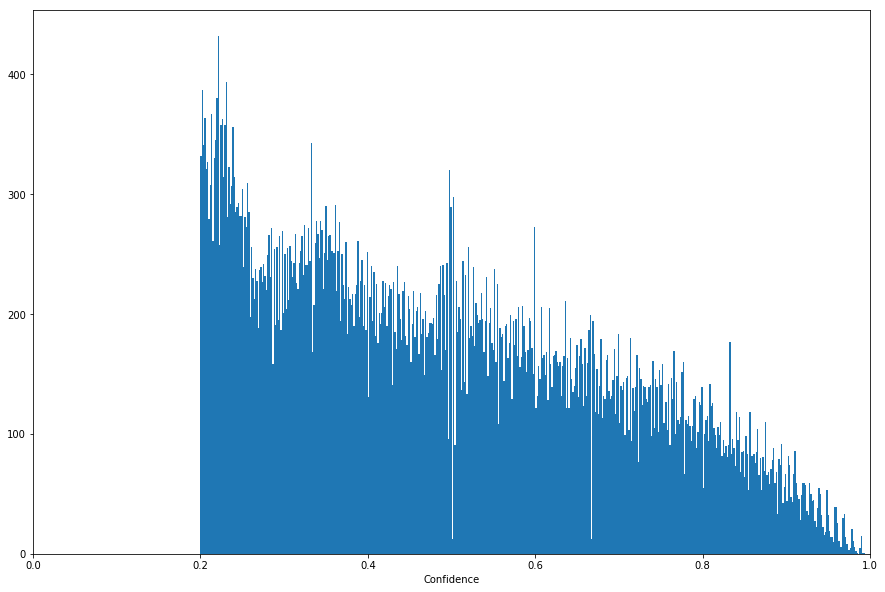

In [220]:
plt.hist(conf[np.where(support>0.001)],bins=500)
plt.xlim(0,1)
plt.xlabel("Confidence")
plt.show()

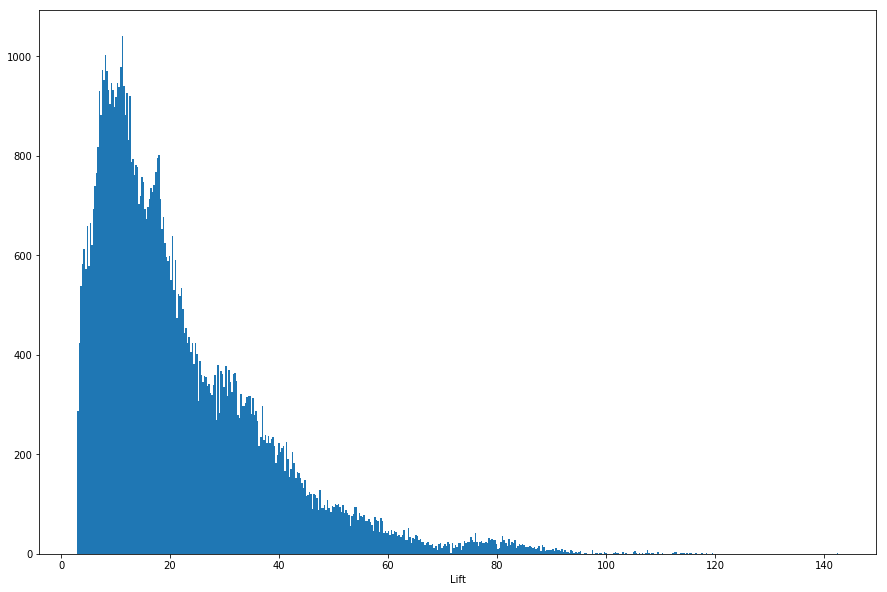

In [219]:
plt.hist(lift[np.where(support>0.001)],bins=500)
#plt.xlim(0,1)
plt.xlabel("Lift")
plt.show()

In [9]:
# Find all subsets
'''
def helper(final_ls,cur_ls,item_ls,i):
    if i == len(item_ls):
        final_ls.append(cp.deepcopy(cur_ls))
    else:
        cur_ls.append(item_ls[i])
        helper(final_ls,cur_ls,item_ls,i+1)
        cur_ls.pop()
        helper(final_ls,cur_ls,item_ls,i+1)

def itemset():
    final_ls_all =[]
    cnt = 0
    for item_ls in inv_item_dic.values():
        #print (item_ls)
        print (len(item_ls))
        cnt += 1
        final_ls = []
        cur_ls = []    
        helper(final_ls,cur_ls,item_ls,0)
        final_ls_all.append(final_ls)
        #print(final_ls)
        print("Complete:", cnt)
    return final_ls_all
'''